In [1]:
import os
import shutil
import glob
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

import re

import numpy as np
import math

plt.rcParams["font.size"] = 25
plt.rcParams['font.sans-serif'] = ['Arial']

#pd.options.mode.copy_on_write = True

# Function to convert oxide names to LaTeX format
def to_latex(oxide):
    return oxide.replace("2", "$_{2}$").replace("3", "$_{3}$").replace("5", "$_{5}$")


In [2]:
# READ DATA
folder_path = "../0_Data/2_Compiled_Data/"
folder_figure_path = "../0_Data/3_Figure/"

# Read Excel files
Mafic_compiled_data_XRF = pd.read_excel(folder_path + "Mafic_compiled_data_XRF_LOI.xlsx")
Pelitic_compiled_data_XRF = pd.read_excel(folder_path + "Pelitic_compiled_data_XRF_LOI.xlsx")

Mafic_compiled_data_Mode = pd.read_excel(folder_path + "Mafic_compiled_data_Mode.xlsx")
Pelitic_compiled_data_Mode = pd.read_excel(folder_path + "Pelitic_compiled_data_Mode.xlsx")

Mafic_compiled_data_Param = pd.read_excel(folder_path + "Mafic_compiled_data_Param.xlsx")
Pelitic_compiled_data_Param = pd.read_excel(folder_path + "Pelitic_compiled_data_Param.xlsx")


# 1. Bulk chemical composition

In [3]:
# Mafic_compiled_data_XRF.oxides.unique()
list_oxides = ["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO", "MgO", "CaO", "Na2O", "K2O", 'P2O5']
colors = sns.color_palette("bright", len(list_oxides)+1)

color_oxides = {
    "SiO2": colors[0],
    "TiO2": colors[1],
    "Al2O3": colors[2],
    "Fe2O3": colors[3],
    "MnO": colors[4],
    "MgO": colors[5],
    "CaO": colors[6],
    "Na2O": colors[7],
    "K2O": colors[8],
    "P2O5": colors[9],
    "LOI": colors[10],
}

val_list = [100, 30, 15, 10, 5, 2, 1]

num_col = 5
col_oxides1 = list_oxides[:num_col]
col_oxides2 = list_oxides[num_col:]
col_LOI = ["LOI"]
col_list = [col_oxides1, col_oxides2, col_LOI]


In [4]:
print(Mafic_compiled_data_XRF["oxides"].unique())


['Na2O' 'MgO' 'Al2O3' 'SiO2' 'P2O5' 'K2O' 'CaO' 'TiO2' 'MnO' 'Fe2O3' 'LOI']


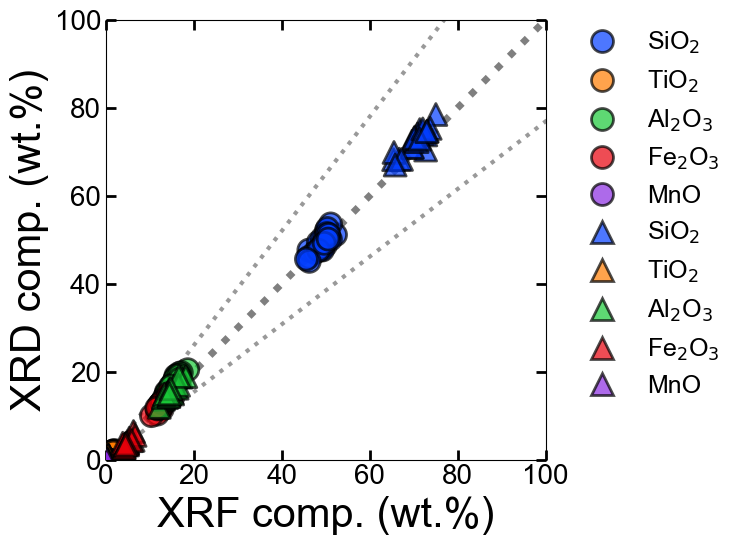

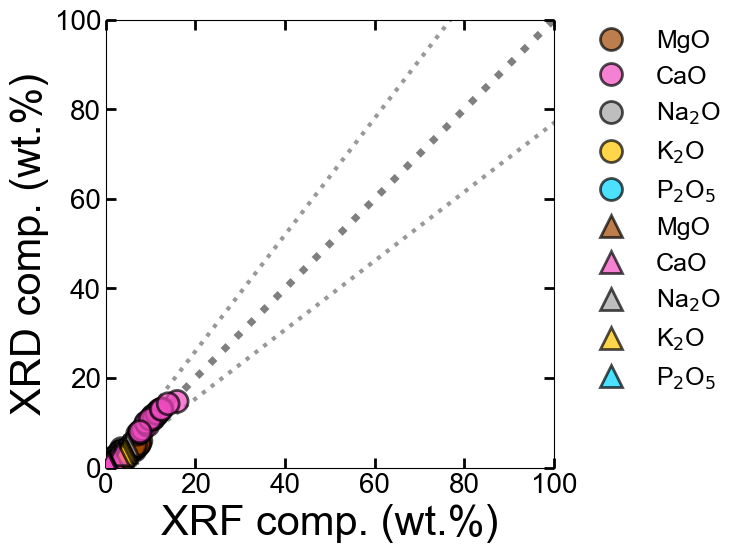

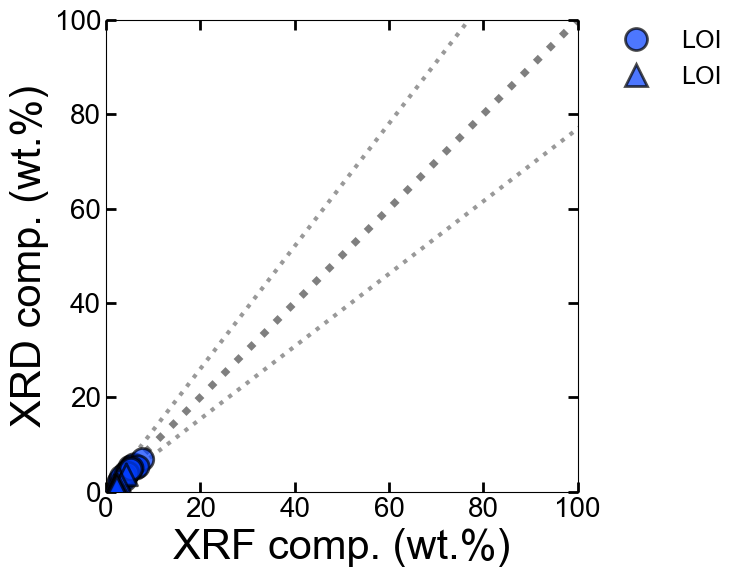

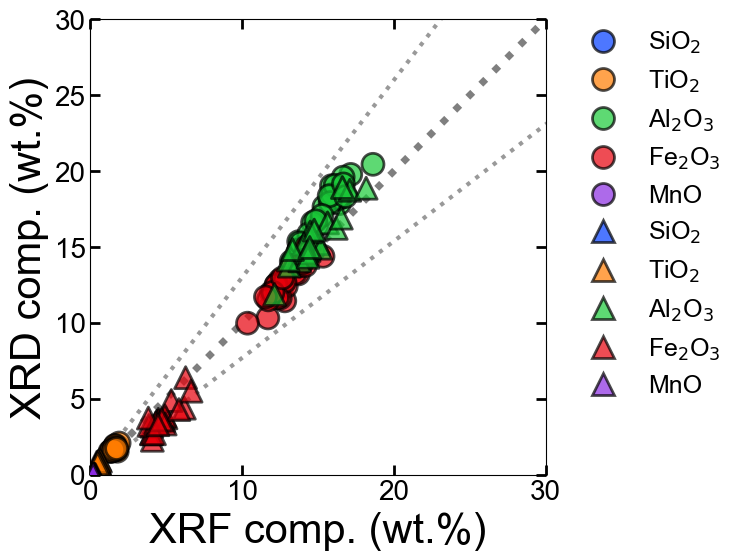

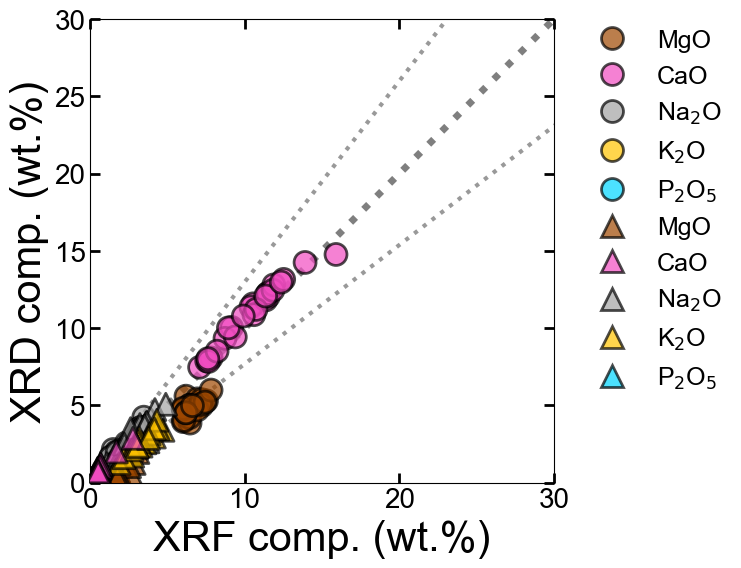

...

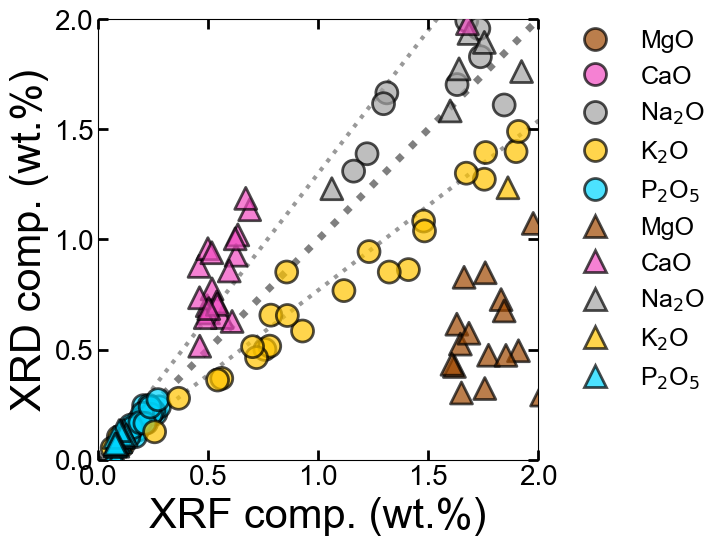

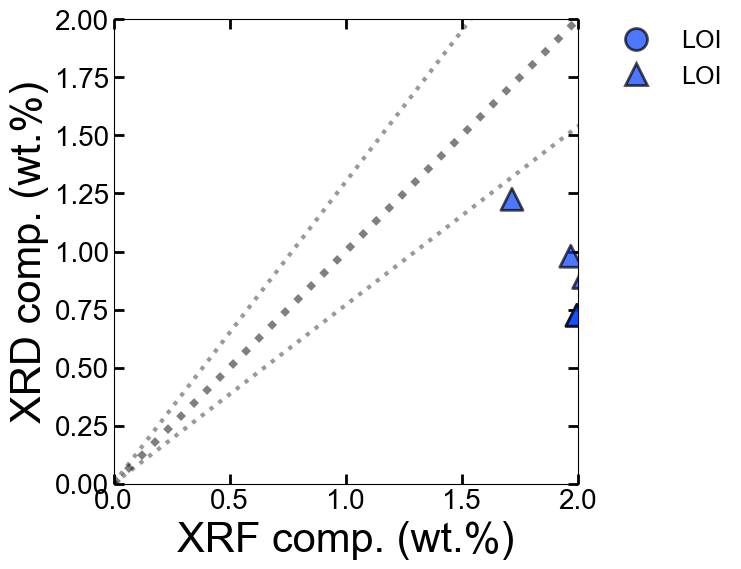

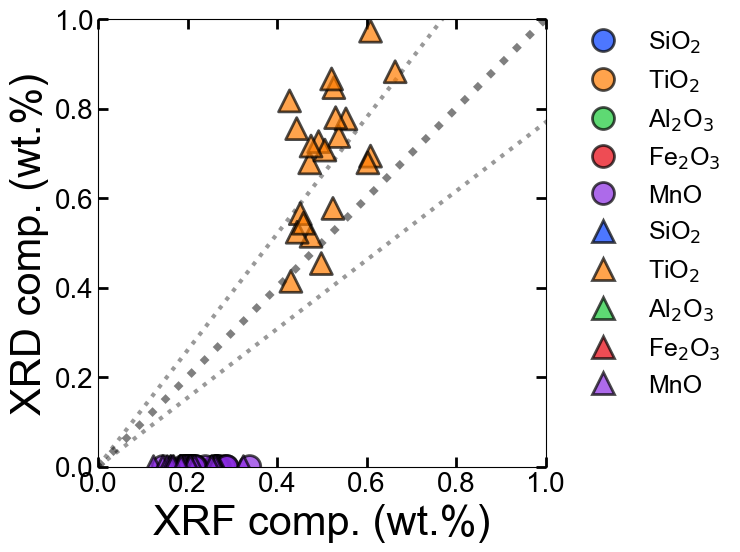

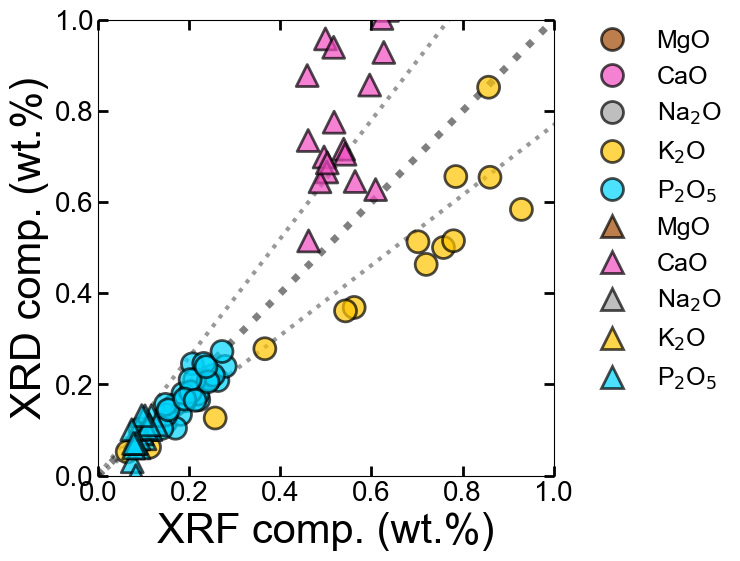

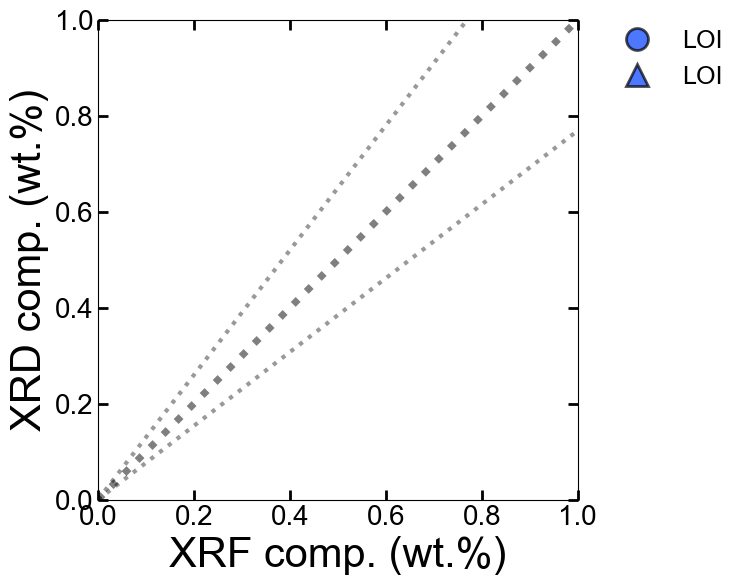

In [5]:
x = 'XRF comp.'
y = "XRD comp."
y_SP8 = 'SP8-XRD comp.'
y_LAB = 'LAB-XRD comp.'
data_list = [Mafic_compiled_data_XRF.copy(), Pelitic_compiled_data_XRF.copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_XRF.copy()]

# プロットを作成するリスト
for val in val_list:
    for i, col in enumerate(col_list):
        
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
        for data, symbol in zip(data_list, symbol_list):
            filtered_data = data[data['oxides'].isin(col)]

            sns.scatterplot(data=filtered_data, x=x, y=y_SP8, hue="oxides", hue_order=col, marker=symbol, 
                palette=color_oxides, edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)

        # label 
        handles, labels = ax.get_legend_handles_labels()
        labels = [to_latex(label) for label in labels]
        ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)

        # Setting
        plt.xlabel(x + " (wt.%)", fontsize=30)
        plt.ylabel(y + " (wt.%)", fontsize=30)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRDvsXRF/ALL_{val}_{i}_{y_SP8}.pdf', bbox_inches='tight')
        plt.show()


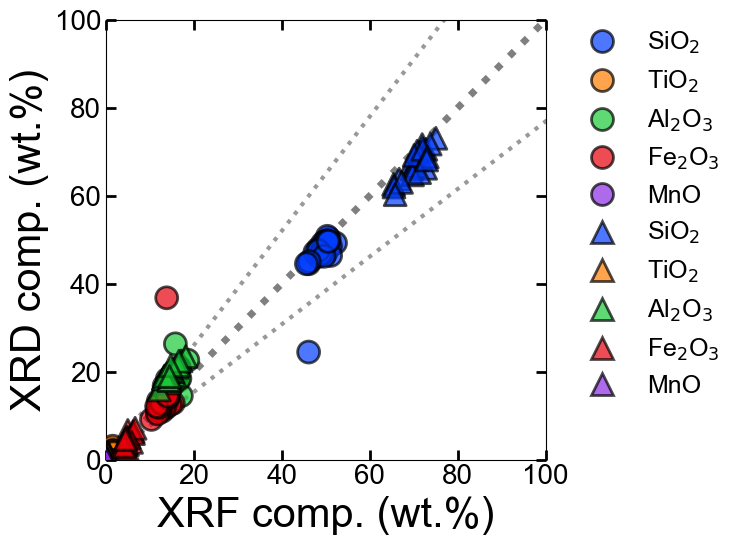

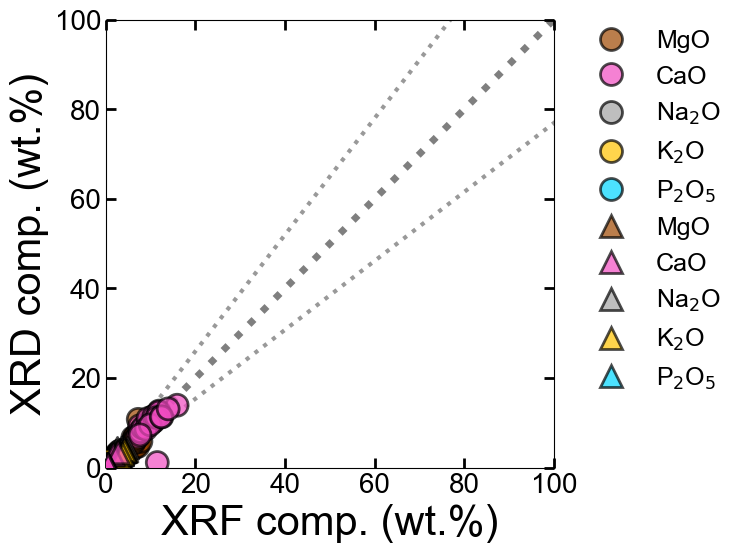

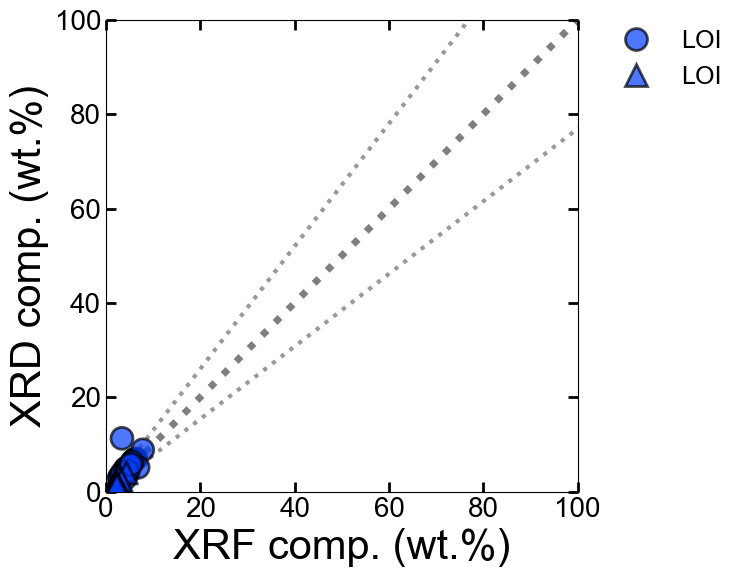

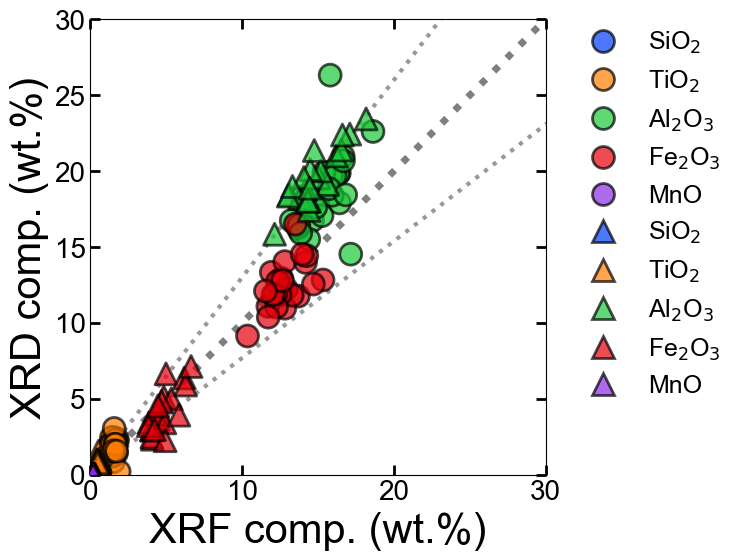

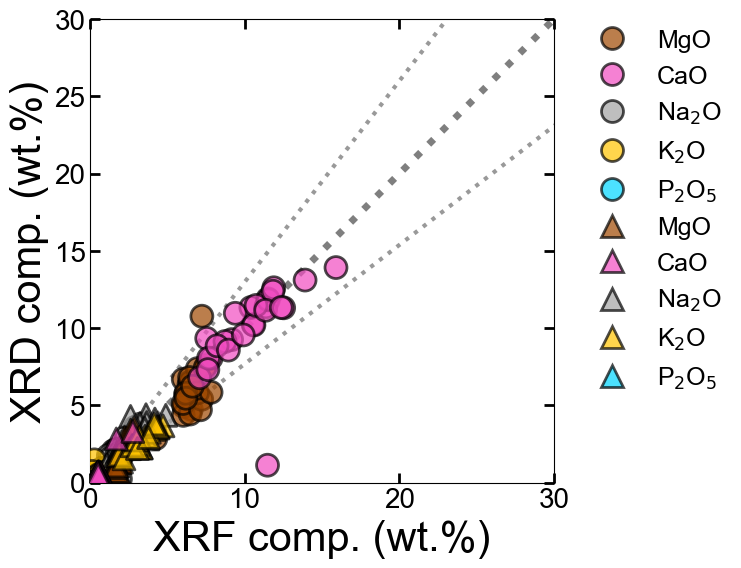

...

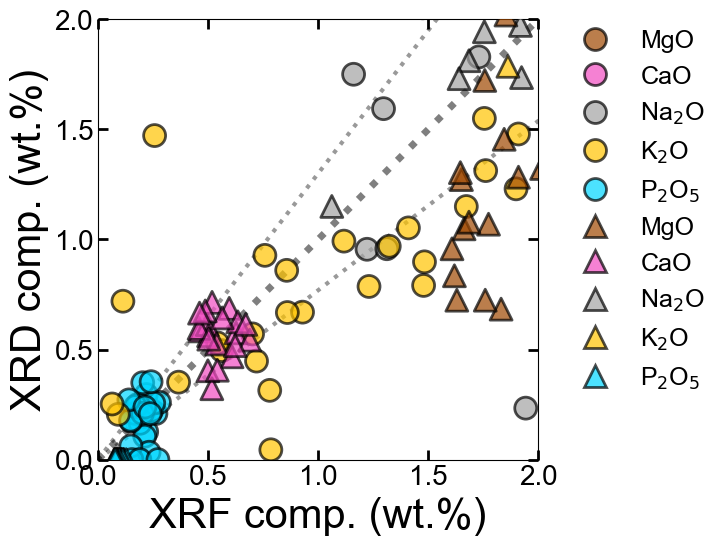

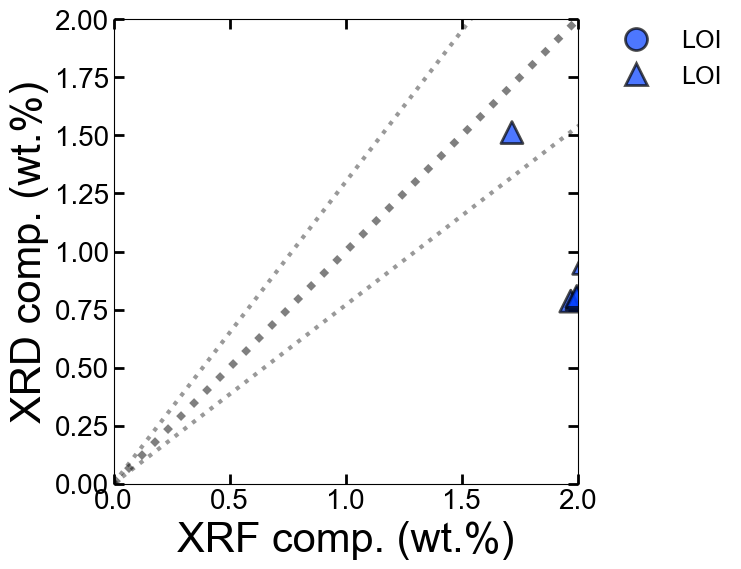

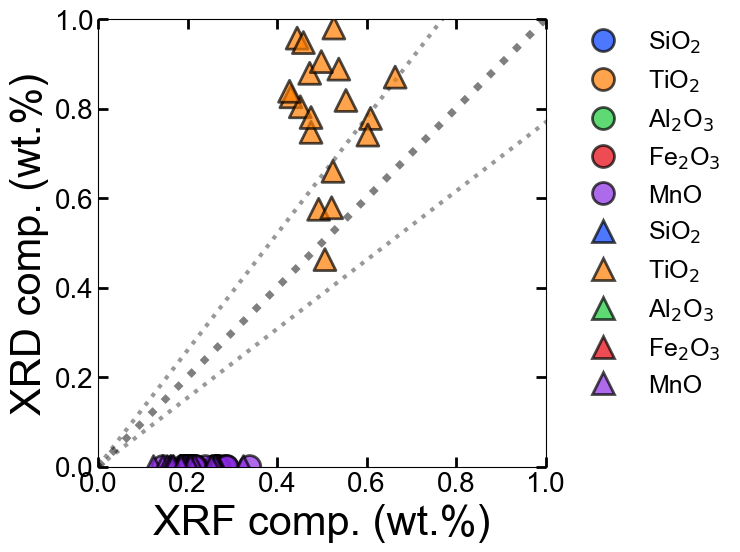

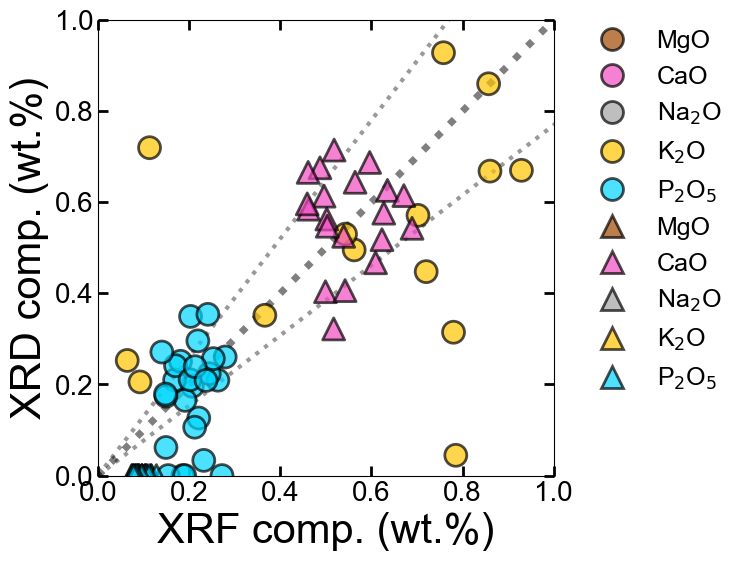

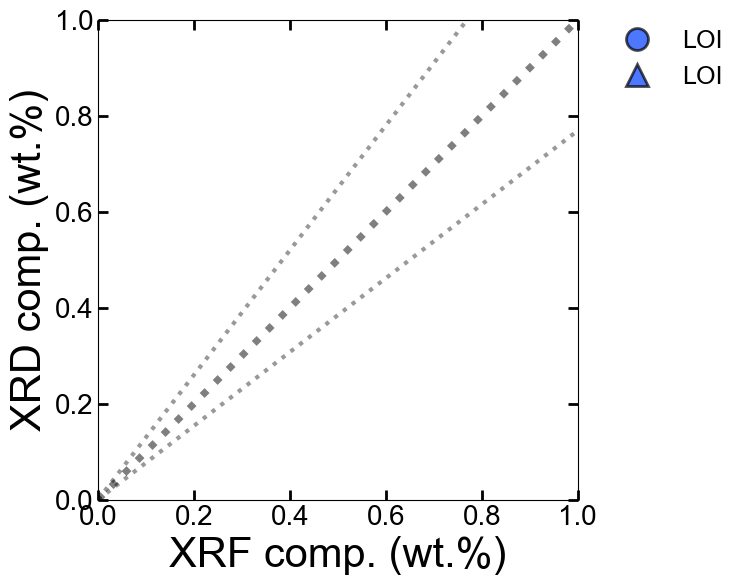

In [6]:
x = 'XRF comp.'
y = "XRD comp."
y_SP8 = 'SP8-XRD comp.'
y_LAB = 'LAB-XRD comp.'
data_list = [Mafic_compiled_data_XRF.copy(), Pelitic_compiled_data_XRF.copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_XRF.copy()]

for val in val_list:
    for i, col in enumerate(col_list):
        
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
        for data, symbol in zip(data_list, symbol_list):
            filtered_data = data[data['oxides'].isin(col)]

            sns.scatterplot(data=filtered_data, x=x, y=y_LAB, hue="oxides", hue_order=col, marker=symbol, 
                    palette=color_oxides, edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)
        
        # label 
        handles, labels = ax.get_legend_handles_labels()
        labels = [to_latex(label) for label in labels]
        ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
        
        # Setting
        plt.xlabel(x + " (wt.%)", fontsize=30)
        plt.ylabel(y + " (wt.%)", fontsize=30)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRDvsXRF/ALL_{val}_{i}_{y_LAB}.pdf', bbox_inches='tight')
        plt.show()


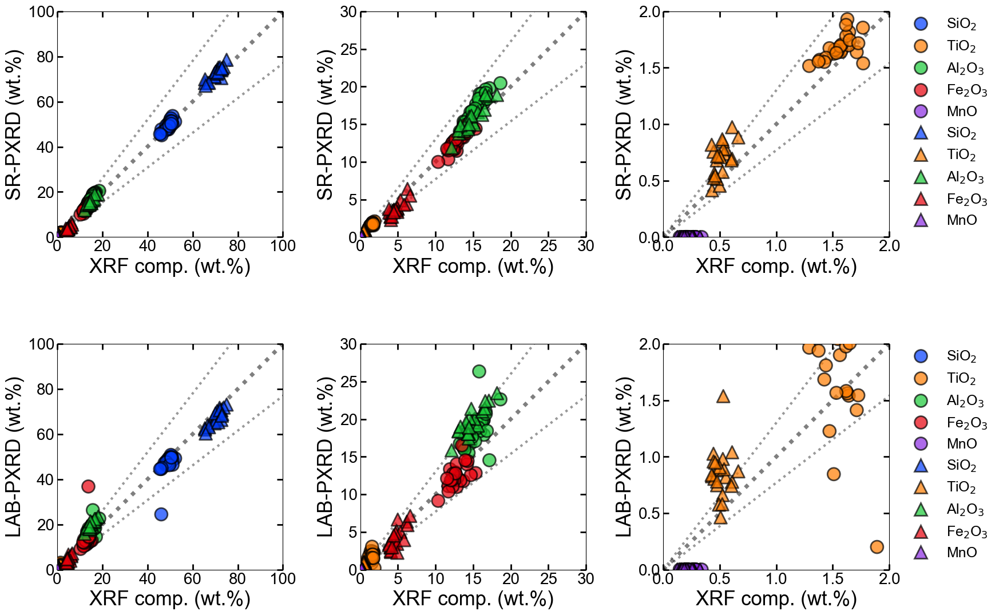

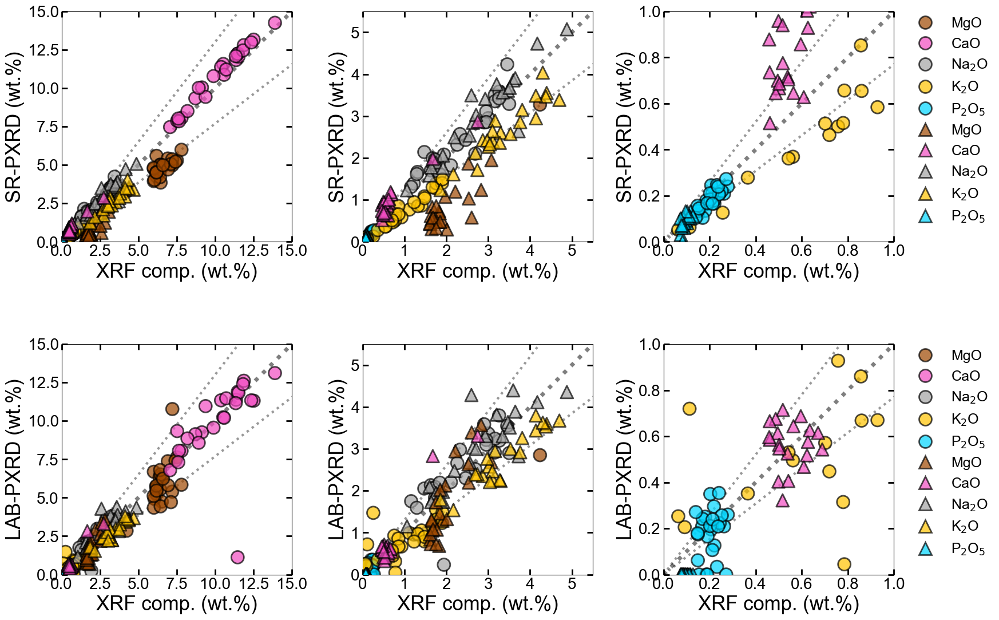

In [7]:
val_list_compile = [[100, 30, 2], [15, 5.5, 1]]
list_oxides_compile = [["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO"], ["MgO", "CaO", "Na2O", "K2O", 'P2O5']]
y_list = ['SP8-XRD comp.', 'LAB-XRD comp.']

################################## ALL Combined
x = 'XRF comp.'
y = "XRD comp."
y_SP8 = 'SP8-XRD comp.'
y_LAB = 'LAB-XRD comp.'

data_list = [Mafic_compiled_data_XRF.copy(), Pelitic_compiled_data_XRF.copy()]
symbol_list = ["o", "^"]

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            ax = axs[t, i]  # Corrected indexing
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, 
                                palette=color_oxides, edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            # label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
            
            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            if y == "SP8-XRD comp.":
                ax.set_ylabel("SR-PXRD (wt.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)
                
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
  
    # Adjust subplot spacing
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + 'XRDvsXRF/ALL_combined_plot_SP8_'+str(num)+'.pdf', bbox_inches='tight')
    plt.show()


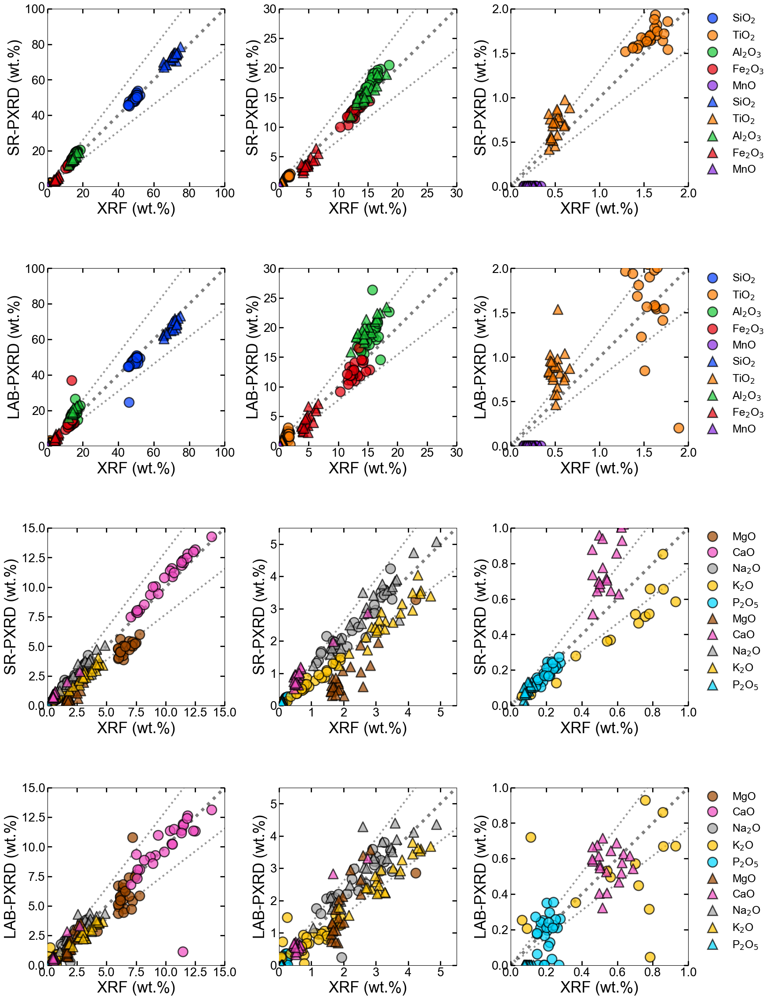

In [8]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(list_oxides_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))
axs = np.array(axs).reshape(total_rows, total_cols)

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, 
                                palette=color_oxides, edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
            
            # Setting labels and styles
            ax.set_xlabel("XRF (wt.%)", fontsize=25)
            if y == "SP8-XRD comp.":
                ax.set_ylabel("SR-PXRD (wt.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)

            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
#plt.savefig(folder_figure_path + 'XRDvsXRF/ALL_combined_plot_SP8.pdf', bbox_inches='tight')
plt.show()


# 1.5 Volume*Mineral comp → Bulk Composition

In [9]:
df_volume_XRF_melt_compile = pd.read_excel(folder_path + "df_volume_mineral_comp_>bulk_comp_melt.xlsx", index_col=0, header=0)
df_volume_XRF_melt_compile = df_volume_XRF_melt_compile.rename(columns={"variable": "oxides"})


Mafic_INDEX = [ 46,  47,  48,  49,  50,  51,  63,  64,  65,  66,  67,  68, 104,
       105, 106, 112, 118, 119, 121, 122, 123, 124, 138, 139, 140, 141]

Pelitic_INDEX = [ 45,  78,  93,  94,  95,  96,  97,  98,  99, 107, 108, 109, 110,
       111, 113, 114, 135, 136, 144, 145, 146, 147]


val_list = [100, 30, 15, 10, 5, 2, 1]
num_col = 5
col_oxides1 = list_oxides[:num_col]
col_oxides2 = list_oxides[num_col:]
col_list = [col_oxides1, col_oxides2]


In [10]:
df_volume_XRF_melt_compile


,INDEX,oxides,XRF,XRD_SP8,XRD_LAB
0,45,Al2O3,14.445,13.378009,14.744271
1,45,CaO,0.462,0.546625,0.610092
2,45,Fe2O3,4.032,2.875031,3.151708
3,45,K2O,2.872,2.536056,3.079689
4,45,MgO,1.663,1.358135,1.551906
...,...,...,...,...,...
475,147,MnO,0.186,0.107171,0.195068
476,147,Na2O,2.195,2.538700,2.517079
477,147,P2O5,0.078,0.089516,0.020218
478,147,SiO2,72.970,76.214899,70.068467


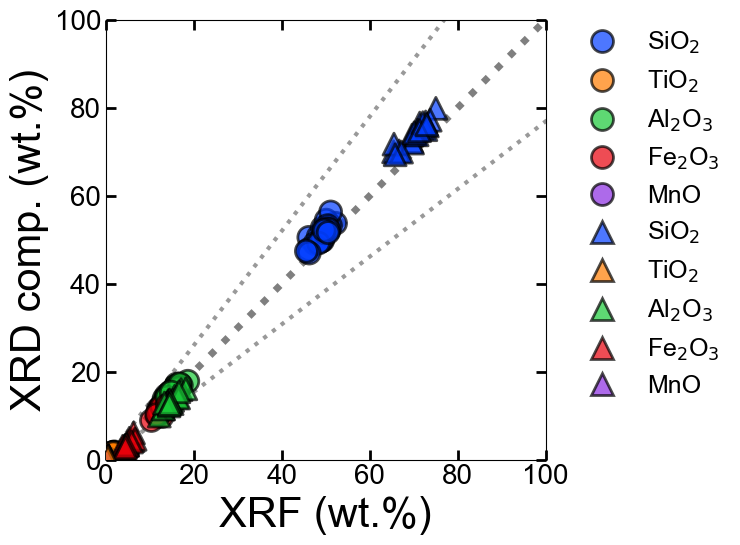

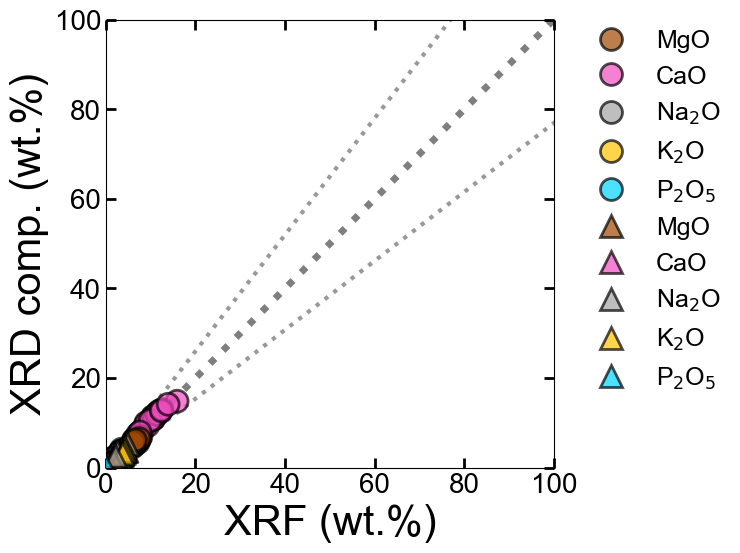

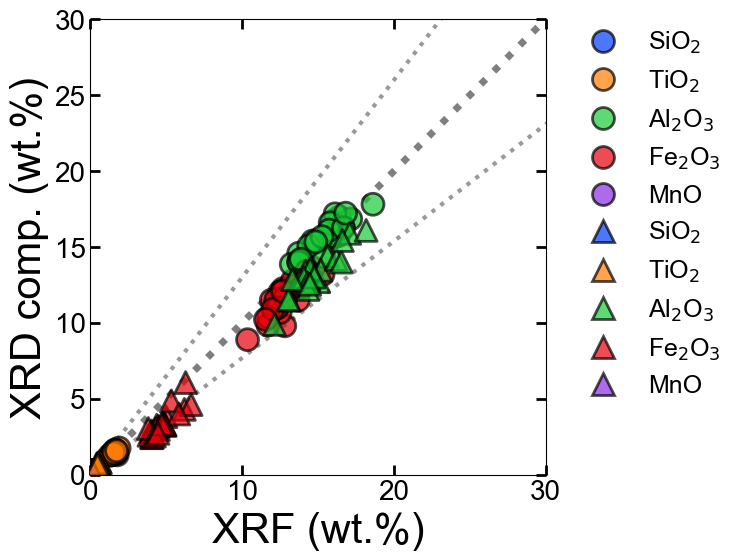

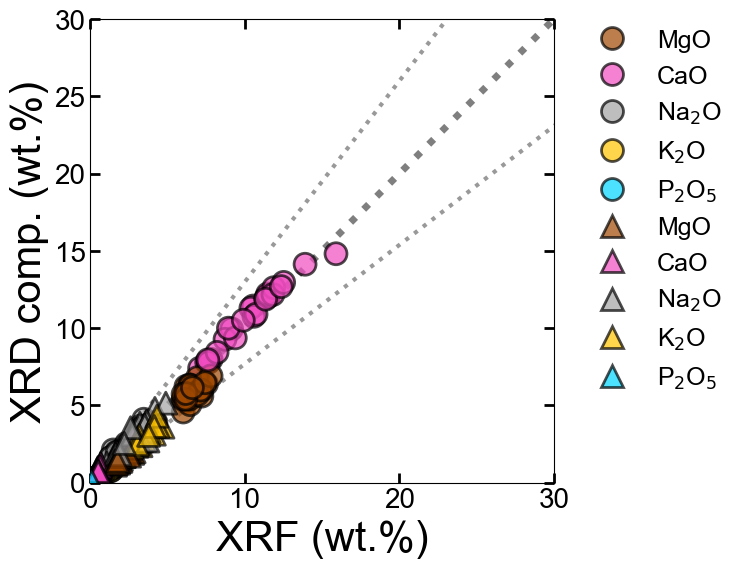

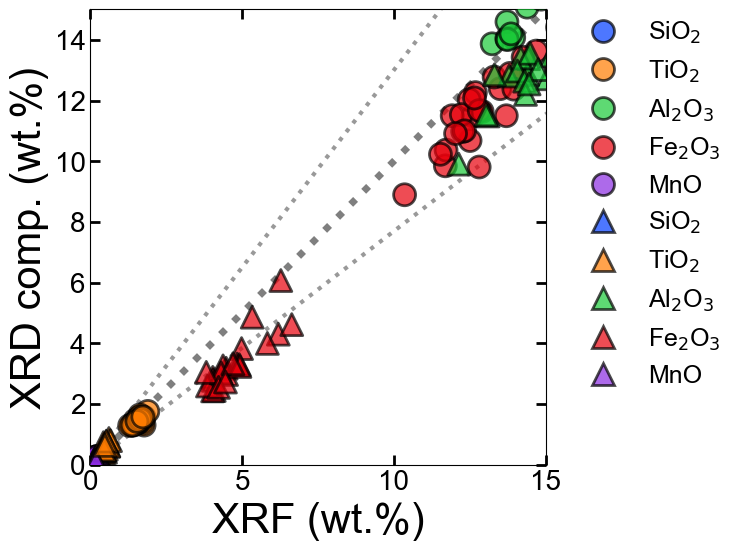

...

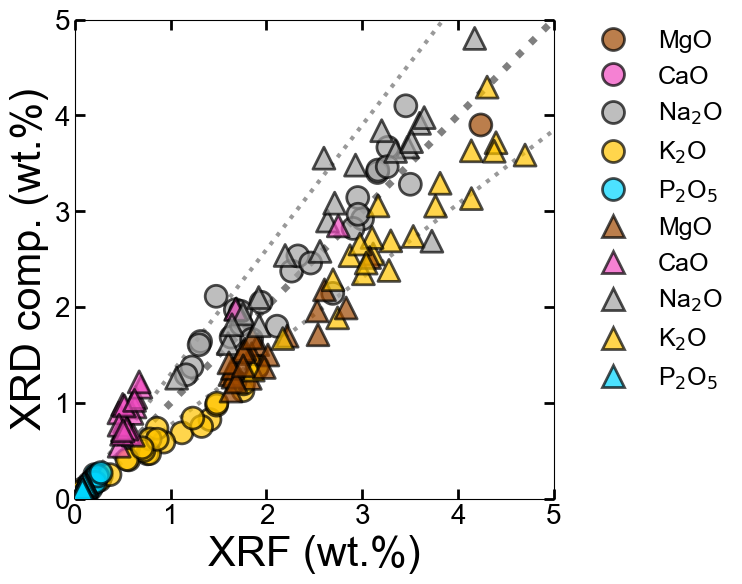

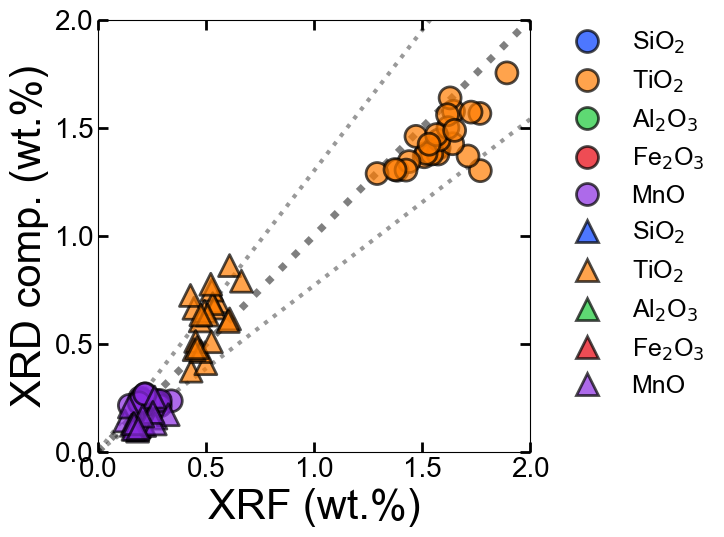

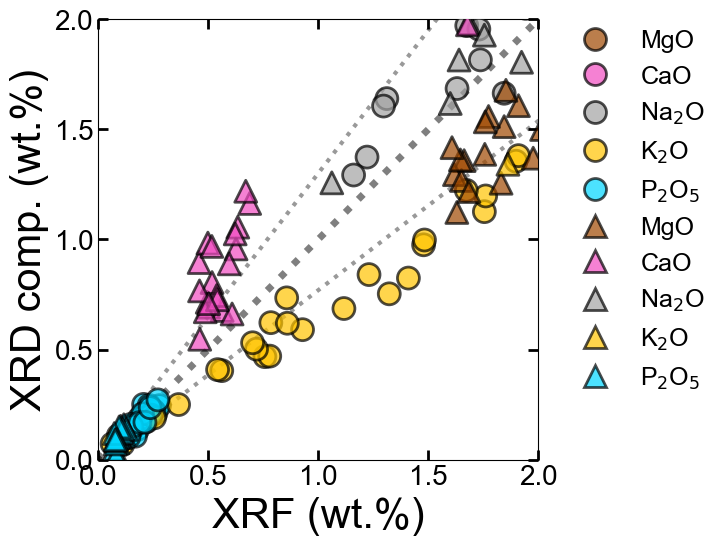

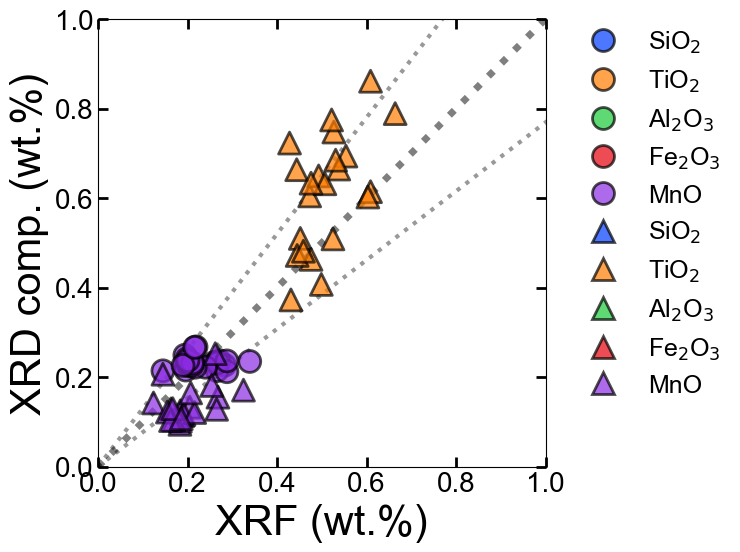

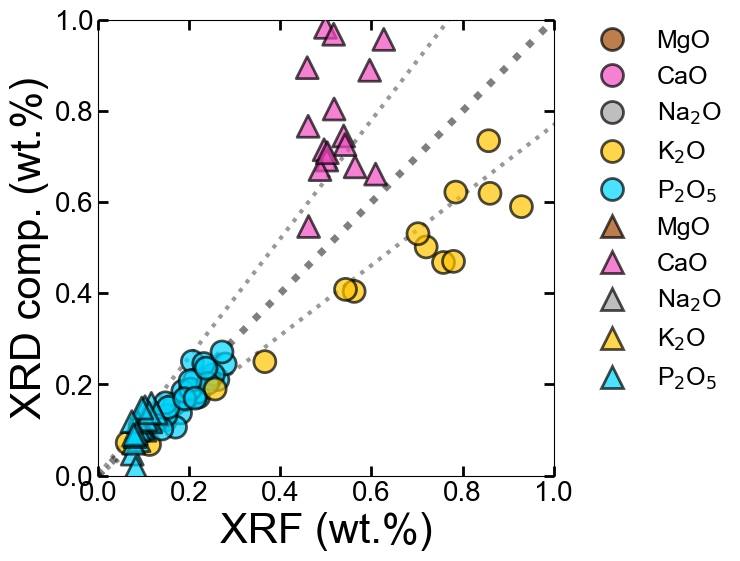

In [11]:
x = 'XRF'
y = "XRD comp."
y_SP8 = 'XRD_SP8'
y_LAB = 'XRD_LAB'
data_list = [df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_XRF.copy()]

# プロットを作成するリスト
for val in val_list:
    for i, col in enumerate(col_list):
        
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
        for data, symbol in zip(data_list, symbol_list):
            filtered_data = data[data['oxides'].isin(col)]
            
            sns.scatterplot(data=filtered_data, x=x, y=y_SP8, hue="oxides", hue_order=col, marker=symbol, palette=color_oxides,\
                            edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)

        # label 
        handles, labels = ax.get_legend_handles_labels()
        labels = [to_latex(label) for label in labels]
        plt.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
    
        # Setting
        plt.xlabel(x + " (wt.%)", fontsize=30)
        plt.ylabel(y + " (wt.%)", fontsize=30)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRDvsXRF_vol/ALL_{val}_{i}_{y_SP8}.pdf', bbox_inches='tight')
        plt.show()


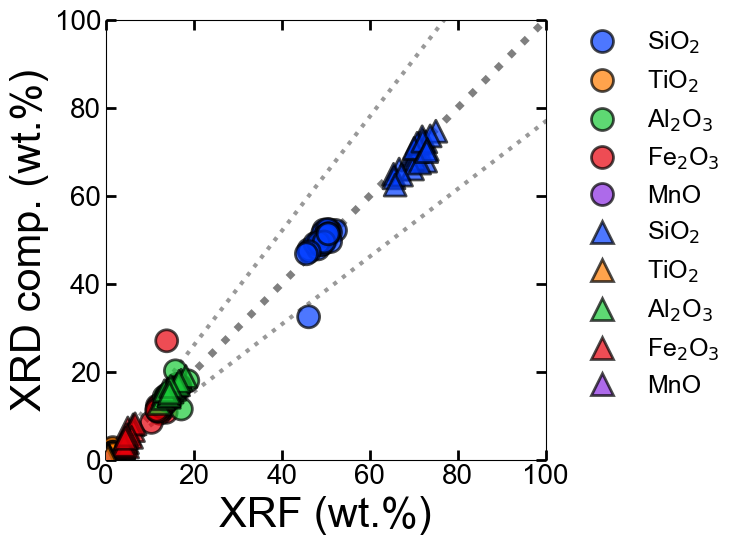

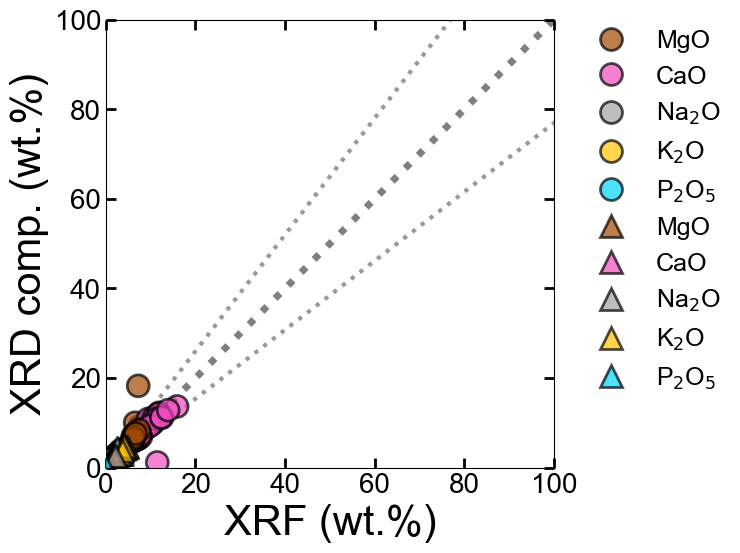

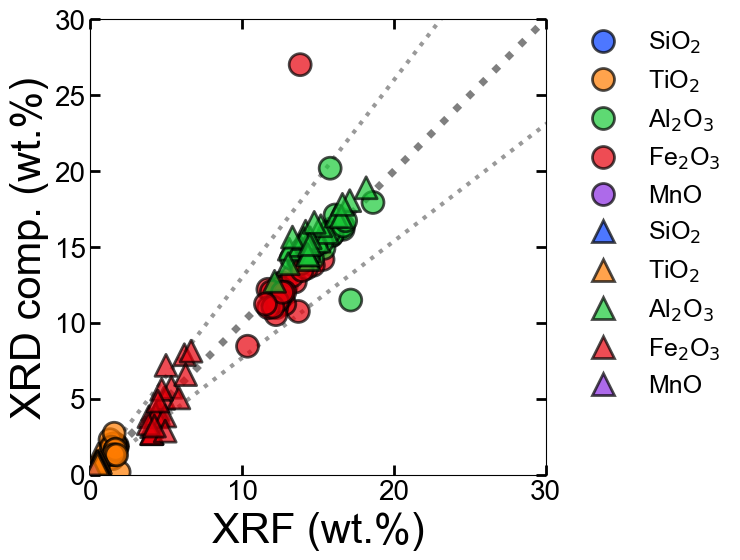

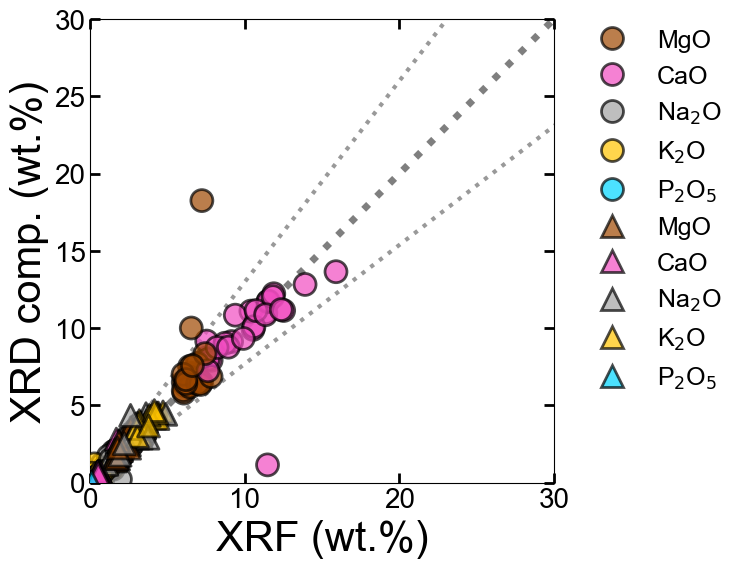

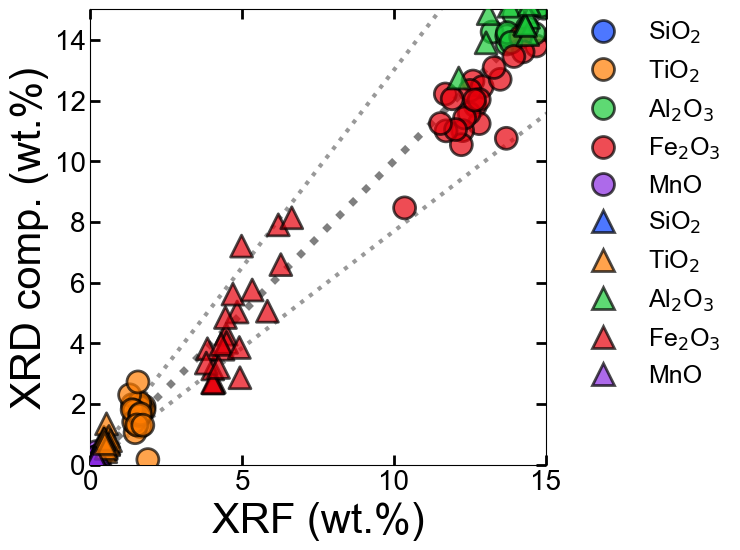

...

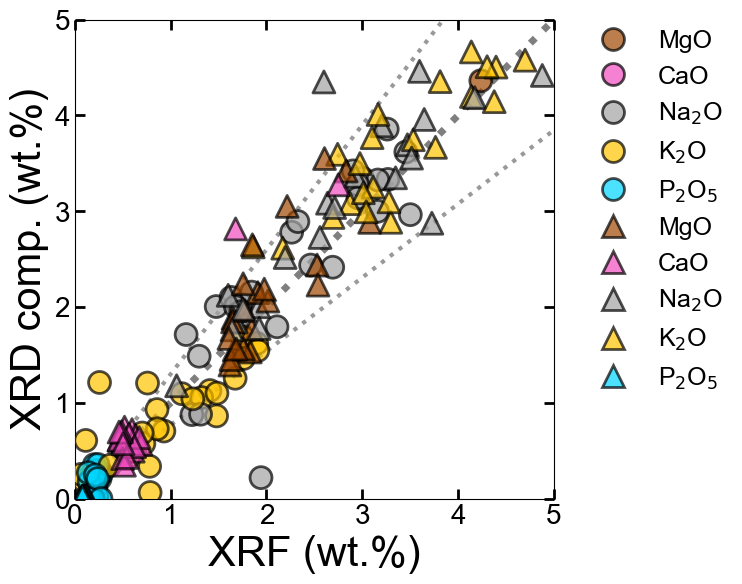

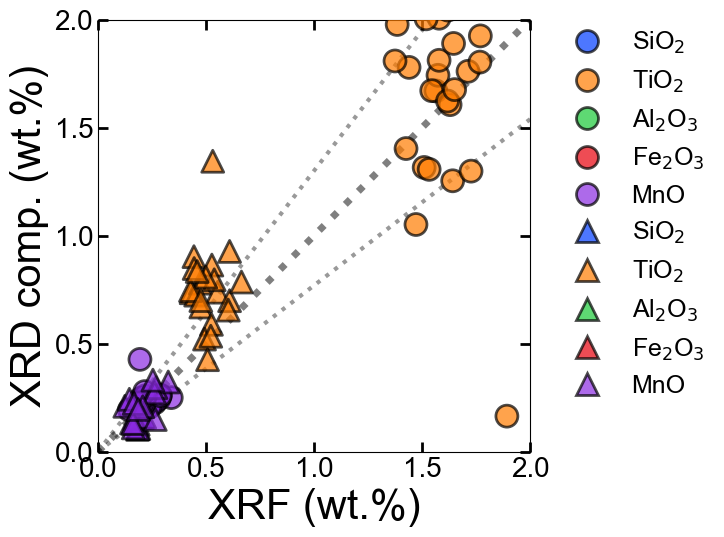

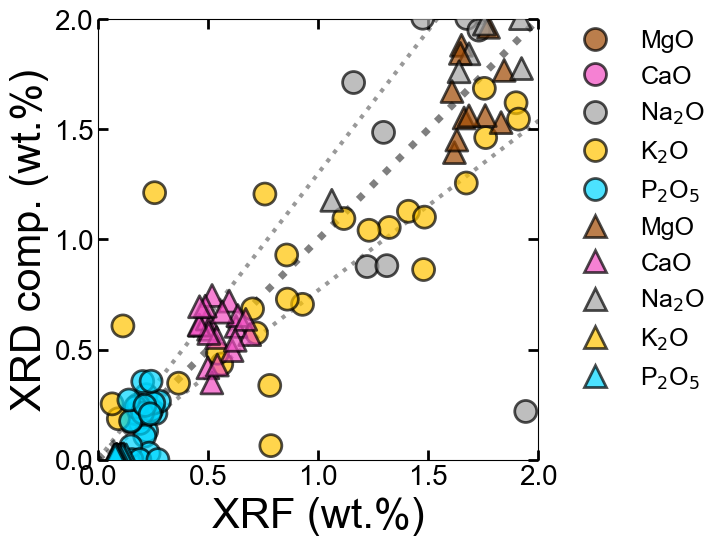

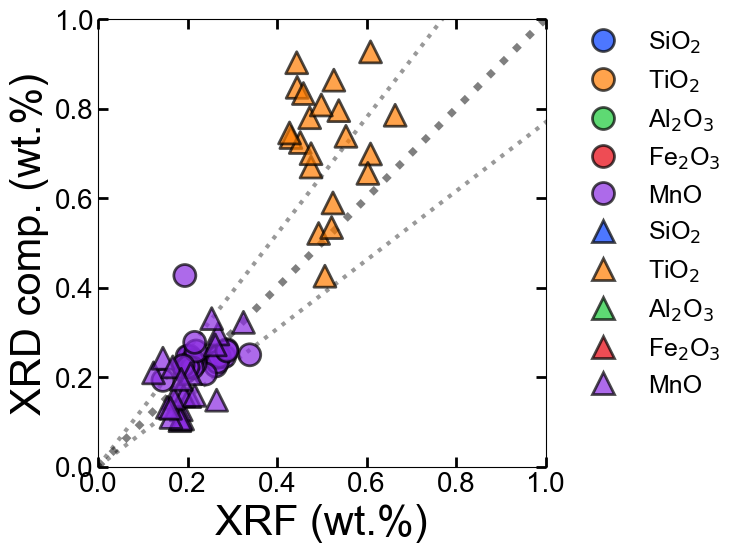

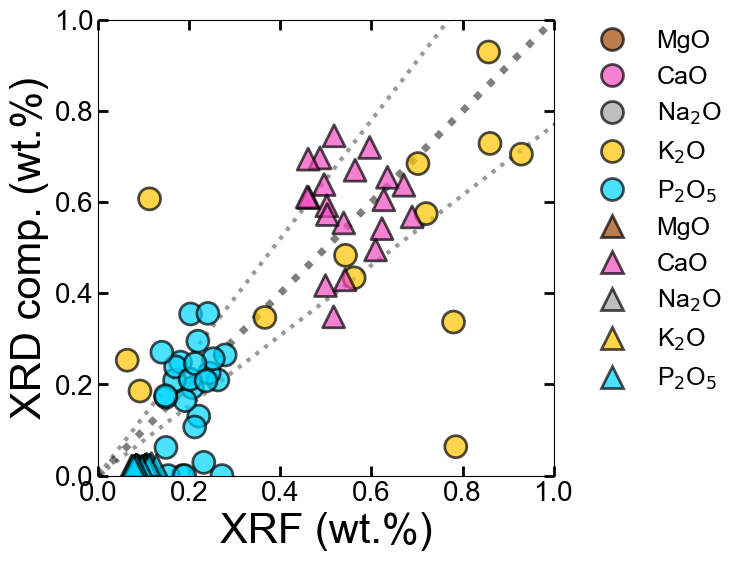

In [12]:
x = 'XRF'
y = "XRD comp."
y_SP8 = 'XRD_SP8'
y_LAB = 'XRD_LAB'
data_list = [df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_XRF.copy()]

# プロットを作成するリスト
for val in val_list:
    for i, col in enumerate(col_list):
        
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
        for data, symbol in zip(data_list, symbol_list):
            filtered_data = data[data['oxides'].isin(col)]
            
            sns.scatterplot(data=filtered_data, x=x, y=y_LAB, hue="oxides", hue_order=col, marker=symbol, palette=color_oxides,\
                            edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            #sns.scatterplot(data=filtered_data, x=x, y=y_LAB, hue="oxides", marker="^", palette='tab20',\
            #                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)

        # label 
        handles, labels = ax.get_legend_handles_labels()
        labels = [to_latex(label) for label in labels]
        ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)

        # Setting
        plt.xlabel(x + " (wt.%)", fontsize=30)
        plt.ylabel(y + " (wt.%)", fontsize=30)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRDvsXRF/ALL_{val}_{i}_{y_LAB}.pdf', bbox_inches='tight')
        plt.show()


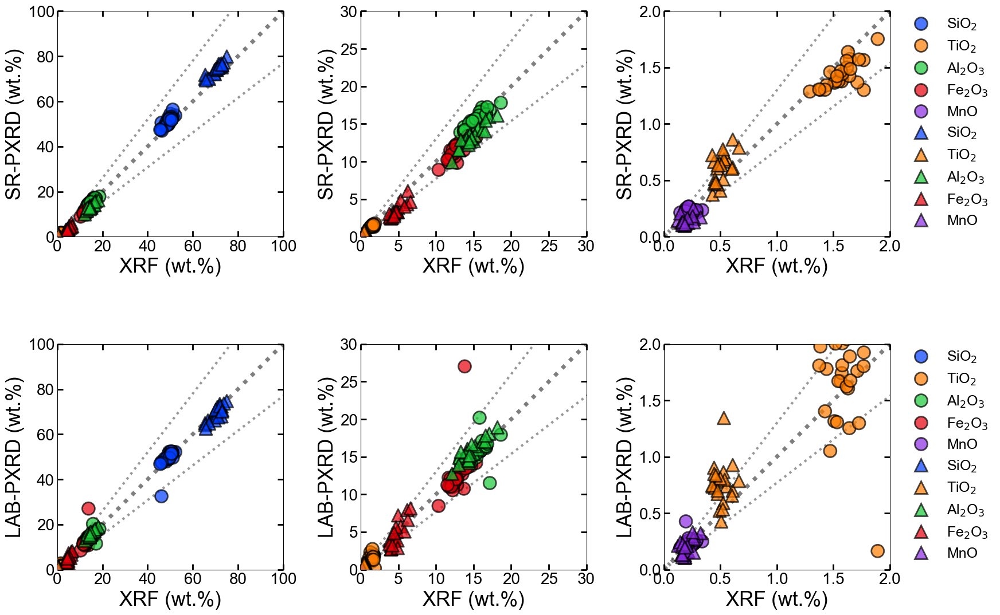

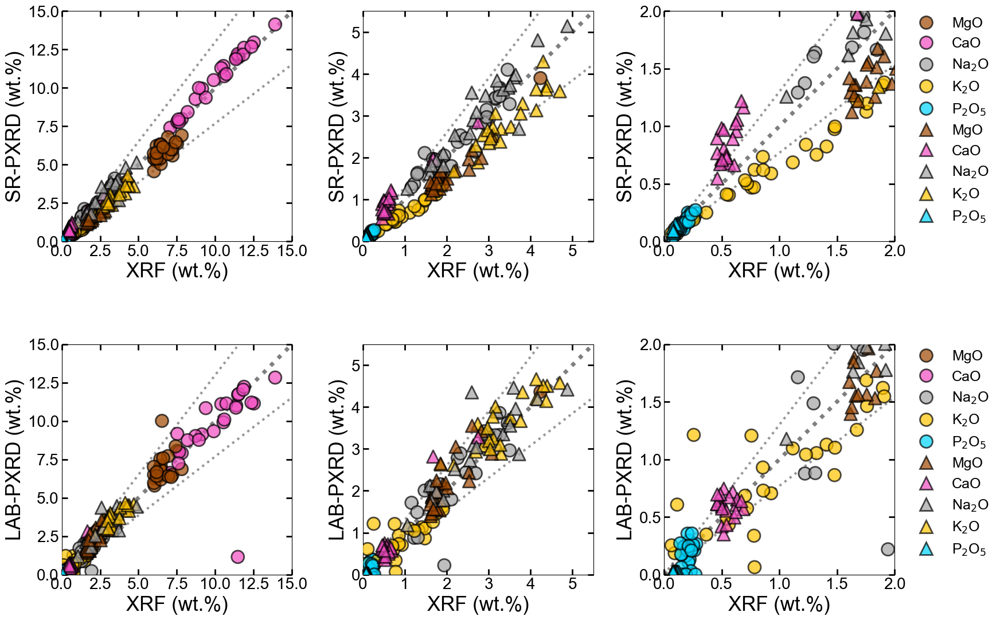

In [54]:
val_list_compile = [[100, 30, 2], [15, 5.5, 2]]
list_oxides_compile = [["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO"], ["MgO", "CaO", "Na2O", "K2O", 'P2O5']]
y_list = ['XRD_SP8', 'XRD_LAB']

################################## ALL Combined
x = 'XRF'

data_list = [df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            ax = axs[t, i]  # Corrected indexing
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, palette=color_oxides,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)


            
            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            if y == "XRD_SP8":
                ax.set_ylabel("SR-PXRD (wt.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)
                
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            # label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + 'XRDvsXRF_vol/ALL_combined_plot_SP8_'+str(num)+'.pdf', bbox_inches='tight')
    plt.show()


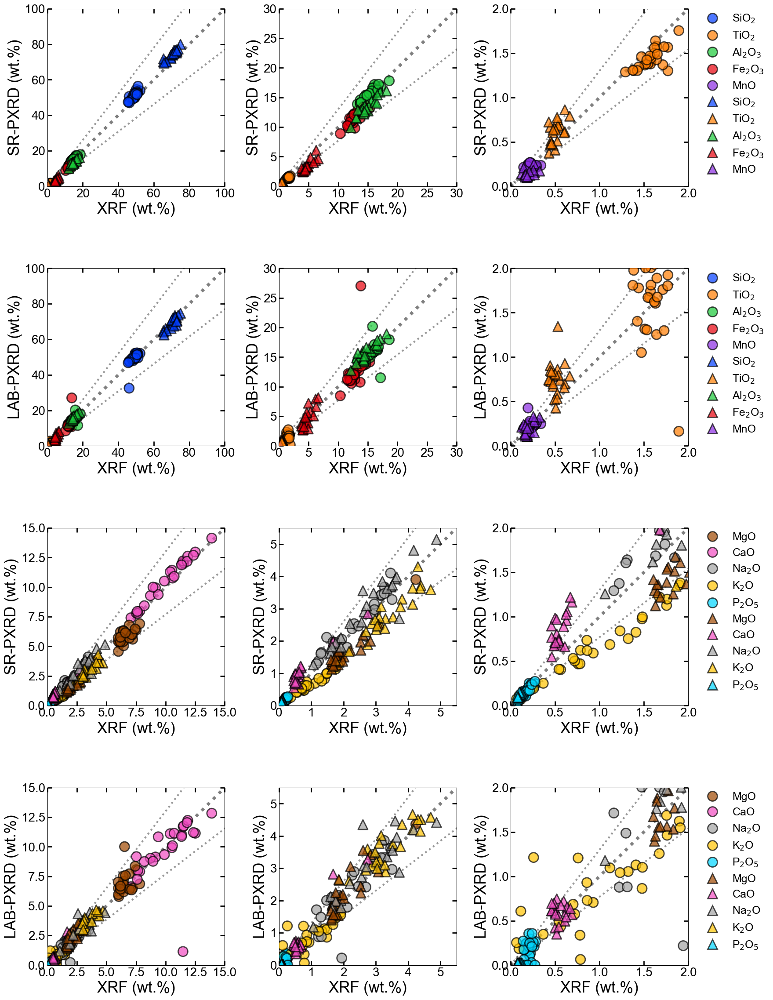

In [14]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(list_oxides_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))
axs = np.array(axs).reshape(total_rows, total_cols)

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, palette=color_oxides,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            if y == "XRD_SP8":
                ax.set_ylabel("SR-PXRD (wt.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)

            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            # Label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.savefig(folder_figure_path + 'XRDvsXRF_vol/ALL_combined_plot_SP8.pdf', bbox_inches='tight')
plt.show()


# 1.5.5 Volume*Mineral comp → Bulk Composition (Mineral density med)

In [ ]:
df_volume_XRF_melt_compile_ = pd.read_excel(folder_path + "df_volume_mineral_comp_mineral_density_med_>bulk_comp_melt.xlsx", index_col=0, header=0)
df_volume_XRF_melt_compile_ = df_volume_XRF_melt_compile_.rename(columns={"variable": "oxides"})


Mafic_INDEX = [ 46,  47,  48,  49,  50,  51,  63,  64,  65,  66,  67,  68, 104,
       105, 106, 112, 118, 119, 121, 122, 123, 124, 138, 139, 140, 141]

Pelitic_INDEX = [ 45,  78,  93,  94,  95,  96,  97,  98,  99, 107, 108, 109, 110,
       111, 113, 114, 135, 136, 144, 145, 146, 147]


val_list = [100, 30, 15, 10, 5, 2, 1]
num_col = 5
col_oxides1 = list_oxides[:num_col]
col_oxides2 = list_oxides[num_col:]
col_list = [col_oxides1, col_oxides2]

val_list_compile = [[100, 30, 2], [15, 5.5, 2]]
list_oxides_compile = [["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO"], ["MgO", "CaO", "Na2O", "K2O", 'P2O5']]
y_list = ['XRD_SP8', 'XRD_LAB']

################################## ALL Combined
x = 'XRF'

data_list = [df_volume_XRF_melt_compile_[df_volume_XRF_melt_compile_["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile_[df_volume_XRF_melt_compile_["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]


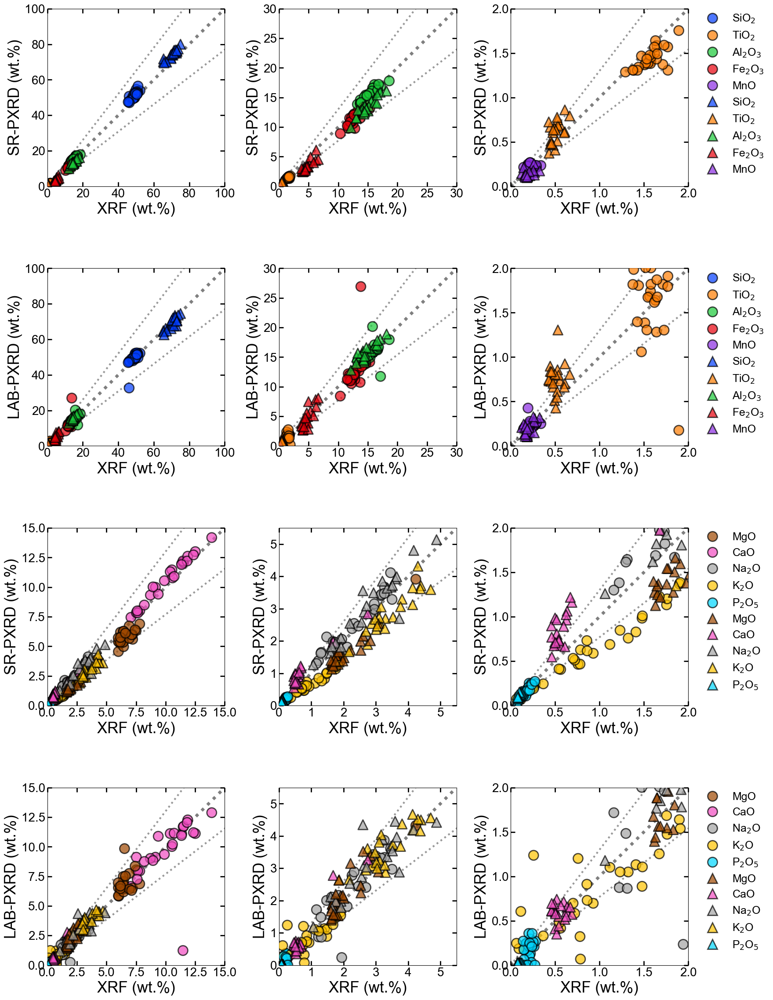

In [16]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(list_oxides_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))
axs = np.array(axs).reshape(total_rows, total_cols)

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, palette=color_oxides,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            if y == "XRD_SP8":
                ax.set_ylabel("SR-PXRD (wt.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)

            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            # Label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
# plt.savefig(folder_figure_path + 'XRDvsXRF_vol/ALL_combined_plot_SP8.pdf', bbox_inches='tight')
plt.show()


# 1.6 EPMA mode * Mineral comp → Bulk Composition

In [17]:
df_volume_XRF_melt_compile_EPMA = pd.read_excel(folder_path + "df_volume_mineral_comp_>bulk_comp_melt_EPMA.xlsx", index_col=0, header=0)
df_volume_XRF_melt_compile_EPMA = df_volume_XRF_melt_compile_EPMA.rename(columns={"variable": "oxides"})


Mafic_INDEX = [ 49,  50,  64,  139]

#Pelitic_INDEX = [78,  95, 108, 113,]
Pelitic_INDEX = [78, 93, 95, 113,]


val_list = [100, 30, 15, 10, 5, 2, 1]
num_col = 5
col_oxides1 = list_oxides[:num_col]
col_oxides2 = list_oxides[num_col:]
col_list = [col_oxides1, col_oxides2]



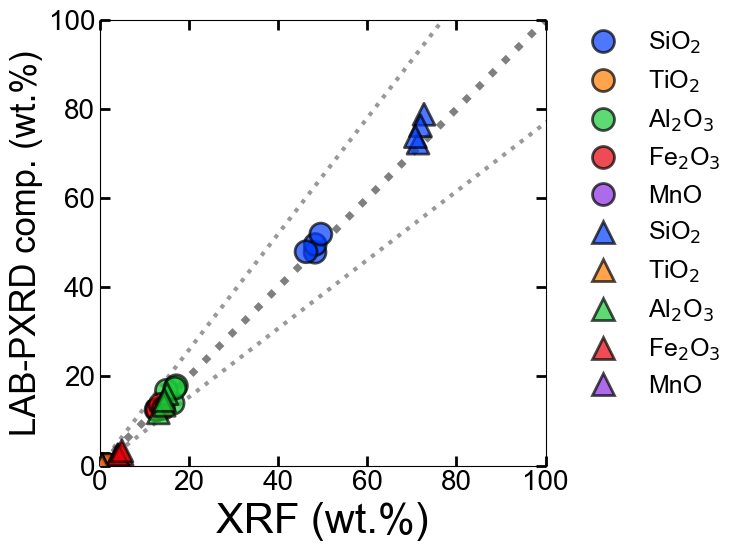

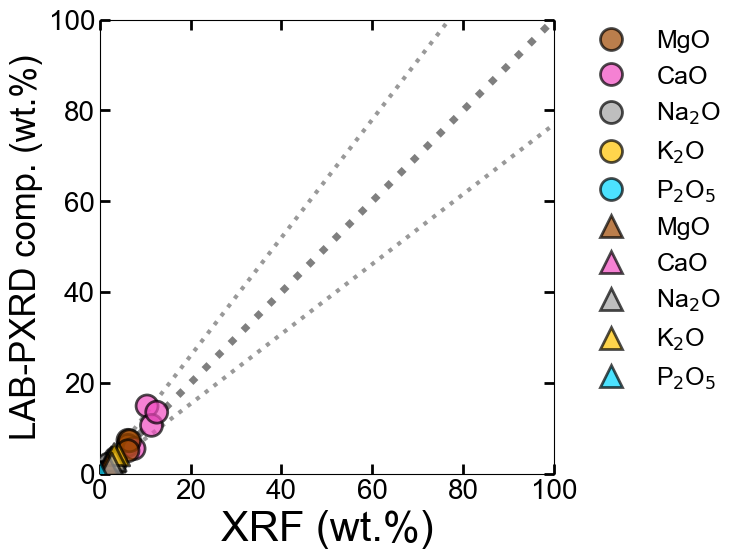

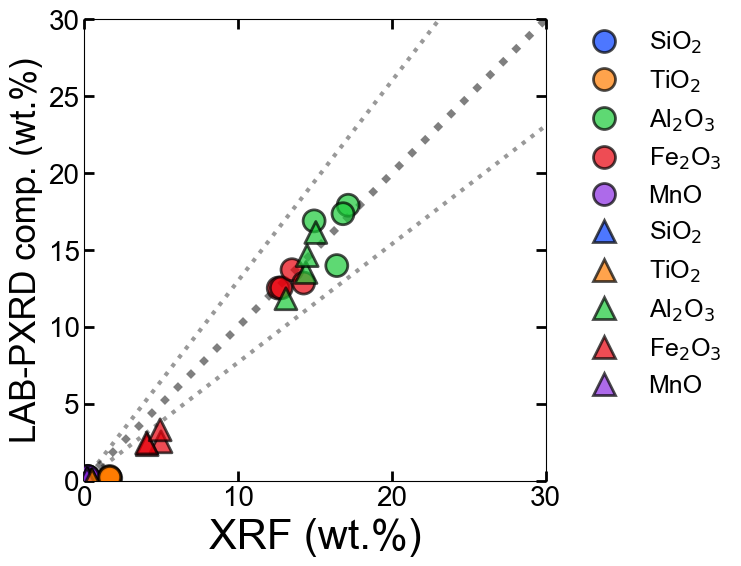

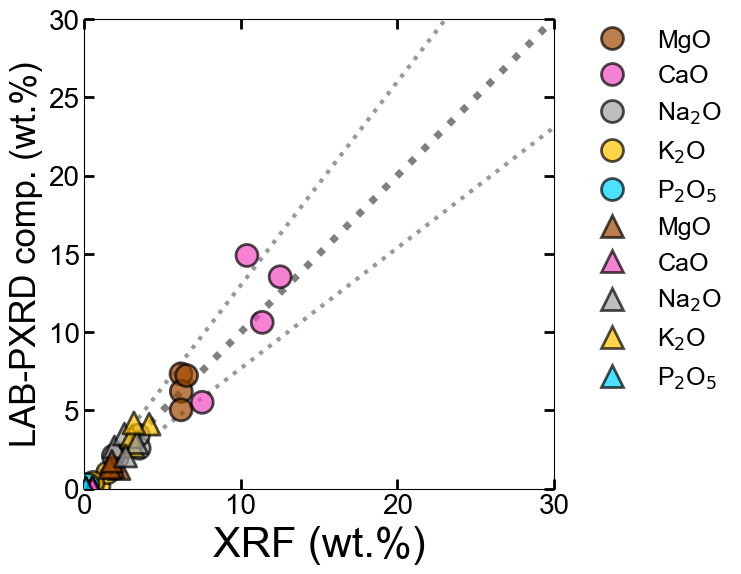

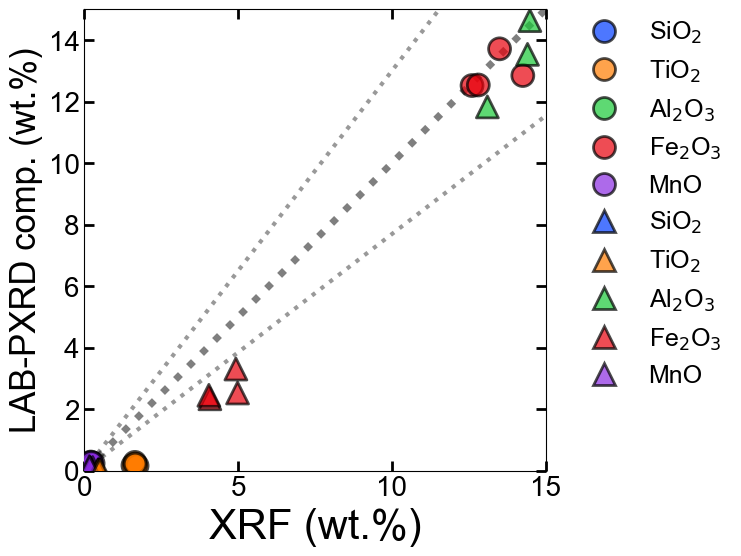

...

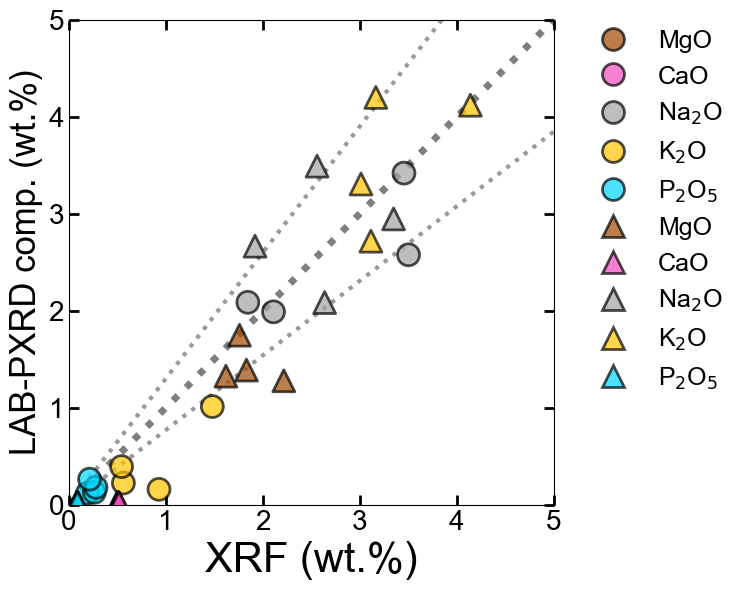

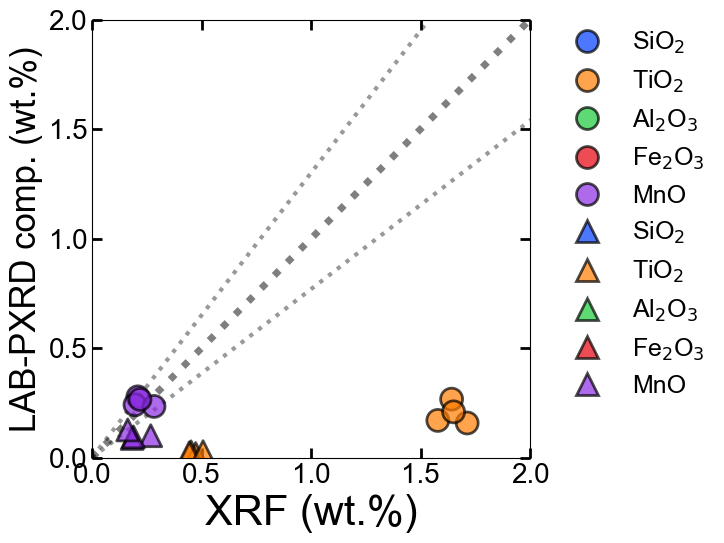

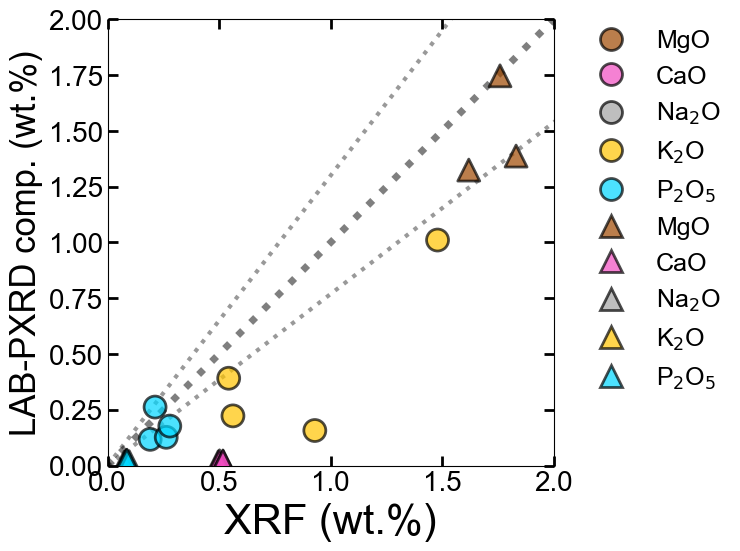

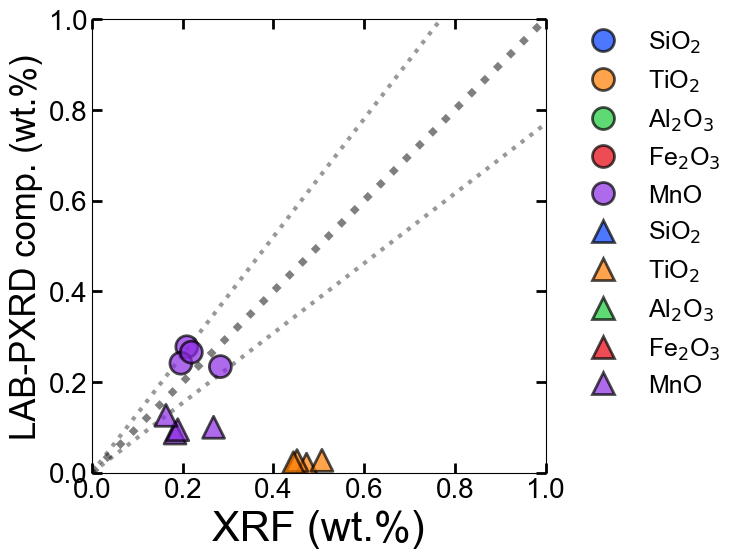

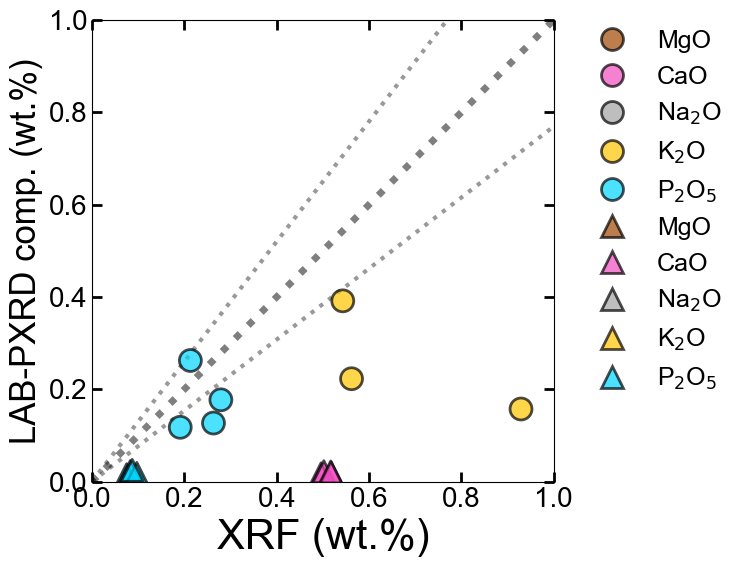

In [18]:
x = 'XRF'
y = "EPMA"
data_list = [df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_XRF.copy()]

# プロットを作成するリスト
for val in val_list:
    for i, col in enumerate(col_list):
        
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
        for data, symbol in zip(data_list, symbol_list):
            filtered_data = data[data['oxides'].isin(col)]
            
            sns.scatterplot(data=filtered_data, x=x, y=y, hue="oxides", hue_order=col, marker=symbol, palette=color_oxides,\
                            edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            #sns.scatterplot(data=filtered_data, x=x, y=y_LAB, hue="oxides", marker="^", palette='tab20',\
            #                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
            
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)
        
        # label 
        handles, labels = ax.get_legend_handles_labels()
        labels = [to_latex(label) for label in labels]
        ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
        
        # Setting
        plt.xlabel(x + " (wt.%)", fontsize=30)
        if y == "SP8-XRD comp.":
            ax.set_ylabel("SR-PXRD comp. (wt.%)", fontsize=25)
        else:
            ax.set_ylabel("LAB-PXRD comp. (wt.%)", fontsize=25)
            
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRF_vs_EPMA_BulkComp/ALL_{val}_{i}_{y_SP8}.pdf', bbox_inches='tight')
        plt.show()


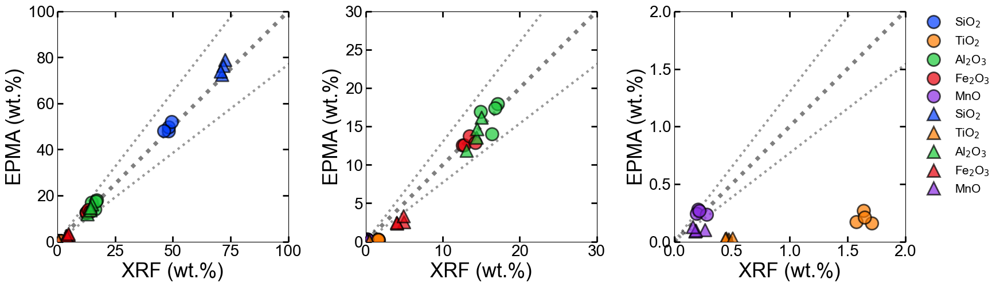

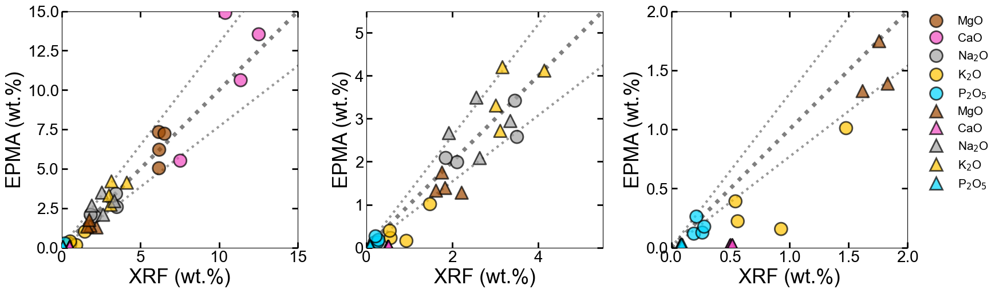

In [19]:
val_list_compile = [[100, 30, 2], [15, 5.5, 2]]
list_oxides_compile = [["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO"], ["MgO", "CaO", "Na2O", "K2O", 'P2O5']]
y_list = ['EPMA']

################################## ALL Combined
x = 'XRF'
data_list = [df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    axs = np.array(axs).reshape(len(y_list), len(val_list))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            ax = axs[t, i]  # Corrected indexing
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, palette=color_oxides,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            ax.set_ylabel(y + " (wt.%)", fontsize=25)
                
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            # label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + 'XRF_vs_EPMA_BulkComp/ALL_combined_plot_EPMA_'+str(num)+'.pdf', bbox_inches='tight')
    plt.show()


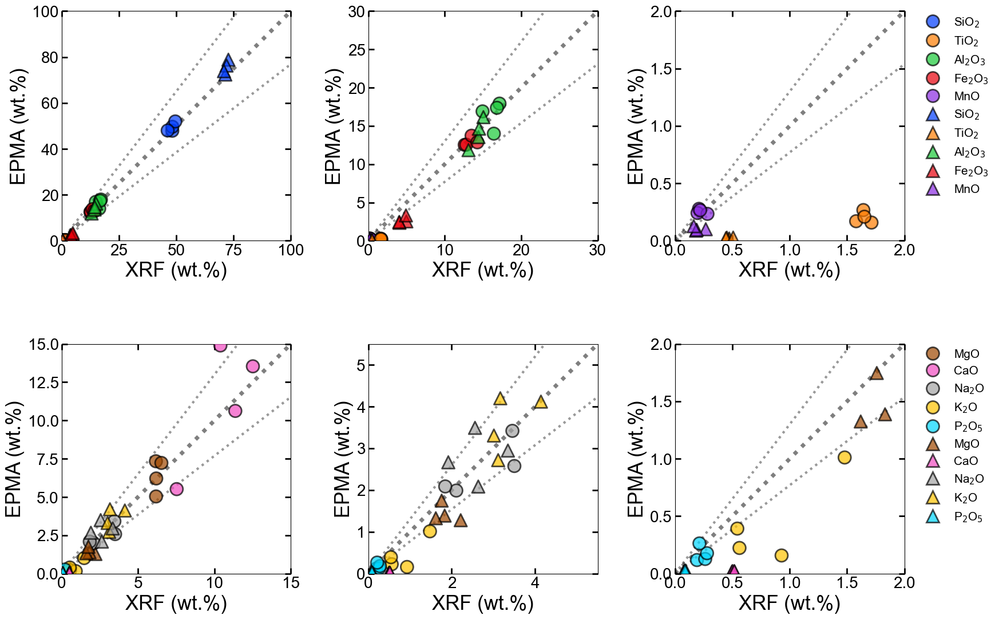

In [20]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(list_oxides_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))
axs = np.array(axs).reshape(total_rows, total_cols)

for num, (col_list, val_list) in enumerate(zip(list_oxides_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['oxides'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="oxides", hue_order=col_list, marker=symbol, palette=color_oxides,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel(x + " (wt.%)", fontsize=25)
            ax.set_ylabel(y + " (wt.%)", fontsize=25)

            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            # Label
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.savefig(folder_figure_path + 'XRF_vs_EPMA_BulkComp/ALL_combined_plot_EPMA.pdf', bbox_inches='tight')
plt.show()


# 2. Bulk mineral Mode

## Mineral (order = wt%)

In [21]:
# Mafic_compiled_data_XRF.oxides.unique()
'''
元々のリスト→重複するものは0_1でまとめてるので、まとめた物を使う
       'Actinolite', 'Albite_1',
       'Calcite', 'Epidote', 'Fluorapatite_1', 'Glaucophane', 'Graphite',
       'Hematite', 'Quartz', 'Rutile', 'Albite_2', 'Chlorite_1',
       'Chlorite_2', 'Fluorapatite_2', 'Ilmenite', 'Muscovite', 'Titanite',
       'Albite', 'Apatite', 'Chlorite', 
       'INDEX'
'''

list_minerals = [
       'Actinolite', 'Glaucophane','Calcite', 'Epidote',  'Graphite',
       'Hematite', 'Quartz', 'Rutile', 'Ilmenite', 'Muscovite', 'Titanite', 'Pyrite',
       'Albite', 'Apatite', 'Chlorite', 'Amphibole']

list_minerals_amp = [
       'Actinolite', 'Glaucophane', 'Amphibole']

list_colors_minerals = [
    '#66FFCC', # Actinolite
    '#000080', # Glaucophane
    '#D2B48C', # Calcite
    '#808000', # Epidote
    '#000000', # Graphite
    '#B22222', # Hematite
    '#C0C0C0', # Quartz
    '#FF4500', # Rutile
    '#3A3A3A', # Ilmenite
    '#FFD700', # Muscovite
    '#800080', # Titanite
    '#B8860B', # Pyrite
    '#F8F8FF', # Albite
    '#00CED1', # Apatite
    '#32CD32', # Chlorite
    '#228B22', # Amphibole
]
# 鉱物リストとカスタムパレットを辞書として定義
palette_dict_mineral = dict(zip(list_minerals, list_colors_minerals))

num_col = 7
col_mineral1 = list_minerals[:num_col]
col_mineral2 = list_minerals[num_col:]
col_list = [col_mineral1, col_mineral2, list_minerals_amp]

Mafic_compiled_data_Mode[["SP8-XRD Mode", "LAB-XRD Mode"]] = Mafic_compiled_data_Mode[["SP8-XRD Mode", "LAB-XRD Mode"]]*100
Pelitic_compiled_data_Mode[["SP8-XRD Mode", "LAB-XRD Mode"]] = Pelitic_compiled_data_Mode[["SP8-XRD Mode", "LAB-XRD Mode"]]*100

data_list = [Mafic_compiled_data_Mode.copy(), Pelitic_compiled_data_Mode.copy()]
symbol_list = ["o", "^"]
#data_list = [Mafic_compiled_data_Mode.copy()]
#data_list = [Pelitic_compiled_data_Mode.copy()]


In [22]:
Pelitic_compiled_data_Mode["Minerals"].unique()


array(['Actinolite', 'Albite_1', 'Calcite', 'Epidote_1', 'Fluorapatite_1',
       'Glaucophane', 'Graphite', 'Hematite', 'Quartz_1', 'Rutile',
       'Albite_2', 'Chlorite_1', 'Chlorite_2', 'Epidote_2',
       'Fluorapatite_2', 'Ilmenite', 'Pyrite', 'Quartz_2', 'Muscovite',
       'Titanite', 'Albite', 'Apatite', 'Chlorite', 'Amphibole', 'Quartz',
       'Epidote'], dtype=object)

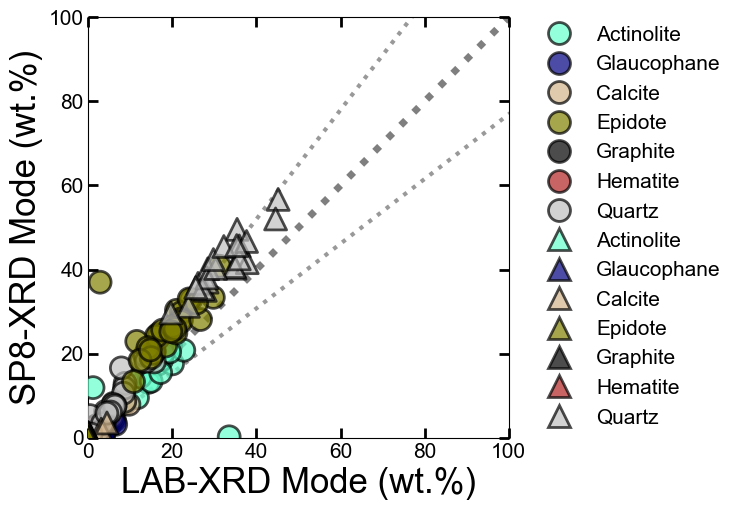

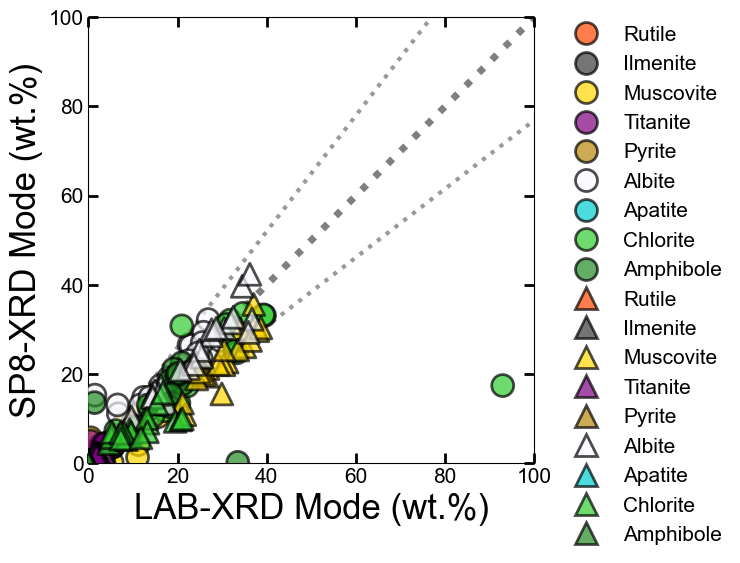

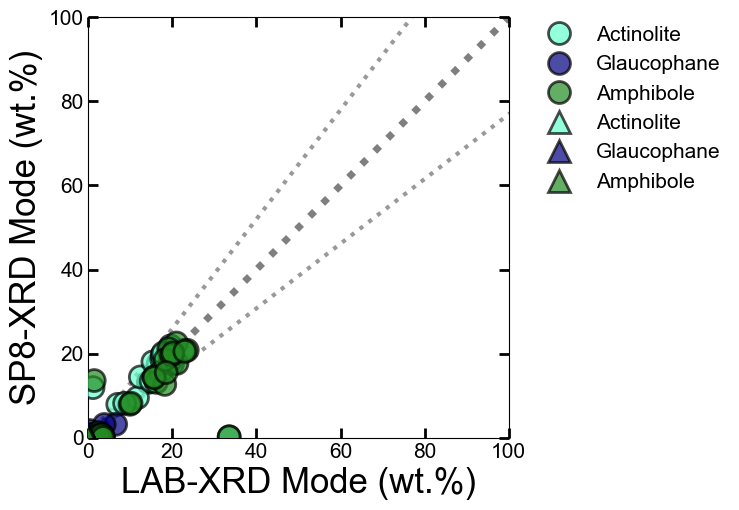

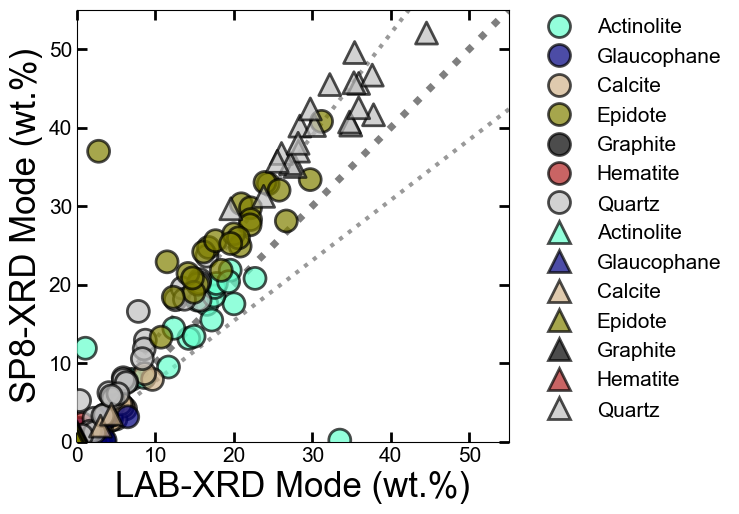

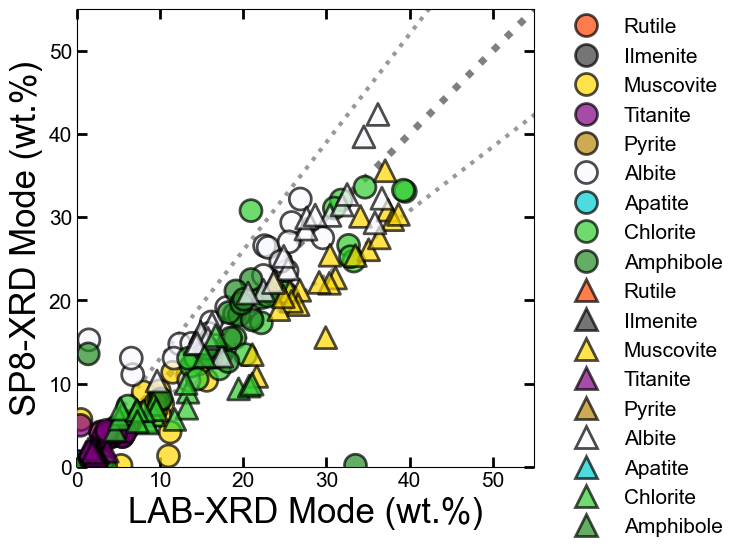

...

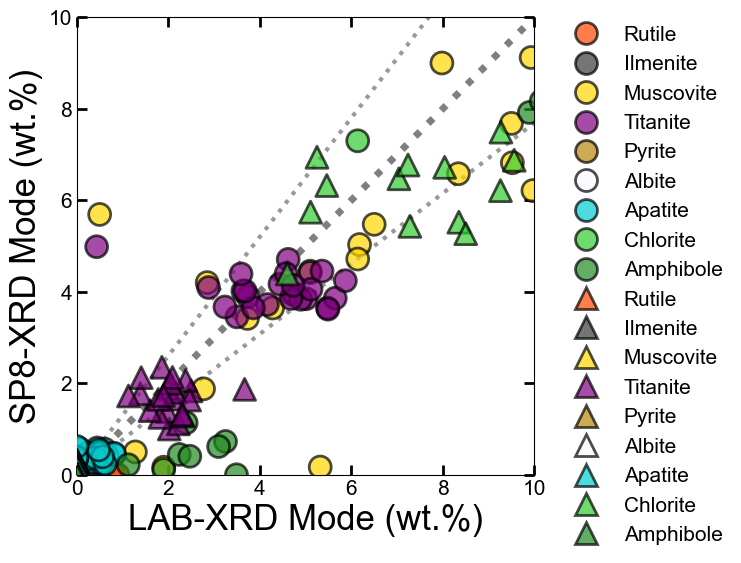

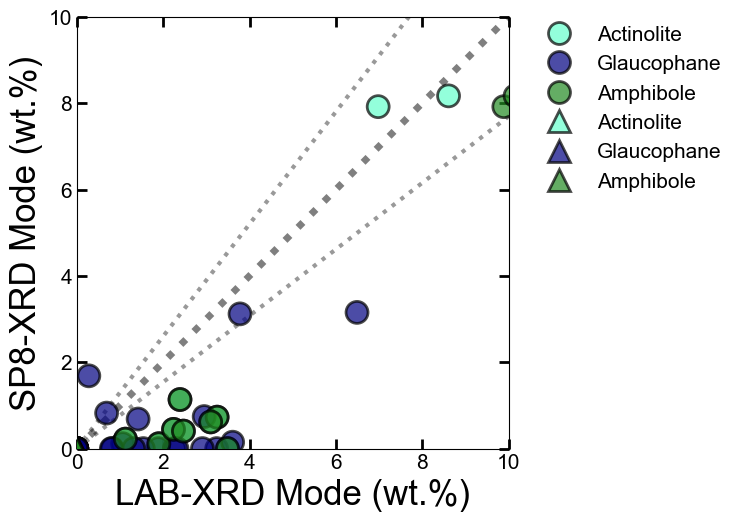

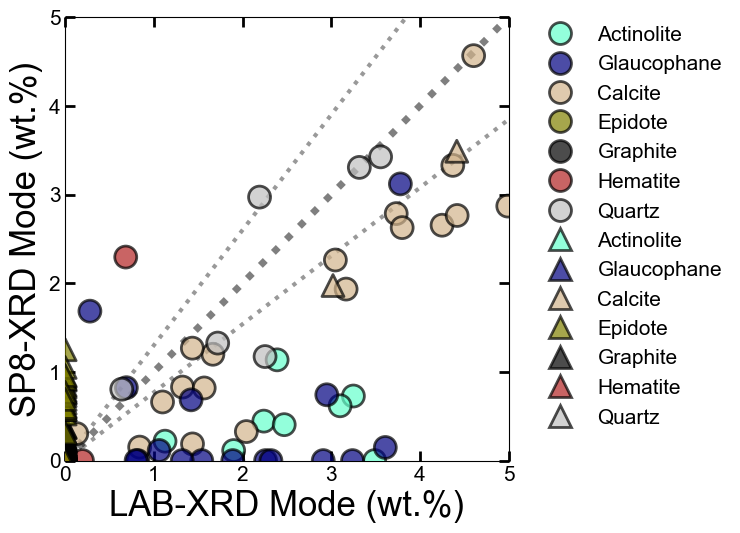

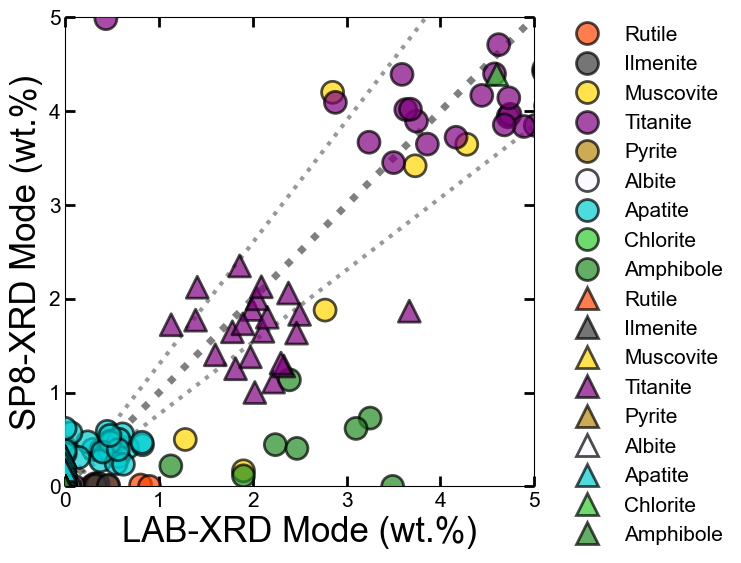

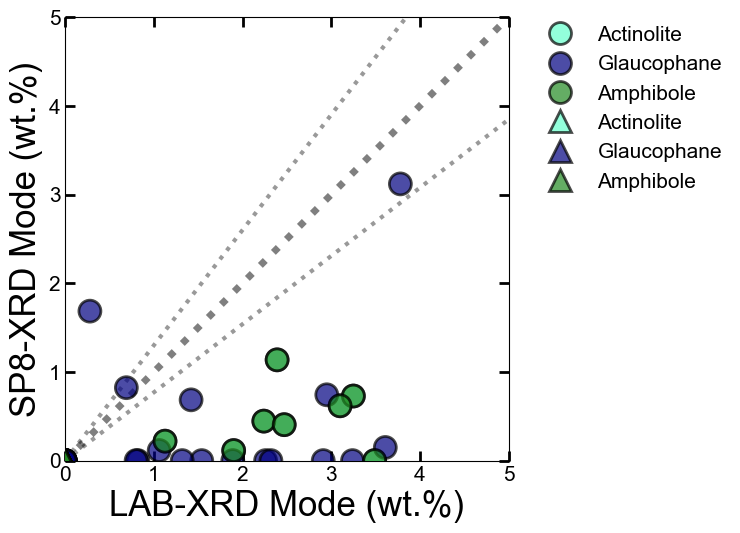

In [23]:
x = 'XRF comp.'
y_SP8 = 'SP8-XRD Mode'
y_LAB = 'LAB-XRD Mode'

# プロットを作成するリスト
val_list = [100, 55, 10, 5]
n=0
for val in val_list:
    for col in col_list:     
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
    
        for data, symbol in zip(data_list, symbol_list): # データごとに可視化
            filtered_data = data[data['Minerals'].isin(col)]
            sns.scatterplot(data=filtered_data, x=y_LAB, y=y_SP8, hue="Minerals", hue_order=col, marker=symbol, palette=palette_dict_mineral,\
                            edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)               
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)

        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
        #if n==0:
        #    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
        #else:
        #    ax.get_legend().set_visible(False)
        
        # Setting
        plt.xlabel(y_LAB + " (wt.%)", fontsize=25)
        plt.ylabel(y_SP8 + " (wt.%)", fontsize=25)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=15)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRD_vs_XRD_Mode_wt%/ALL_{val}_{n}_{y_LAB}_{y_SP8}.pdf', bbox_inches='tight')
        plt.show()

        n=n+1


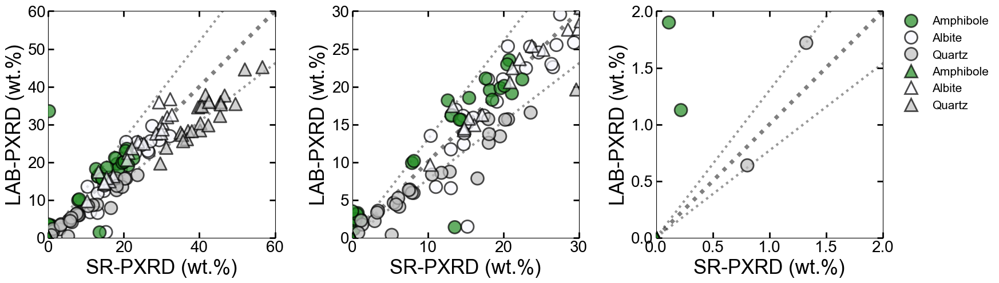

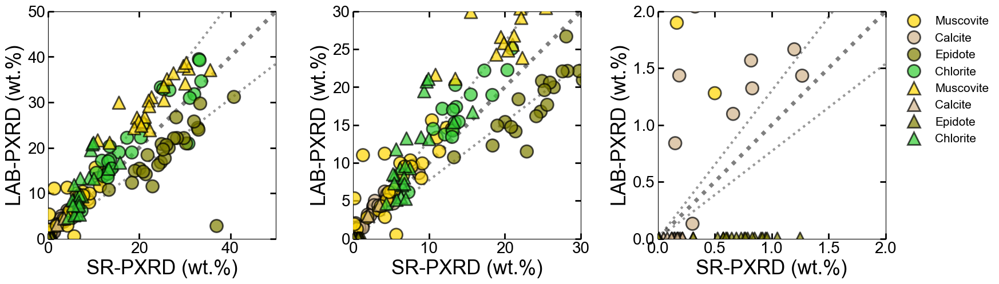

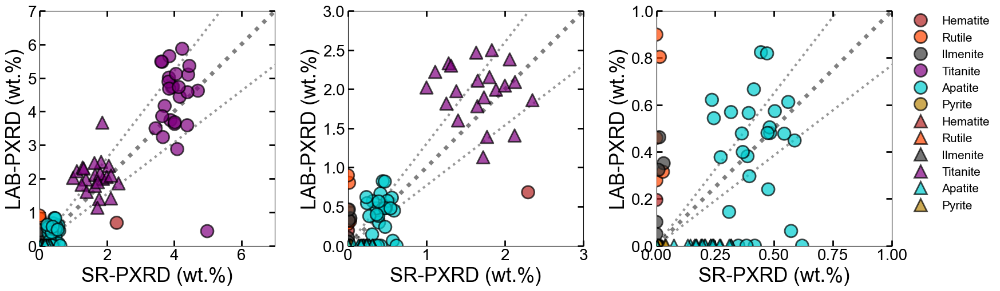

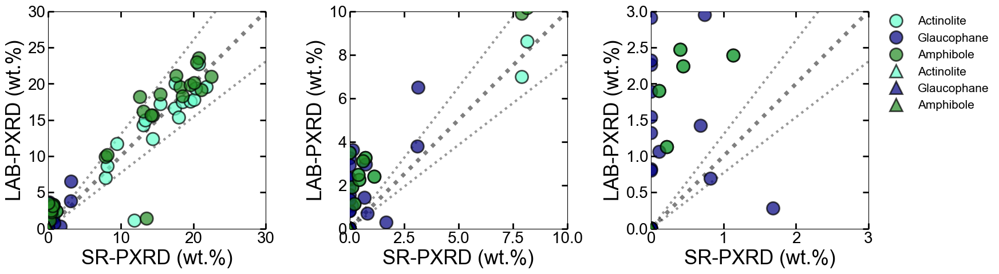

In [24]:
val_list_compile = [[60, 30, 2],[50, 30, 2], [7, 3, 1],[30, 10, 3],]

list_minerals_1 = ['Amphibole', 'Albite', 'Quartz',]
list_minerals_2 = ['Muscovite', 'Calcite', 'Epidote', 'Chlorite']

#list_minerals_3 = ['Graphite','Hematite',  'Rutile', 'Ilmenite',  'Titanite','Apatite', 'Pyrite']
list_minerals_3 = ['Hematite',  'Rutile', 'Ilmenite',  'Titanite','Apatite', 'Pyrite']

list_minerals_amp = [
       'Actinolite', 'Glaucophane', 'Amphibole']


list_minerals_compile = [list_minerals_1, list_minerals_2, list_minerals_3,list_minerals_amp]

x = 'SP8-XRD Mode'
y = 'LAB-XRD Mode'
y_list = [y]

data_list = [Mafic_compiled_data_Mode.copy(), Pelitic_compiled_data_Mode.copy()]
symbol_list = ["o", "^"]
################################## ALL Combined


for num, (col_list, val_list) in enumerate(zip(list_minerals_compile, val_list_compile)):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            if len(y_list) == 1:
                ax = axs[i]  # Corrected indexing
            else:
                ax = axs[t, i]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['Minerals'].isin(col_list)]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", hue_order=col_list, marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            # Setting labels and styles
            ax.set_xlabel("SR-PXRD (wt.%)", fontsize=25)
            ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)



    # Adjust subplot spacing
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + f'XRD_vs_XRD_Mode_wt%/ALL_combined_plot_{num}.pdf', bbox_inches='tight')
    
    plt.show()


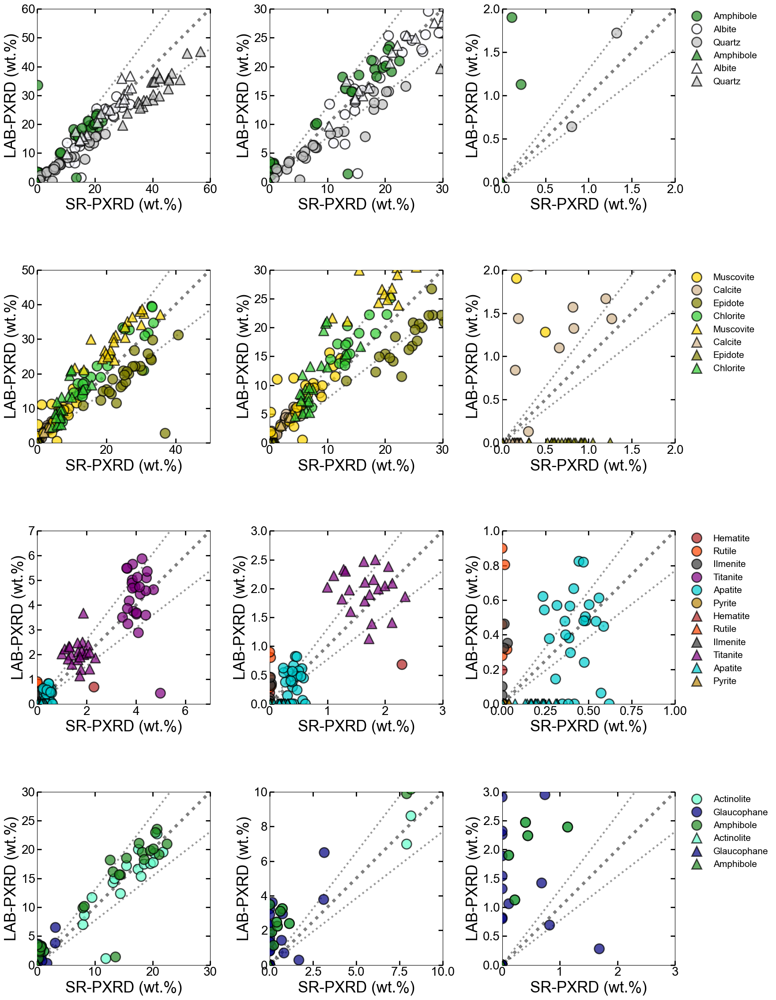

In [25]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(list_minerals_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))

for num, (col_list, val_list) in enumerate(zip(list_minerals_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx] if total_rows > 1 and total_cols > 1 else axs[col_idx]  # Handle different subplot configurations
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['Minerals'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", hue_order=col_list, marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel("SR-PXRD (wt.%)", fontsize=25)
            ax.set_ylabel("LAB-PXRD (wt.%)", fontsize=25)
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.savefig(folder_figure_path + 'XRD_vs_XRD_Mode_wt%/ALL_combined_plot.pdf', bbox_inches='tight')
plt.show()


## Mineral Volume

In [26]:
df_Compiled_Mineral_vol=pd.read_excel(folder_path + "df_Compiled_Mineral_vol.xlsx").fillna(0)

Mafic_INDEX = [ 46,  47,  48,  49,  50,  51,  63,  64,  65,  66,  67,  68, 104,
       105, 106, 112, 118, 119, 121, 122, 123, 124, 138, 139, 140, 141]
Pelitic_INDEX = [ 45,  78,  93,  94,  95,  96,  97,  98,  99, 107, 108, 109, 110,
       111, 113, 114, 135, 136, 144, 145, 146, 147]

val_list_compile = [[60, 30, 5],[50, 30, 2], [7, 3, 1],[30, 10, 3],]

list_minerals_1 = ['Amphibole', 'Albite', 'Quartz',]
list_minerals_2 = ['Muscovite', 'Calcite', 'Epidote', 'Chlorite']
# list_minerals_3 = ['Graphite','Hematite',  'Rutile', 'Ilmenite',  'Titanite','Apatite', 'Pyrite']
list_minerals_3 = ['Hematite',  'Rutile', 'Ilmenite',  'Titanite', 'Apatite', 'Pyrite']
list_minerals_amp = [
       'Actinolite', 'Glaucophane', 'Amphibole']


list_minerals_compile = [list_minerals_1, list_minerals_2, list_minerals_3,list_minerals_amp]

x = 'Mineral_Vol_SP8'
y = 'Mineral_Vol_LAB'
y_list = [y]

data_list = [df_Compiled_Mineral_vol[df_Compiled_Mineral_vol["INDEX"].isin(Mafic_INDEX)].copy(),
             df_Compiled_Mineral_vol[df_Compiled_Mineral_vol["INDEX"].isin(Pelitic_INDEX)].copy()]
symbol_list = ["o", "^"]


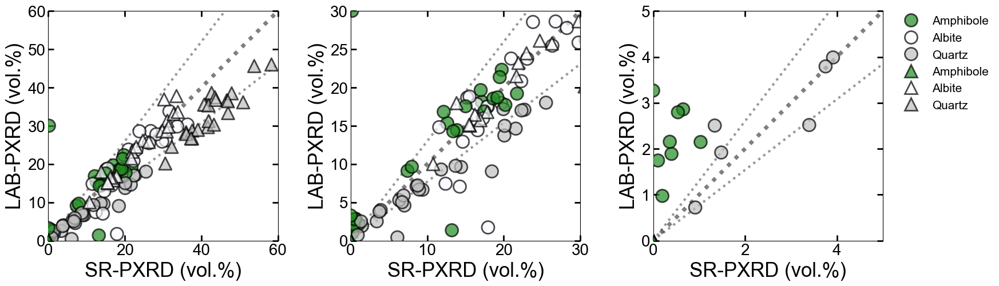

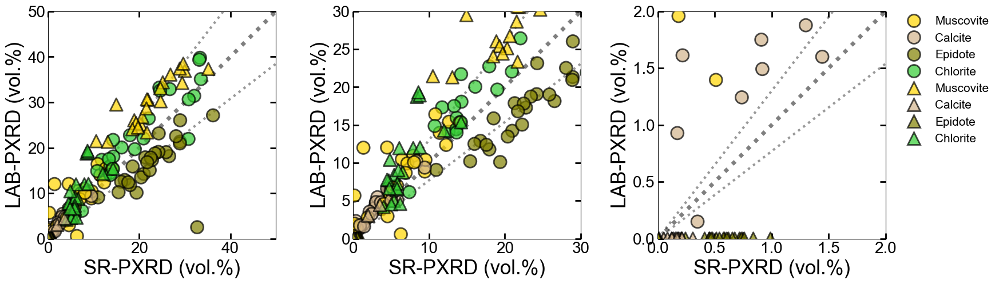

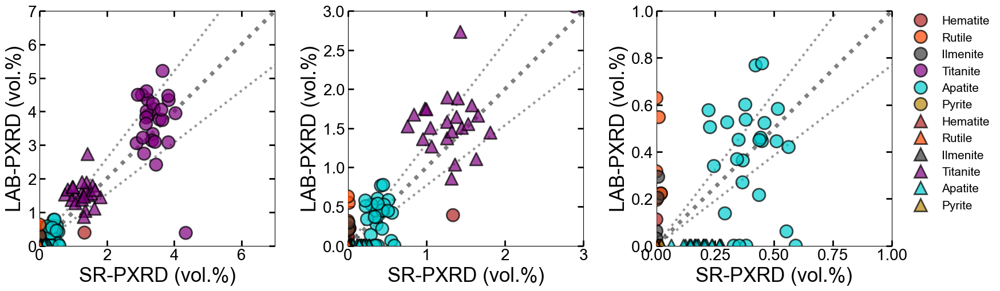

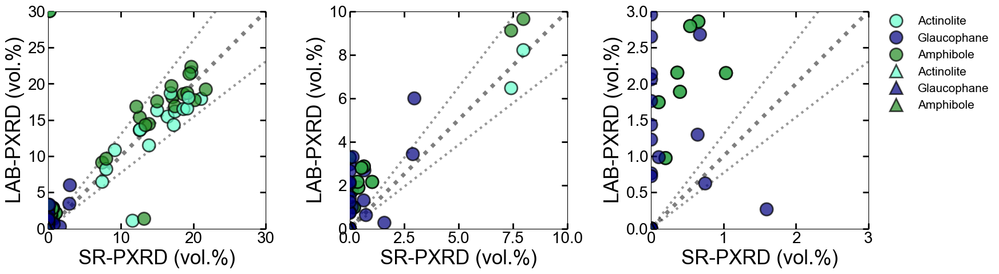

In [27]:
################################## ALL Combined
for num, (col_list, val_list) in enumerate(zip(list_minerals_compile, val_list_compile)):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            if len(y_list) == 1:
                ax = axs[i]  # Corrected indexing
            else:
                ax = axs[t, i]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['Minerals'].isin(col_list)]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", hue_order=col_list, marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            # Setting labels and styles
            ax.set_xlabel("SR-PXRD (vol.%)", fontsize=25)
            ax.set_ylabel("LAB-PXRD (vol.%)", fontsize=25)
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)



    # Adjust subplot spacing
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + f'XRD_vs_XRD_Mode_vol/ALL_combined_plot_{num}.pdf', bbox_inches='tight')
    
    plt.show()


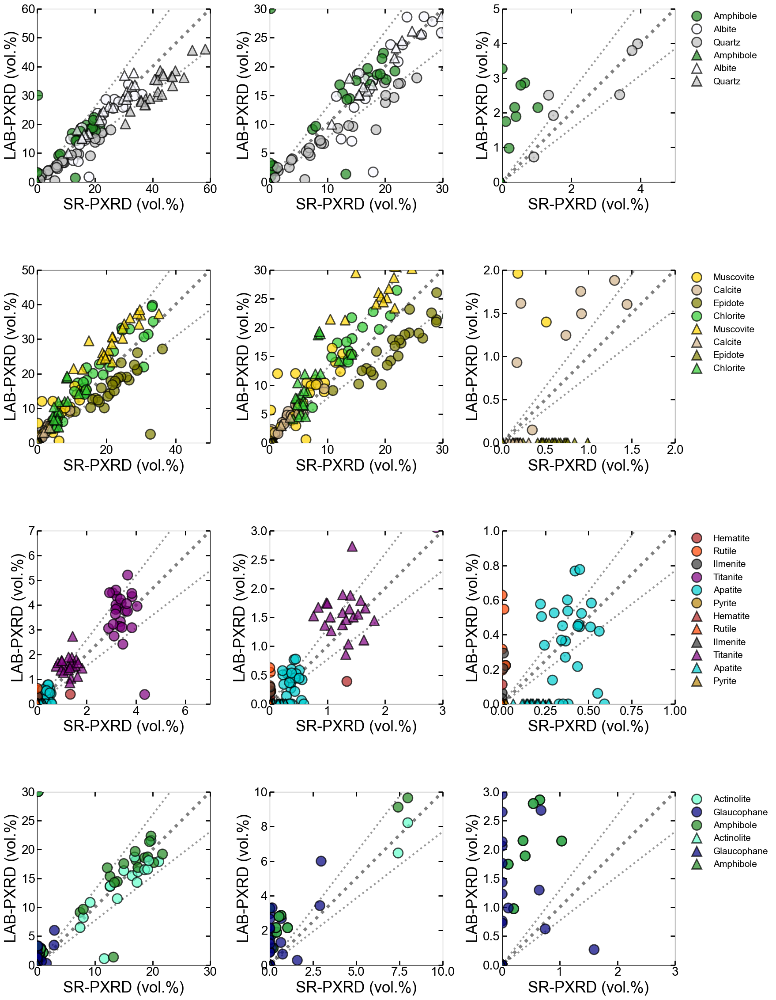

In [28]:
# Initialize the total number of rows and columns for the combined plot
total_rows = len(y_list) * len(list_minerals_compile)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))

for num, (col_list, val_list) in enumerate(zip(list_minerals_compile, val_list_compile)):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx] if total_rows > 1 and total_cols > 1 else axs[col_idx]  # Handle different subplot configurations
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data['Minerals'].isin(col_list)]

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", hue_order=col_list, marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel("SR-PXRD (vol.%)", fontsize=25)
            ax.set_ylabel("LAB-PXRD (vol.%)", fontsize=25)
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.savefig(folder_figure_path + 'XRD_vs_XRD_Mode_vol/ALL_combined_plot.pdf', bbox_inches='tight')
plt.show()


### Compile EPMA data

In [29]:
###### EPMA
Mafic_EPMA_INDEX = [ 49,  50,  64,  139]
Pelitic_EPMA_INDEX = [78, 93, 95, 113,]
drop_mineral_names = ['Plagioclase', 'Albite_1', 'Albite_2', 'Chlorite_1', 'Chlorite_2', 
                      'Fluorapatite_1', 'Fluorapatite_2', "Actinolite", "Glaucophane", 'Quartz_1', 'Quartz_2','Epidote_1', 'Epidote_2',]
###### EPMA

df_compiled_data_Mode_EPMA=pd.read_excel(folder_path + "df_compiled_data_Mode_EPMA.xlsx")

################### データを選択
data_list = [df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Mafic_EPMA_INDEX)].copy(), \
             df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Pelitic_EPMA_INDEX)].copy()]
# いらない mineralをdrop ver 240811
for num in range(len(data_list)):
    data_list[num] = data_list[num][~data_list[num]["Minerals"].isin(drop_mineral_names)].fillna(0)
    data_list[num]["EPMA Mode"] = data_list[num]["EPMA Mode"].fillna(0)
    #data_list[num] = data_list[num].fillna(0)
################### データを選択

col_mineral1 = list_minerals[:num_col]
col_mineral2 = list_minerals[num_col:]
col_list = [col_mineral1, col_mineral2]


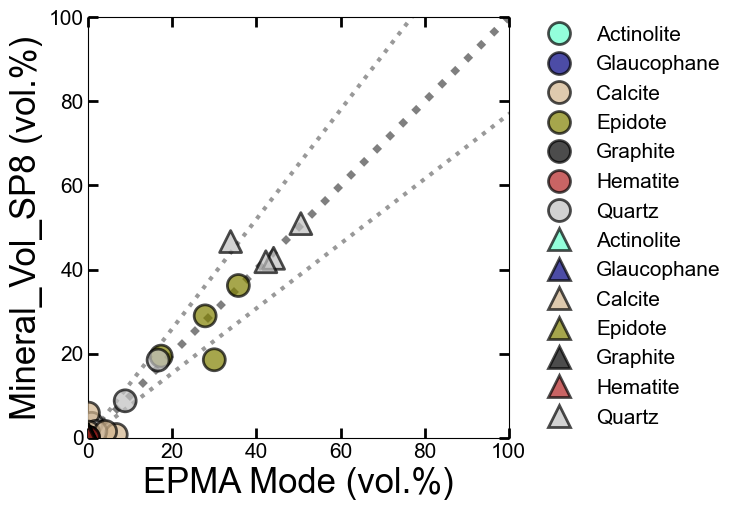

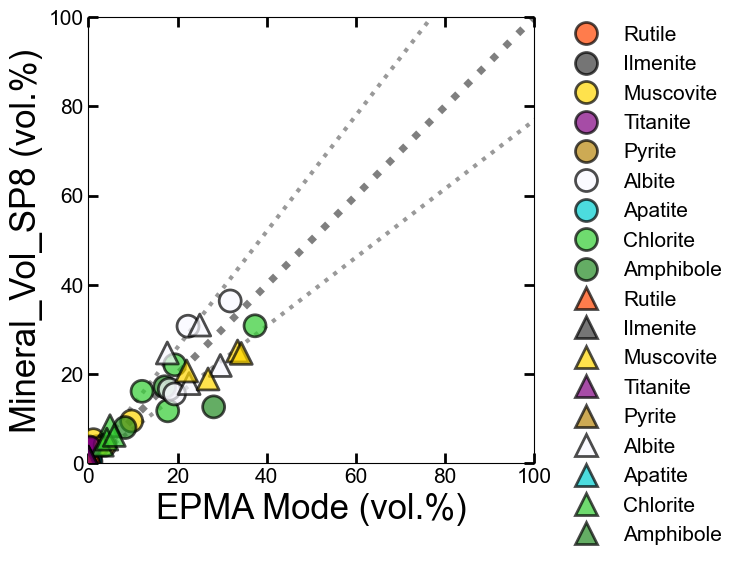

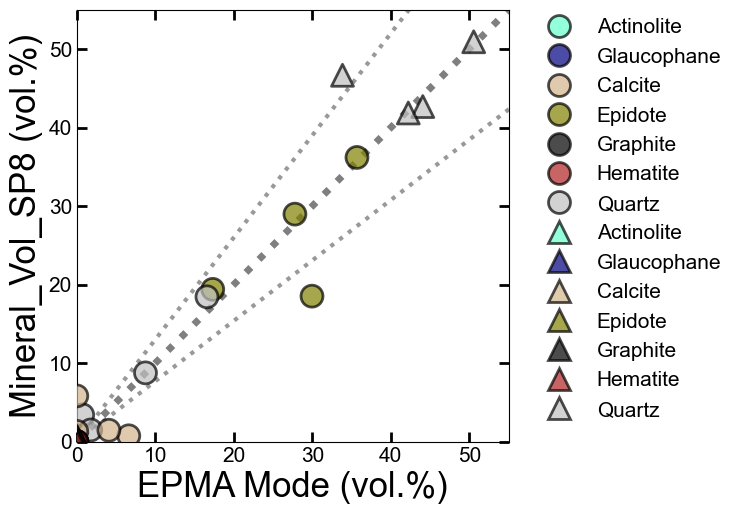

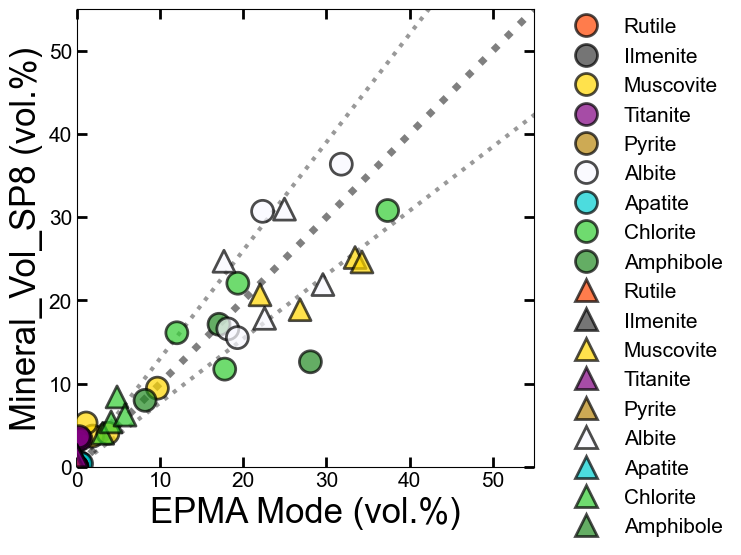

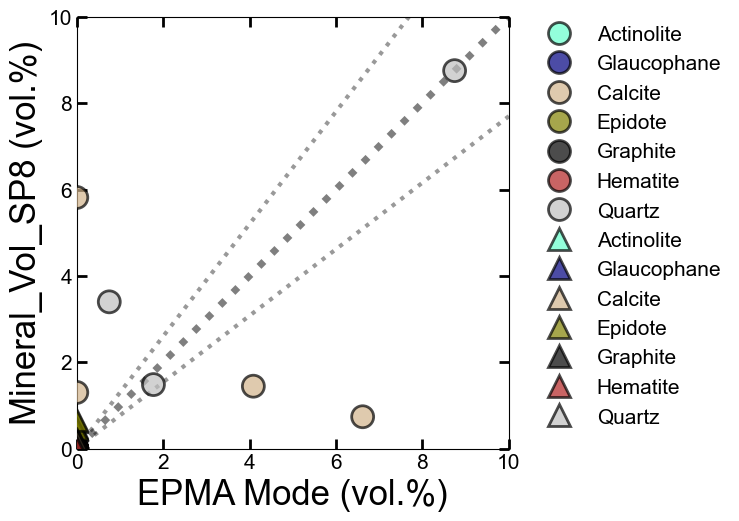

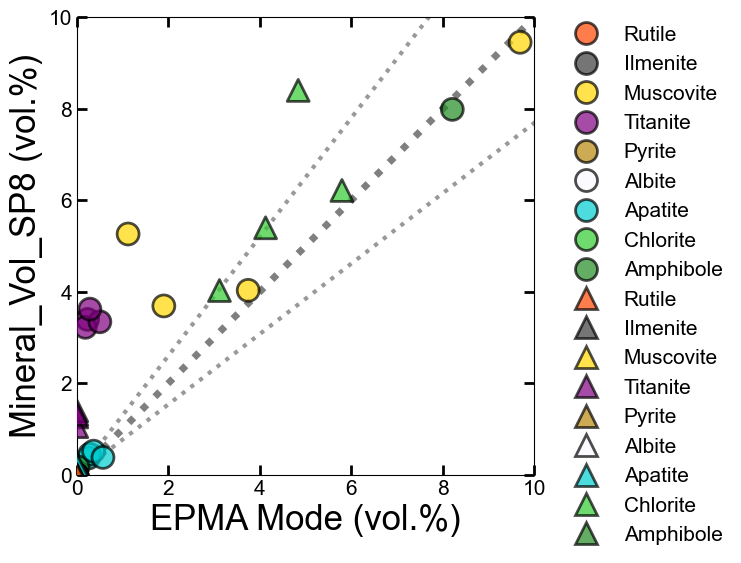

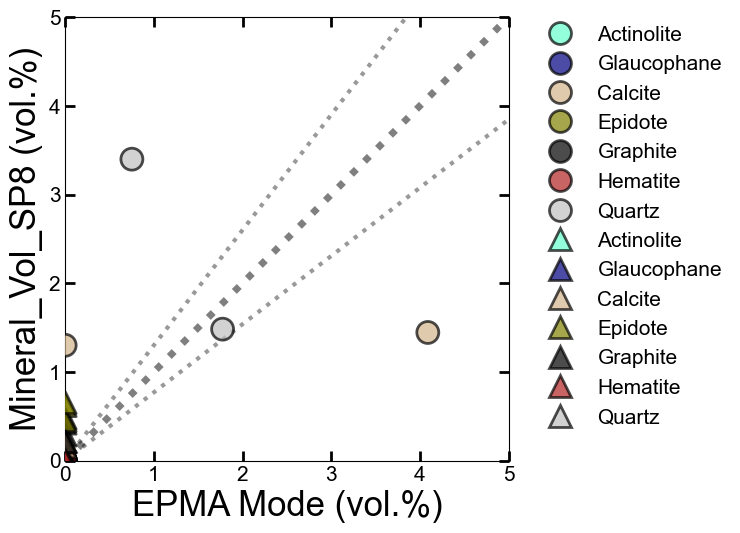

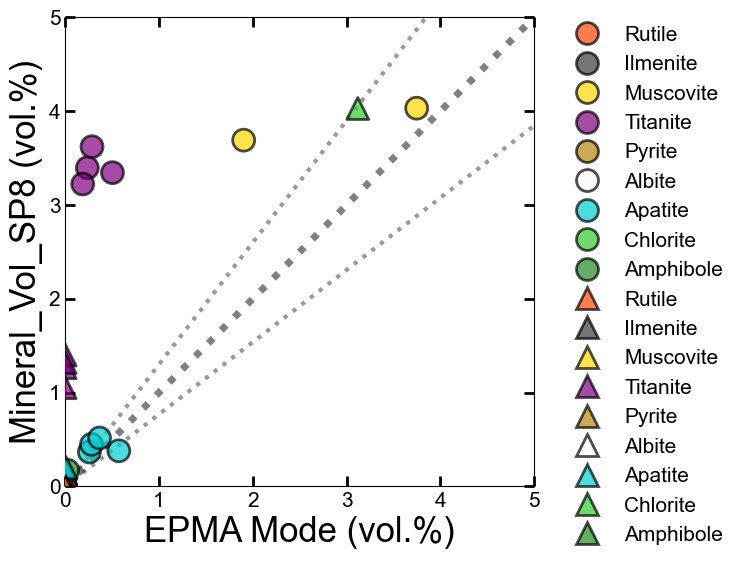

In [30]:
x = 'XRF comp.'
y_SP8 = 'Mineral_Vol_SP8'
y_LAB = 'Mineral_Vol_LAB'
y_EPMA = 'EPMA Mode'

# プロットを作成するリスト
val_list = [100, 55, 10, 5]
n=0
for val in val_list:
    for col in col_list:     
        # scatterplot
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(1, 1, 1)
        #  Setting limitation
        min_max_ax = np.array([0, val])
        # 何倍のLineを示すか？
        times_val = 0.3
    
        for data, symbol in zip(data_list, symbol_list): # データごとに可視化
            filtered_data = data[data['Minerals'].isin(col)]
            sns.scatterplot(data=filtered_data, x=y_EPMA, y=y_SP8, hue="Minerals", hue_order=col, marker=symbol, palette=palette_dict_mineral,\
                            edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)               
        # 直線
        ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
        ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
        
        plt.xlim(min_max_ax)
        plt.ylim(min_max_ax)

        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
        #if n==0:
        #    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
        #else:
        #    ax.get_legend().set_visible(False)
        
        # Setting
        plt.xlabel(y_EPMA + " (vol.%)", fontsize=25)
        plt.ylabel(y_SP8 + " (vol.%)", fontsize=25)
        ax.set_aspect('equal')
        plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=15)
        plt.tick_params(which='major', length=7.5, width=2)
        plt.tick_params(which='minor', length=4, width=1)
        plt.tight_layout()
        #plt.savefig(folder_figure_path+f'XRDvsEPMA/ALL_{val}_{n}_{y_LAB}_{y_SP8}.pdf', bbox_inches='tight')
        plt.show()

        n=n+1


x = 'XRF comp.'
y_SP8 = 'Mineral_Vol_SP8'
y_LAB = 'Mineral_Vol_LAB'
y_EPMA = 'EPMA Mode'

# プロットを作成するリスト
val_list = [100, 55, 10, 5]
n=0
for val in val_list:
    for col in col_list:         
        for data, symbol in zip(data_list, symbol_list): # データごとに可視化
            filtered_data = data[data['Minerals'].isin(col)]
            for index_now in filtered_data["INDEX"].unique():
                # scatterplot
                fig = plt.figure(figsize=(8, 8))
                ax = fig.add_subplot(1, 1, 1)
                #  Setting limitation
                min_max_ax = np.array([0, val])
                # 何倍のLineを示すか？
                times_val = 0.3
                
                index_data = filtered_data[filtered_data["INDEX"]==index_now]
                sns.scatterplot(data=index_data, x=y_EPMA, y=y_SP8, hue="Minerals", hue_order=col, marker=symbol, palette=palette_dict_mineral,\
                                edgecolor="black", linewidth=2, alpha=0.7, s=500, zorder=3)               
                # 直線
                ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
                ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
                ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
                
                plt.xlim(min_max_ax)
                plt.ylim(min_max_ax)
        
                plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
                #if n==0:
                #    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18, frameon=False)
                #else:
                #    ax.get_legend().set_visible(False)
                
                # Setting
                plt.xlabel(y_EPMA + " (vol%)", fontsize=25)
                plt.ylabel(y_SP8 + " (vol%)", fontsize=25)
                plt.title(index_now, fontsize=25)
                ax.set_aspect('equal')
                plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=15)
                plt.tick_params(which='major', length=7.5, width=2)
                plt.tick_params(which='minor', length=4, width=1)
                plt.tight_layout()
                plt.savefig(folder_figure_path+f'XRDvsEPMA/NUM/ALL_{index_now}_{val}_{y_LAB}_{y_SP8}_{n}.pdf', bbox_inches='tight')
                plt.show()
        
                n=n+1

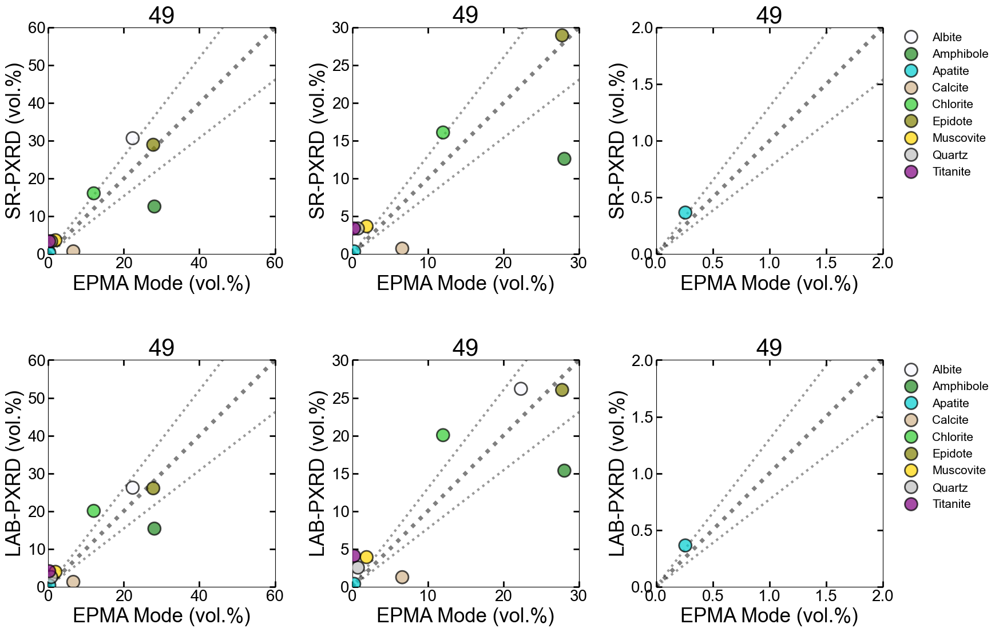

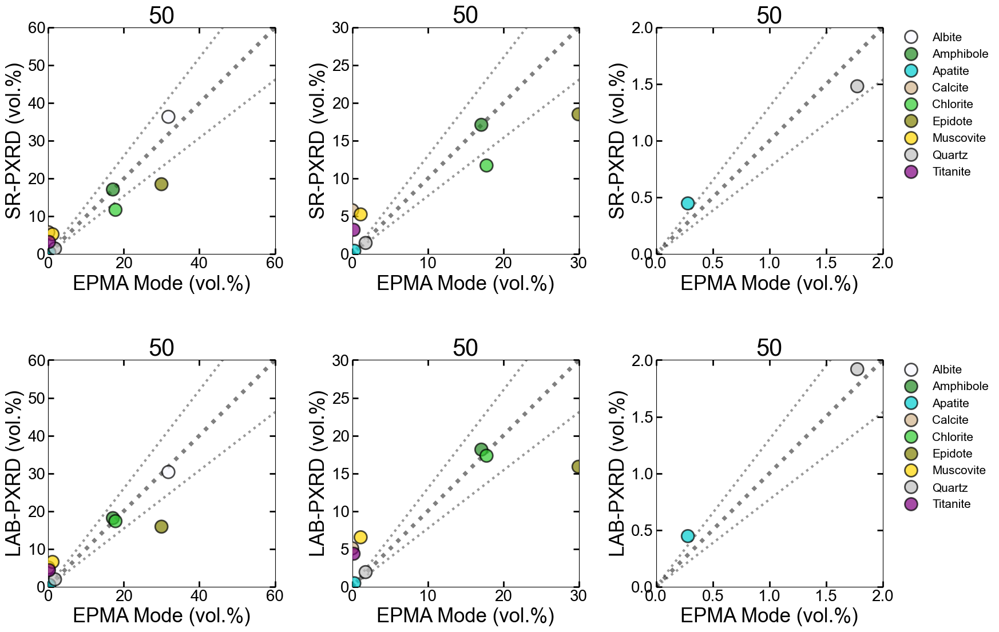

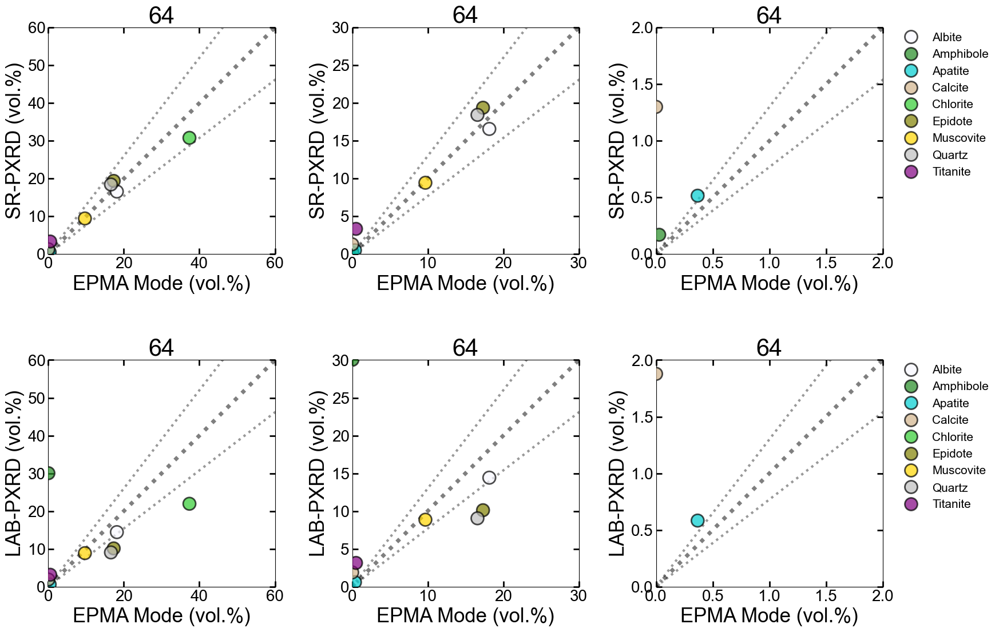

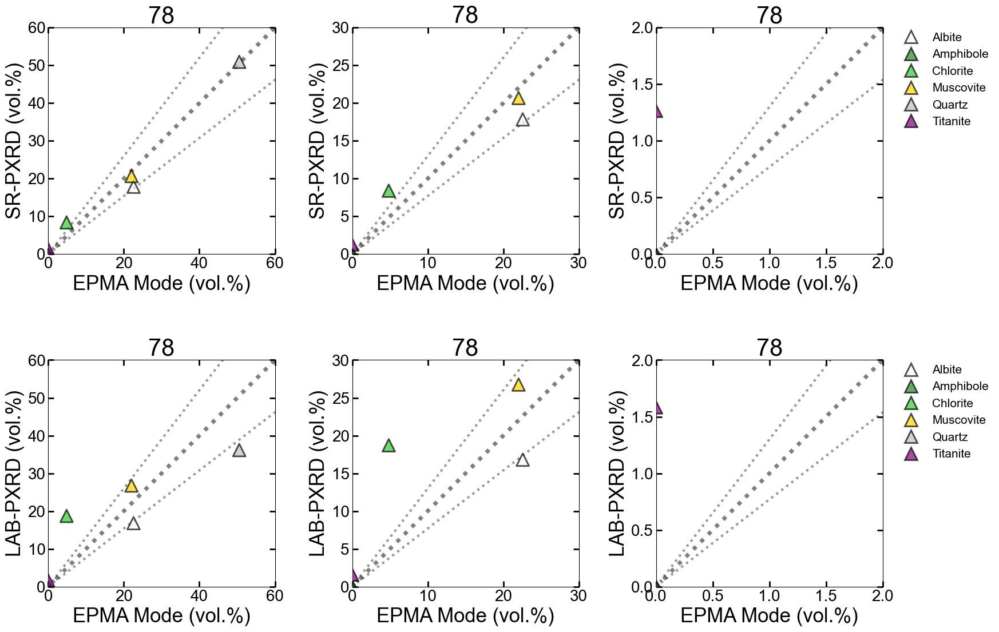

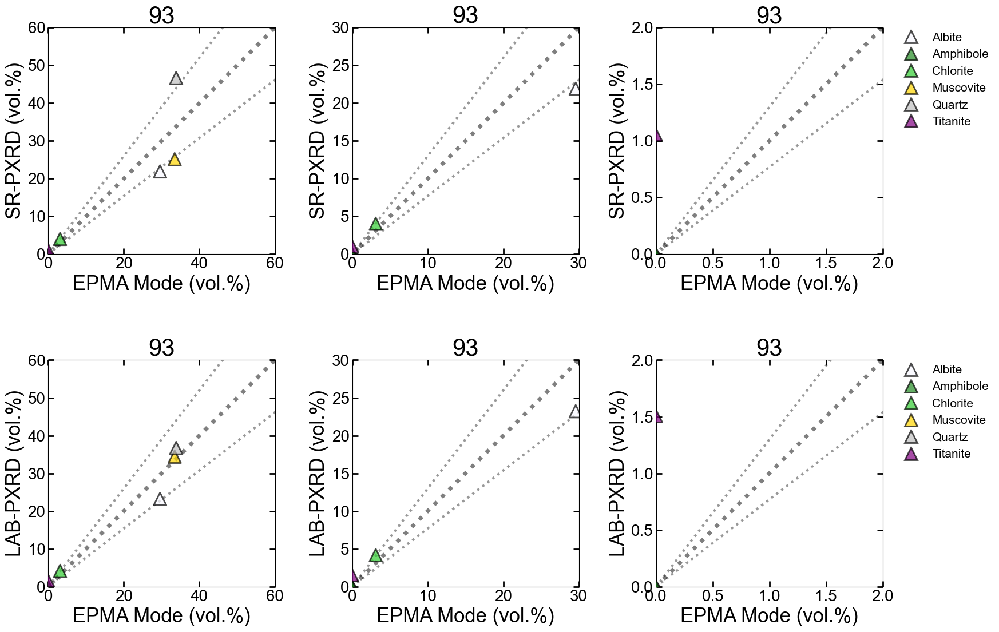

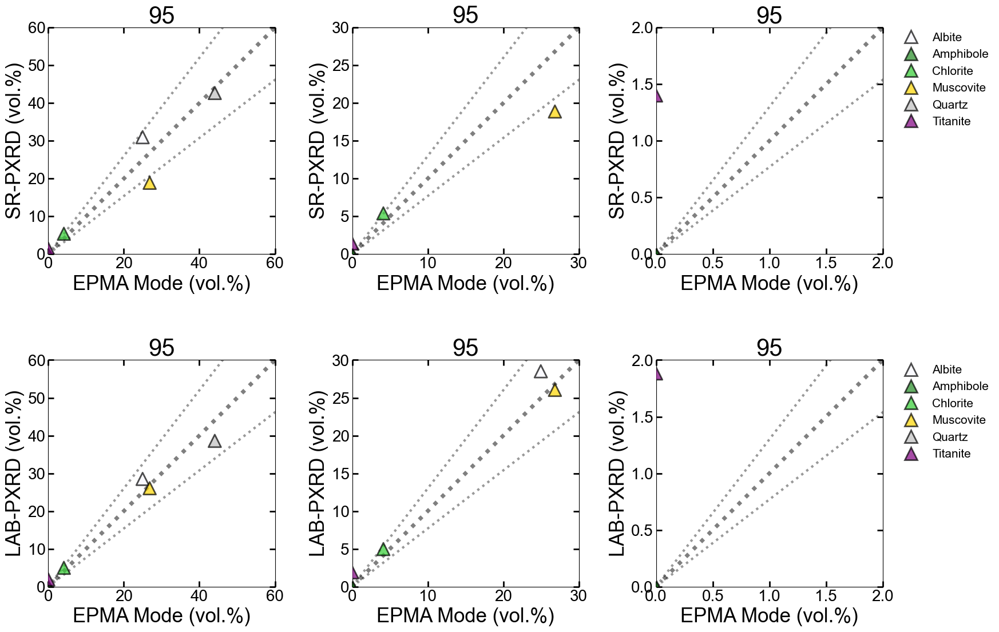

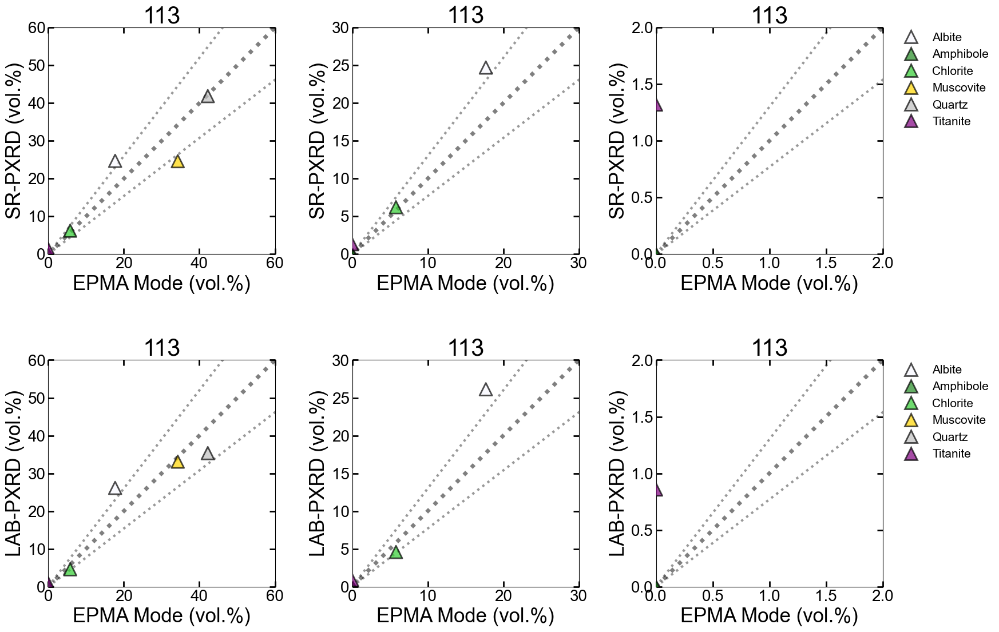

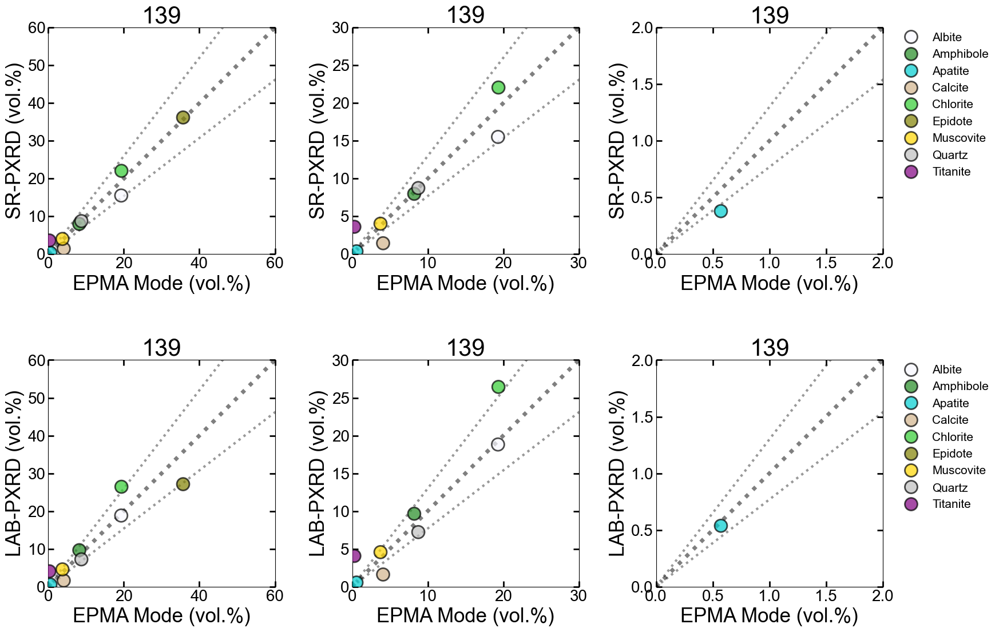

In [31]:
# プロット設定
val_list_compile = [[60, 30, 2]]
x = 'EPMA Mode'
y_list = ["Mineral_Vol_SP8", "Mineral_Vol_LAB"]
INDEX_list = df_compiled_data_Mode_EPMA.dropna()["INDEX"].unique()
data_list = [df_compiled_data_Mode_EPMA.dropna()]
symbol_list = ["o", "^"]

for num, index in enumerate(INDEX_list):
    val_list = val_list_compile[0]
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):
        for t, y in enumerate(y_list):
            if len(y_list) == 1:
                ax = axs[i]
            else:
                ax = axs[t, i]
            
            min_max_ax = np.array([0, val])
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data[data["INDEX"] == index]
                if index in Mafic_INDEX: # Symbolの選択
                    symbol=symbol_list[0]
                else:
                    symbol=symbol_list[1]
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_title(index)
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            ax.set_xlabel(x + " (vol.%)", fontsize=25)
            if y == "Mineral_Vol_SP8":
                ax.set_ylabel("SR-PXRD (vol.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (vol.%)", fontsize=25)
                
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)
                
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    
    plt.tight_layout()
    #plt.savefig(folder_figure_path + f'XRDvsEPMA/NUM/Each_combined_plot_{index}.pdf', bbox_inches='tight')
    
    plt.show()


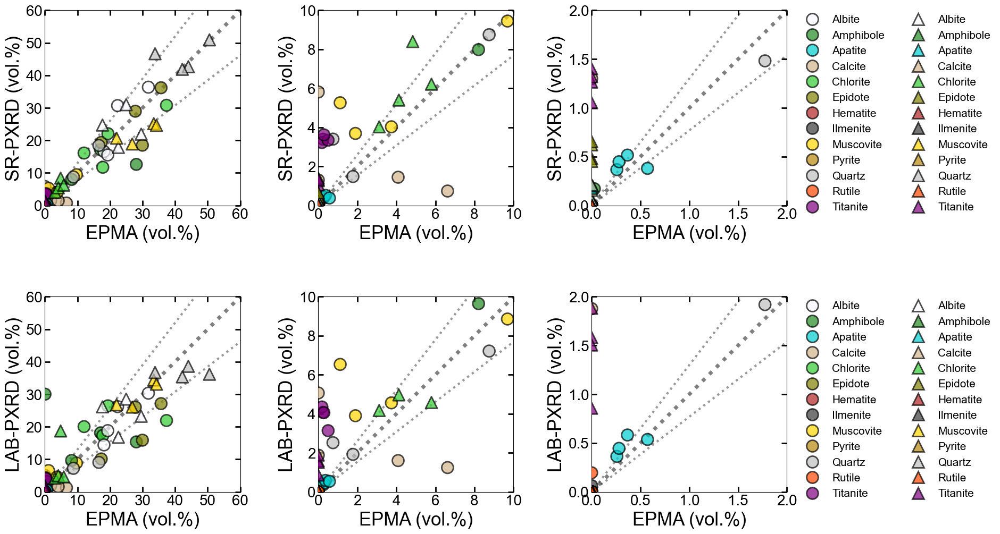

In [32]:
###### EPMA
Mafic_EPMA_INDEX = [ 49,  50,  64,  139]
Pelitic_EPMA_INDEX = [78, 93, 95, 113,]
drop_mineral_names = ['Plagioclase', 'Albite_1', 'Albite_2', 'Chlorite_1', 'Chlorite_2', 
                      'Fluorapatite_1', 'Fluorapatite_2', "Actinolite", "Glaucophane", 'Quartz_1', 'Quartz_2','Epidote_1', 'Epidote_2', "Graphite"]
###### EPMA

df_compiled_data_Mode_EPMA=pd.read_excel(folder_path + "df_compiled_data_Mode_EPMA.xlsx")

################### データを選択
data_list = [df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Mafic_EPMA_INDEX)].copy(), \
             df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Pelitic_EPMA_INDEX)].copy()]
# いらない mineralをdrop ver 240811
for num in range(len(data_list)):
    data_list[num] = data_list[num][~data_list[num]["Minerals"].isin(drop_mineral_names)].fillna(0)
    data_list[num]["EPMA Mode"] = data_list[num]["EPMA Mode"].fillna(0)
################### データを選択

col_mineral1 = list_minerals[:num_col]
col_mineral2 = list_minerals[num_col:]
col_list = [col_mineral1, col_mineral2]

####################################################################################### ALL Sample
val_list_compile = [[60, 10, 2]]

x = 'EPMA Mode'
y_list = ["Mineral_Vol_SP8", "Mineral_Vol_LAB"]

# Assume df_compiled_data_Mode_EPMA is defined somewhere
symbol_list = ["o", "^"]

for num, val_list in enumerate(val_list_compile):
    # Figure size calculation
    fig_width = 6 * len(val_list)
    fig_height = 6 * len(y_list)
    
    fig, axs = plt.subplots(len(y_list), len(val_list), figsize=(fig_width, fig_height))
    
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            if len(y_list) == 1:
                ax = axs[i]  # Corrected indexing
            else:
                ax = axs[t, i]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3
            
            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data.dropna() # NaNを0で埋める：図に表示させるため Modified 240811
                #filtered_data = data.fillna(0) # NaNを0で埋める：図に表示させるため Modified 240811
    
                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)
    
            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            
            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)
            
            # Setting labels and styles
            ax.set_xlabel("EPMA (vol.%)", fontsize=25)
            if y == "Mineral_Vol_SP8":
                ax.set_ylabel("SR-PXRD (vol.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (vol.%)", fontsize=25)
                
            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)
            
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False, ncol=2)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))

    # Adjust subplot spacing
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    
    #plt.tight_layout()
    plt.savefig(folder_figure_path + f'XRDvsEPMA/ALL_combined_plot_{num}.pdf', bbox_inches='tight')
    
    plt.show()


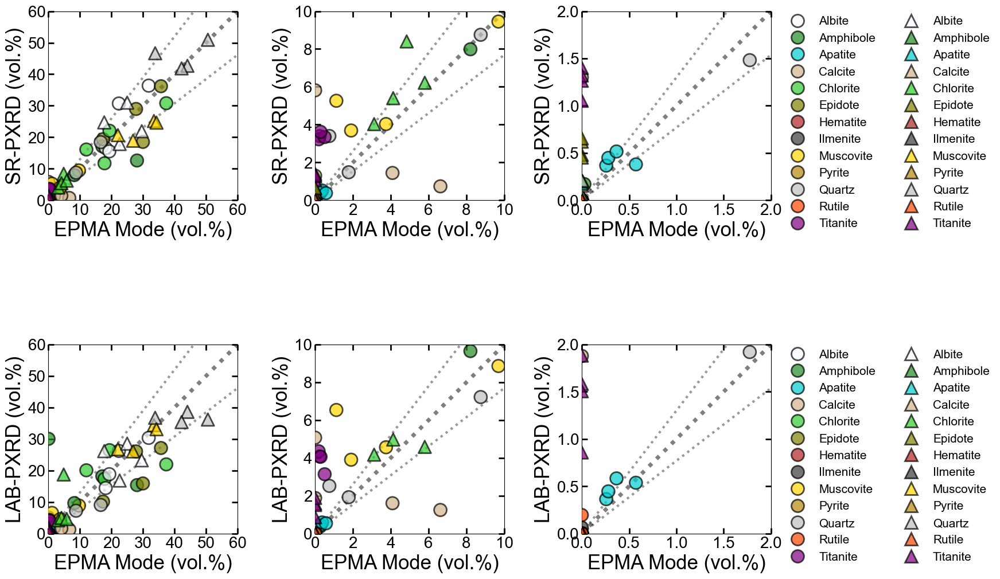

In [33]:
###### EPMA
Mafic_EPMA_INDEX = [ 49,  50,  64,  139]
Pelitic_EPMA_INDEX = [78, 93, 95, 113,]
drop_mineral_names = ['Plagioclase', 'Albite_1', 'Albite_2', 'Chlorite_1', 'Chlorite_2', 
                      'Fluorapatite_1', 'Fluorapatite_2', "Actinolite", "Glaucophane", 'Quartz_1', 'Quartz_2','Epidote_1', 'Epidote_2', "Graphite"]
###### EPMA

df_compiled_data_Mode_EPMA=pd.read_excel(folder_path + "df_compiled_data_Mode_EPMA.xlsx")

################### データを選択
data_list = [df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Mafic_EPMA_INDEX)].copy(), \
             df_compiled_data_Mode_EPMA[df_compiled_data_Mode_EPMA["INDEX"].isin(Pelitic_EPMA_INDEX)].copy()]
# いらない mineralをdrop ver 240811
for num in range(len(data_list)):
    data_list[num] = data_list[num][~data_list[num]["Minerals"].isin(drop_mineral_names)].fillna(0)
    data_list[num]["EPMA Mode"] = data_list[num]["EPMA Mode"].fillna(0)
################### データを選択
col_mineral1 = list_minerals[:num_col]
col_mineral2 = list_minerals[num_col:]
col_list = [col_mineral1, col_mineral2]

val_list_compile = [[60, 10, 2]]
y_list = ["Mineral_Vol_SP8", "Mineral_Vol_LAB"]
x = 'EPMA Mode'
symbol_list = ["o", "^"]

# Initialize the total number of rows and columns for the combined plot
total_rows = len(val_list_compile) * len(y_list)
total_cols = len(val_list_compile[0])  # Assuming each col_list has the same length

# Calculate the figure size based on the total number of rows and columns
fig_width = 6 * total_cols
fig_height = 6 * total_rows

fig, axs = plt.subplots(total_rows, total_cols, figsize=(fig_width, fig_height))
axs = np.array(axs).reshape(total_rows, total_cols)

for num, val_list in enumerate(val_list_compile):
    for i, val in enumerate(val_list):  # Value limitation
        for t, y in enumerate(y_list):  # Data selection
            # Calculate the correct position in the combined subplot grid
            row_idx = num * len(y_list) + t
            col_idx = i

            ax = axs[row_idx, col_idx]  # Corrected indexing
            
            # Setting limitation
            min_max_ax = np.array([0, val])
            # Line to indicate a percentage deviation
            times_val = 0.3

            for data, symbol in zip(data_list, symbol_list):
                filtered_data = data.dropna()

                sns.scatterplot(ax=ax, data=filtered_data, x=x, y=y, hue="Minerals", marker=symbol, palette=palette_dict_mineral,
                                edgecolor="black", linewidth=2, alpha=0.7, s=250, zorder=3)

            # Plot reference lines
            ax.plot(min_max_ax, min_max_ax, color='black', linestyle=":", linewidth=5, zorder=2, alpha=0.5)
            ax.plot(min_max_ax * (1 + times_val), min_max_ax, color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)
            ax.plot(min_max_ax, min_max_ax * (1 + times_val), color='black', linestyle=":", linewidth=3, zorder=1, alpha=0.4)

            ax.set_xlim(min_max_ax)
            ax.set_ylim(min_max_ax)

            # Setting labels and styles
            ax.set_xlabel(x + " (vol.%)", fontsize=25)
            if y == "Mineral_Vol_SP8":
                ax.set_ylabel("SR-PXRD (vol.%)", fontsize=25)
            else:
                ax.set_ylabel("LAB-PXRD (vol.%)", fontsize=25)

            ax.set_aspect('equal')
            ax.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=20)
            ax.tick_params(which='major', length=7.5, width=2)
            ax.tick_params(which='minor', length=4, width=1)

            # Label 
            handles, labels = ax.get_legend_handles_labels()
            labels = [to_latex(label) for label in labels]
            ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15, frameon=False, ncol=2)
            if not (i == len(val_list) - 1):  # Hide legend for all but the last subplot
                ax.get_legend().set_visible(False)

            # Calculate major tick interval
            x_ticks = ax.get_xticks()
            y_ticks = ax.get_yticks()
            tick_interval = min(x_ticks[1] - x_ticks[0], y_ticks[1] - y_ticks[0])
            ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_interval))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_interval))

# Adjust subplot spacing
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.savefig(folder_figure_path + 'XRDvsEPMA/ALL_combined_plot.pdf', bbox_inches='tight')
plt.show()


# 3. Compile Parameter

In [34]:
Mafic_compiled_data_Param=pd.read_excel(folder_path + "Mafic_compiled_data_Param.xlsx")
Pelitic_compiled_data_Param=pd.read_excel(folder_path + "Pelitic_compiled_data_Param.xlsx")


/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3979824006.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3979824006.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3979824006.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3979824006.py:32: UserWarning: set_ticklabels() shoul

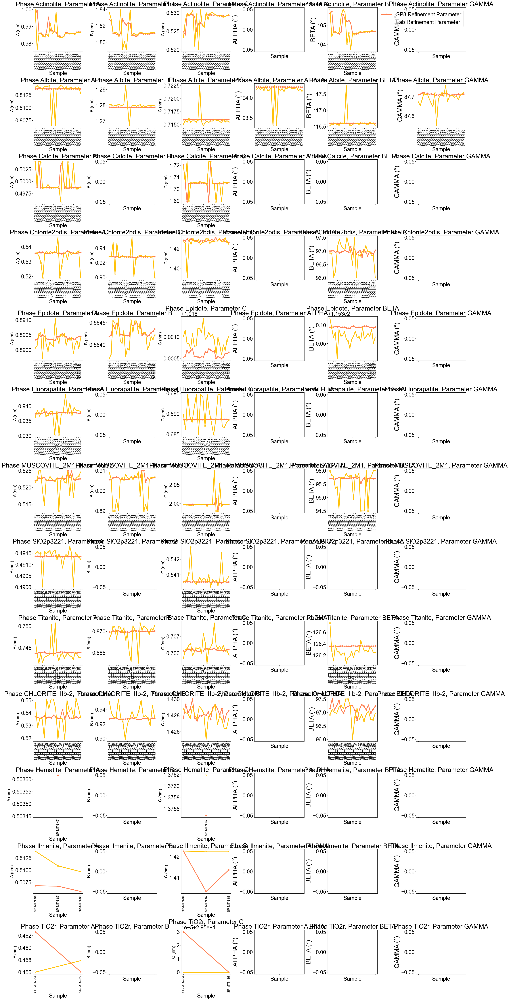

In [35]:
df = Mafic_compiled_data_Param.copy().dropna()

# Creating a plot for each phase and parameter combination
phases = df['Phase'].unique()
#params = df['Param'].unique()
params = ['A',  'B', 'C','ALPHA','BETA', 'GAMMA']

lattice_angle = params[3:]
 
fig, axes = plt.subplots(nrows=len(phases), ncols=len(params), figsize=(30, 5 * len(phases)), constrained_layout=True)

if len(phases) == 1 and len(params) == 1:
    axes = [[axes]]
elif len(phases) == 1:
    axes = [axes]
elif len(params) == 1:
    axes = [[ax] for ax in axes]

for i, phase in enumerate(phases):
    for j, param in enumerate(params):
        phase_param_data = df[(df['Phase'] == phase) & (df['Param'] == param)]
        axes[i][j].plot(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), \
                     color='#FF7F50', marker='o', label='SP8 Refinement Parameter', linewidth=3.5)
        axes[i][j].plot(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), \
                     color='#FFC107', marker='x', label='Lab Refinement Parameter', linewidth=3.5)
        axes[i][j].set_title(f'Phase {phase}, Parameter {param}')
        axes[i][j].set_xlabel('Sample')
        if param in lattice_angle:
            axes[i][j].set_ylabel(f'{param} (°)', fontsize=30)
        else:
            axes[i][j].set_ylabel(f'{param} (nm)', fontsize=20)
        axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
        if j == 0:
            #axes[i][j].set_ylabel('Parameter Value')
            pass
        if i == 0 and j == len(params) - 1:
            axes[i][j].legend()
            
plt.savefig(folder_figure_path+f'XRD_lattice_constant/ALL_Mafic.pdf', bbox_inches='tight')
plt.show()

# 距離順に並べたら面白そう


/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3661388219.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3661388219.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3661388219.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/3661388219.py:35: UserWarning: set_ticklabels() shoul

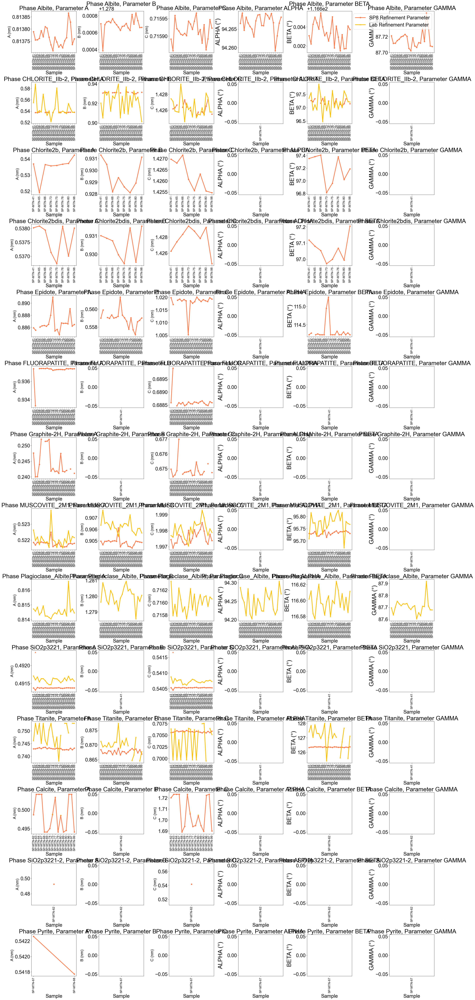

In [36]:
df = Pelitic_compiled_data_Param.copy()

# Creating a plot for each phase and parameter combination
phases = df['Phase'].unique()
#params = df['Param'].unique()
params = ['A',  'B', 'C','ALPHA','BETA', 'GAMMA']

fig, axes = plt.subplots(nrows=len(phases), ncols=len(params), figsize=(30, 5 * len(phases)), constrained_layout=True)

if len(phases) == 1 and len(params) == 1:
    axes = [[axes]]
elif len(phases) == 1:
    axes = [axes]
elif len(params) == 1:
    axes = [[ax] for ax in axes]

for i, phase in enumerate(phases):
    for j, param in enumerate(params):
        phase_param_data = df[(df['Phase'] == phase) & (df['Param'] == param)]
        axes[i][j].plot(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), \
                     color='#FF7F50', marker='o', label='SP8 Refinement Parameter', linewidth=3.5)
        axes[i][j].plot(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), \
                     color='#FFC107', marker='x', label='Lab Refinement Parameter', linewidth=3.5)
        if phase == 'SiO2p3221' and 'SiO2p3221-2' in df['Phase'].unique() :
            phase_param_data_qz = df[(df['Phase'] == 'SiO2p3221-2') & (df['Param'] == param)]
            axes[i][j].plot(phase_param_data_qz['Sample'], phase_param_data_qz['SP8 Refinement Parameter'].astype(float), \
                     color='#FF7F50', marker='^', linewidth=3.5)
        
        axes[i][j].set_title(f'Phase {phase}, Parameter {param}')
        axes[i][j].set_xlabel('Sample')
        if param in lattice_angle:
            axes[i][j].set_ylabel(f'{param} (°)', fontsize=30)
        else:
            axes[i][j].set_ylabel(f'{param} (nm)', fontsize=20)
        axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
        if j == 0:
            #axes[i][j].set_ylabel('Parameter Value')
            pass
        if i == 0 and j == len(params) - 1:
            axes[i][j].legend()
plt.savefig(folder_figure_path+f'XRD_lattice_constant/ALL_Pelitic.pdf', bbox_inches='tight')
plt.show()


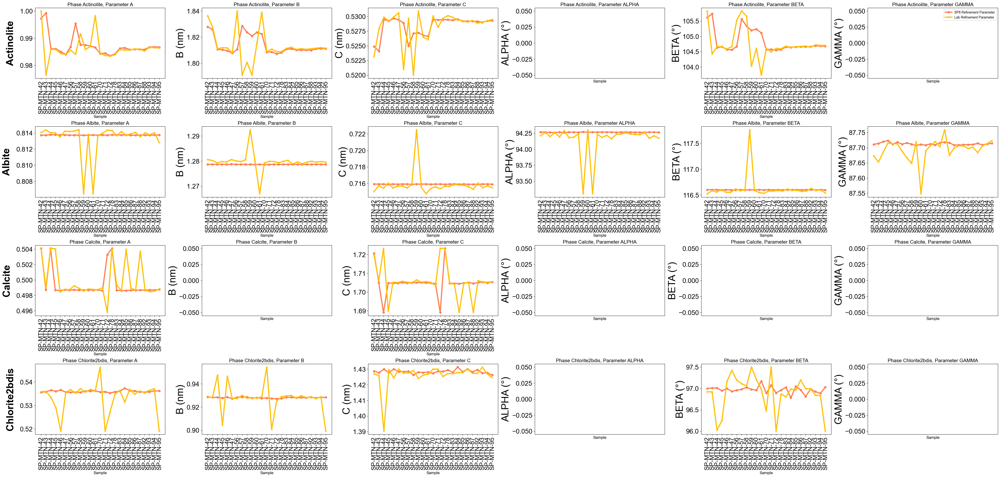

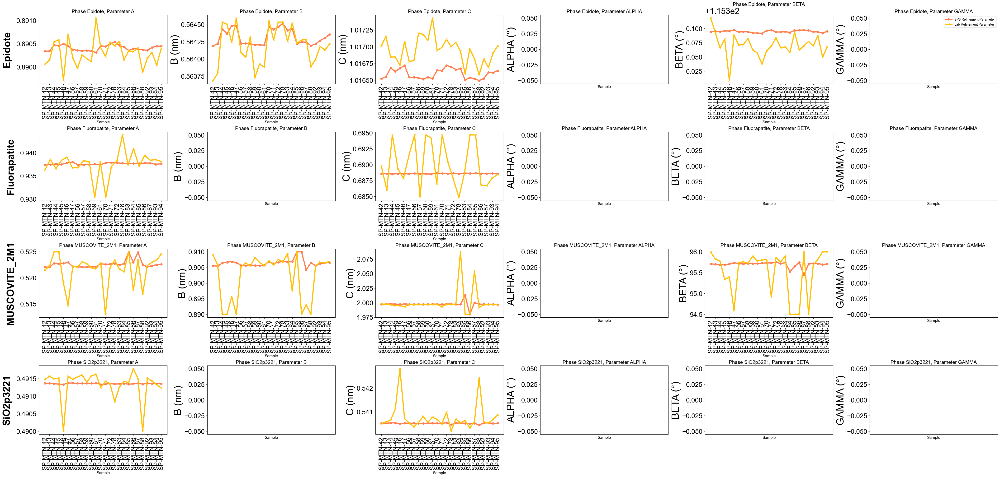

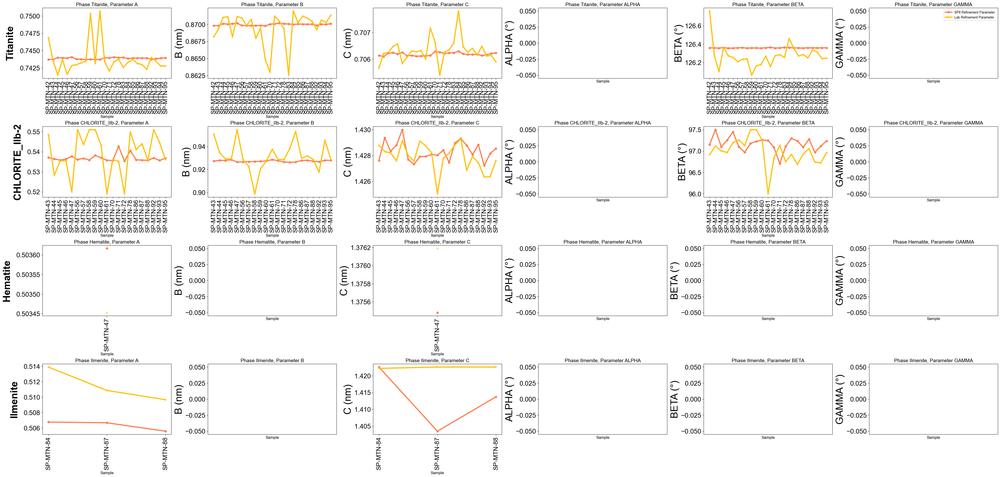

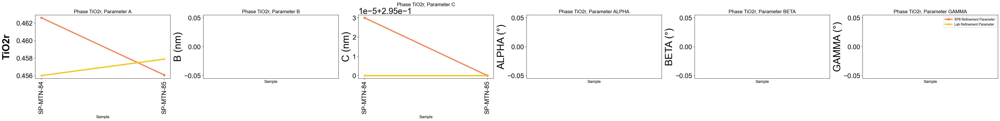

In [37]:
'''
分割した表示
'''

# データコピーと欠損値削除
df = Mafic_compiled_data_Param.copy().dropna()

# Phases と Parameters
phases = df['Phase'].unique()
params = ['A', 'B', 'C', 'ALPHA', 'BETA', 'GAMMA']
lattice_angle = params[3:]

# Define number of rows per figure
rows_per_figure = 4

# Split phases into chunks
phase_chunks = [phases[i:i + rows_per_figure] for i in range(0, len(phases), rows_per_figure)]

# Iterate over chunks of phases
for chunk_index, phase_chunk in enumerate(phase_chunks):
    fig, axes = plt.subplots(nrows=len(phase_chunk), ncols=len(params), 
                             figsize=(7 * len(params), 5 * len(phase_chunk)), constrained_layout=True)

    # Ensure axes are 2D for consistent indexing
    if len(phase_chunk) == 1:
        axes = [axes]

    for i, phase in enumerate(phase_chunk):
        for j, param in enumerate(params):
            phase_param_data = df[(df['Phase'] == phase) & (df['Param'] == param)]

            # Plot SP8 Refinement Parameter
            axes[i][j].plot(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), 
                            color='#FF7F50', marker='o', label='SP8 Refinement Parameter', linewidth=3.5)

            # Plot Lab Refinement Parameter
            axes[i][j].plot(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), 
                            color='#FFC107', marker='x', label='Lab Refinement Parameter', linewidth=3.5)

            axes[i][j].set_title(f'Phase {phase}, Parameter {param}', fontsize=15)
            axes[i][j].set_xlabel('Sample', fontsize=12)

            if param in lattice_angle:
                axes[i][j].set_ylabel(f'{param} (\u00b0)', fontsize=30)
            else:
                axes[i][j].set_ylabel(f'{param} (nm)', fontsize=30)

            axes[i][j].set_xticks(range(len(phase_param_data['Sample'])))
            axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=19)
            axes[i][j].tick_params(axis='y', labelsize=20)

            # Add legend only to the top-right plot in each figure
            if i == 0 and j == len(params) - 1:
                axes[i][j].legend(fontsize=10)
        # Add phase label to the left of each row
        axes[i][0].set_ylabel(f'{phase}', fontsize=30, labelpad=15, weight="bold")

    # Save each figure separately
    plt.savefig(folder_figure_path + f'XRD_lattice_constant/ALL_Mafic_part_{chunk_index + 1}.pdf', bbox_inches='tight')
    plt.show()


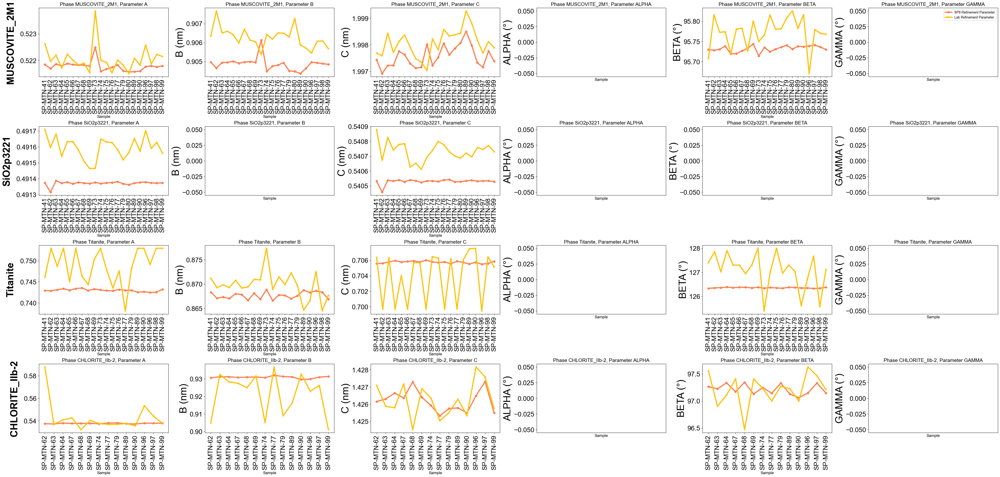

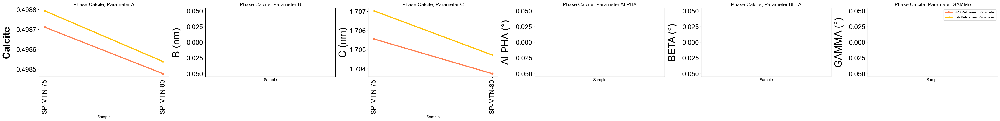

In [38]:
'''
分割した表示
'''

# データコピーと欠損値削除
df = Pelitic_compiled_data_Param.copy().dropna()

# Phases と Parameters
phases = df['Phase'].unique()
params = ['A', 'B', 'C', 'ALPHA', 'BETA', 'GAMMA']
lattice_angle = params[3:]

# Define number of rows per figure
rows_per_figure = 4

# Split phases into chunks
phase_chunks = [phases[i:i + rows_per_figure] for i in range(0, len(phases), rows_per_figure)]

# Iterate over chunks of phases
for chunk_index, phase_chunk in enumerate(phase_chunks):
    fig, axes = plt.subplots(nrows=len(phase_chunk), ncols=len(params), 
                             figsize=(7 * len(params), 5 * len(phase_chunk)), constrained_layout=True)

    # Ensure axes are 2D for consistent indexing
    if len(phase_chunk) == 1:
        axes = [axes]

    for i, phase in enumerate(phase_chunk):
        for j, param in enumerate(params):
            phase_param_data = df[(df['Phase'] == phase) & (df['Param'] == param)]

            # Plot SP8 Refinement Parameter
            axes[i][j].plot(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), 
                            color='#FF7F50', marker='o', label='SP8 Refinement Parameter', linewidth=3.5)

            # Plot Lab Refinement Parameter
            axes[i][j].plot(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), 
                            color='#FFC107', marker='x', label='Lab Refinement Parameter', linewidth=3.5)

            axes[i][j].set_title(f'Phase {phase}, Parameter {param}', fontsize=15)
            axes[i][j].set_xlabel('Sample', fontsize=12)

            if param in lattice_angle:
                axes[i][j].set_ylabel(f'{param} (\u00b0)', fontsize=30)
            else:
                axes[i][j].set_ylabel(f'{param} (nm)', fontsize=30)

            axes[i][j].set_xticks(range(len(phase_param_data['Sample'])))
            axes[i][j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=20)
            axes[i][j].tick_params(axis='y', labelsize=20)

            # Add legend only to the top-right plot in each figure
            if i == 0 and j == len(params) - 1:
                axes[i][j].legend(fontsize=10)
        # Add phase label to the left of each row
        axes[i][0].set_ylabel(f'{phase}', fontsize=30, labelpad=15, weight="bold")

    # Save each figure separately
    plt.savefig(folder_figure_path + f'XRD_lattice_constant/ALL_Pelitic_part_{chunk_index + 1}.pdf', bbox_inches='tight')
    plt.show()


In [39]:
# 一部を抽出


/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2683212781.py:29: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2683212781.py:29: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2683212781.py:29: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2683212781.py:29: UserWarning: set_ticklabels() should only be

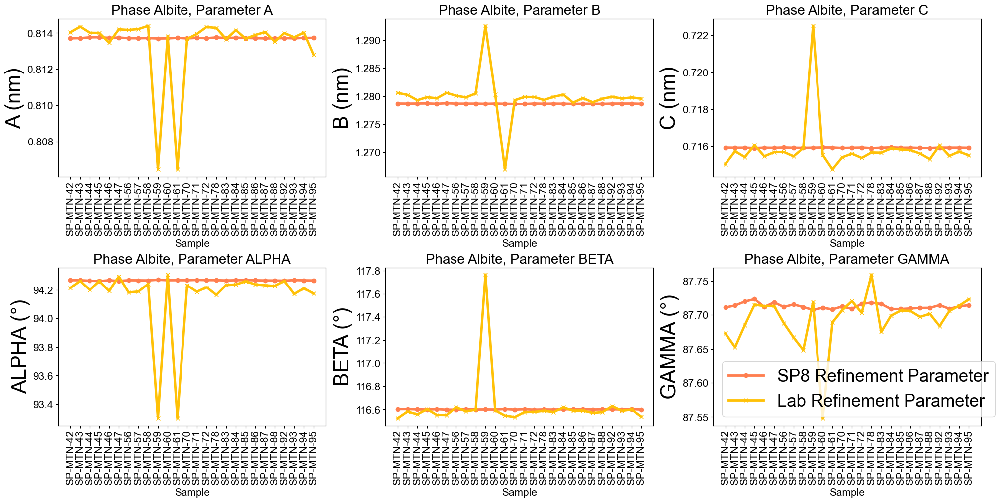

In [40]:
############################################################## Albiteのみ
df = Mafic_compiled_data_Param.copy().dropna()

# Filter the DataFrame for the "Albite" phase
albite_data = df[df['Phase'] == "Albite"]

# Creating a plot for each phase and parameter combination
params = ['A',  'B', 'C','ALPHA','BETA', 'GAMMA']

# Create a subplot with 3 columns and 2 rows
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 10), constrained_layout=True)

# Flatten the axes array for easy indexing
axes = axes.flatten()

# Loop through each parameter and plot the data
for j, param in enumerate(params):
    phase_param_data = albite_data[albite_data['Param'] == param]
    axes[j].plot(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), \
                 color='#FF7F50', marker='o', label='SP8 Refinement Parameter', linewidth=3.5)
    axes[j].plot(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), \
                 color='#FFC107', marker='x', label='Lab Refinement Parameter', linewidth=3.5)
    axes[j].set_title(f'Phase Albite, Parameter {param}', fontsize=20)
    axes[j].set_xlabel('Sample', fontsize=15)
    if param in lattice_angle:
        axes[j].set_ylabel(f'{param} (°)', fontsize=30)
    else:
        axes[j].set_ylabel(f'{param} (nm)', fontsize=30)
    axes[j].set_xticklabels(phase_param_data['Sample'], rotation=90, fontsize=15)
    axes[j].tick_params(axis='y', labelsize=15)
    if j == len(params) - 1:
        axes[j].legend()

# Hide any unused subplots
for k in range(len(params), len(axes)):
    fig.delaxes(axes[k])

plt.savefig(folder_figure_path + 'XRD_lattice_constant/Mafic_Albite_Phase.pdf', bbox_inches='tight')
plt.show()
############################################################## Albiteのみ


In [41]:
#name_d = phase_param_data['Sample'].str.split("-").str[1] + "-" + phase_param_data['Sample'].str.split("-").str[2]
#name_d


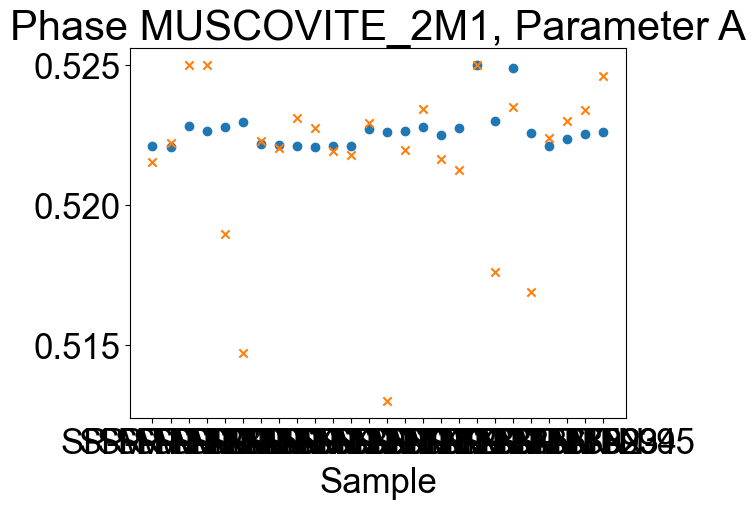

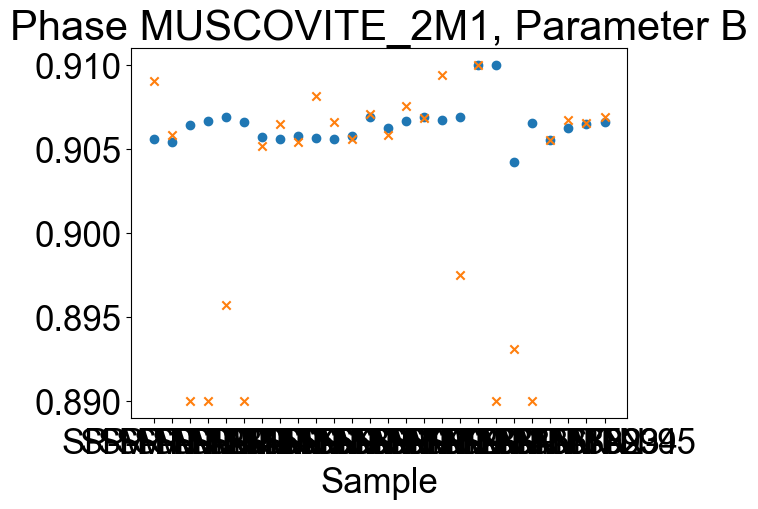

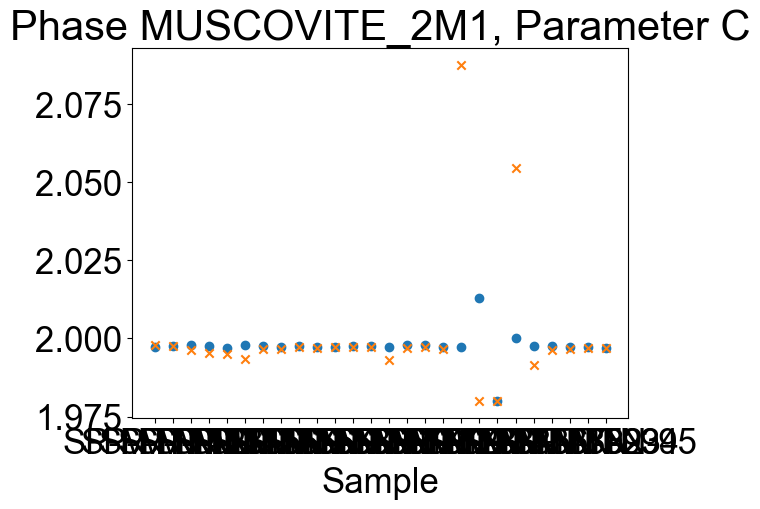

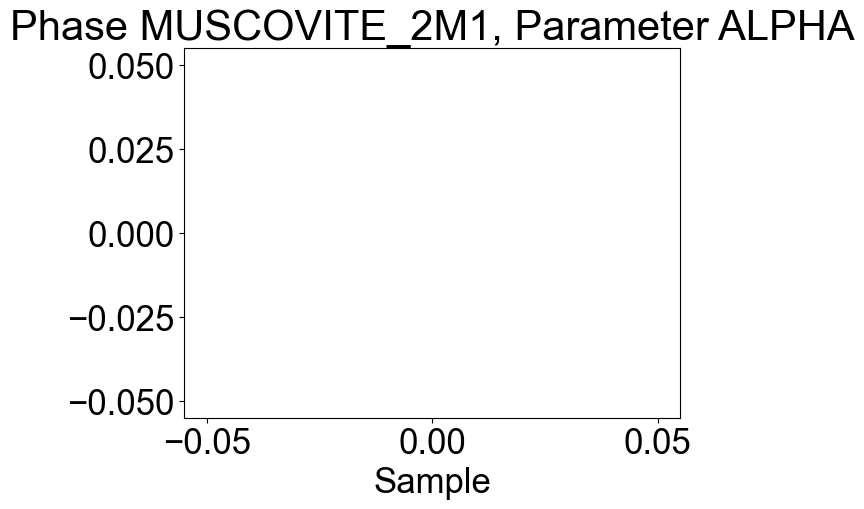

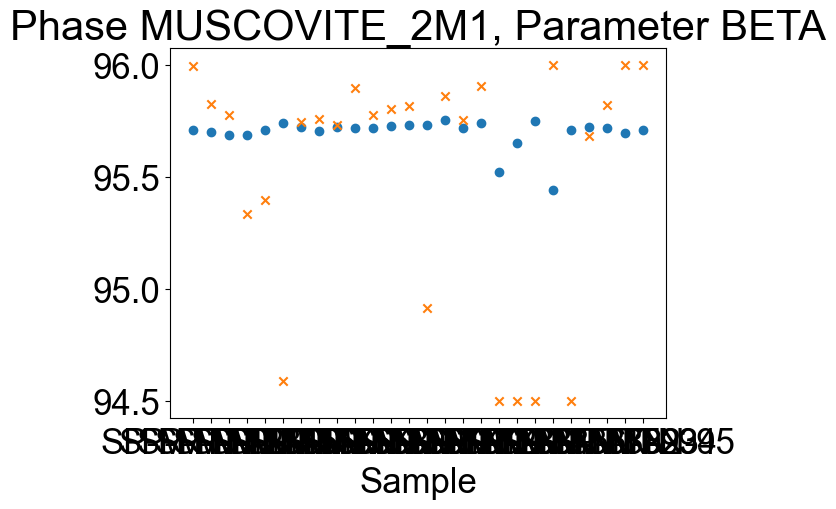

...

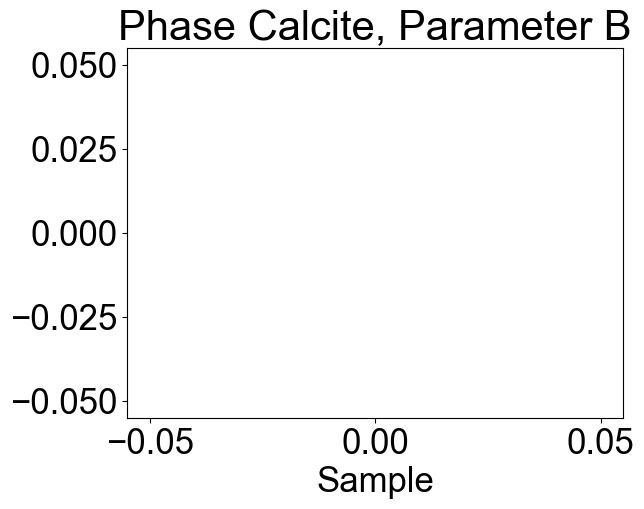

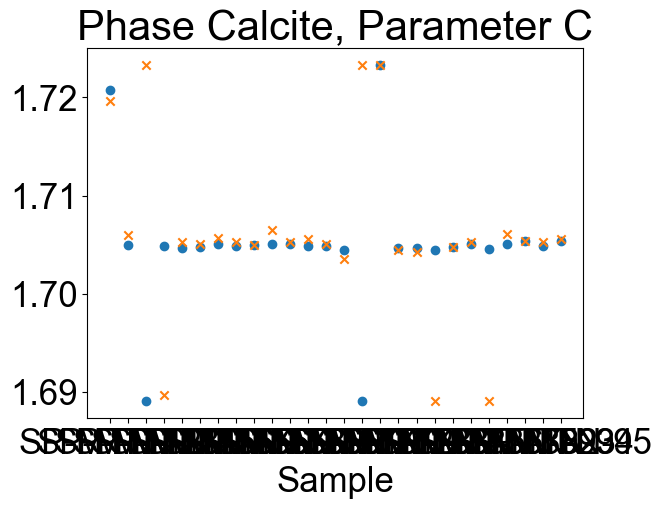

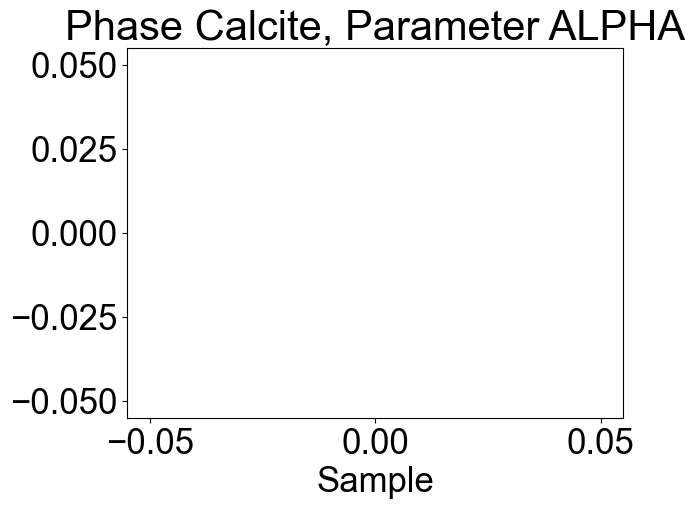

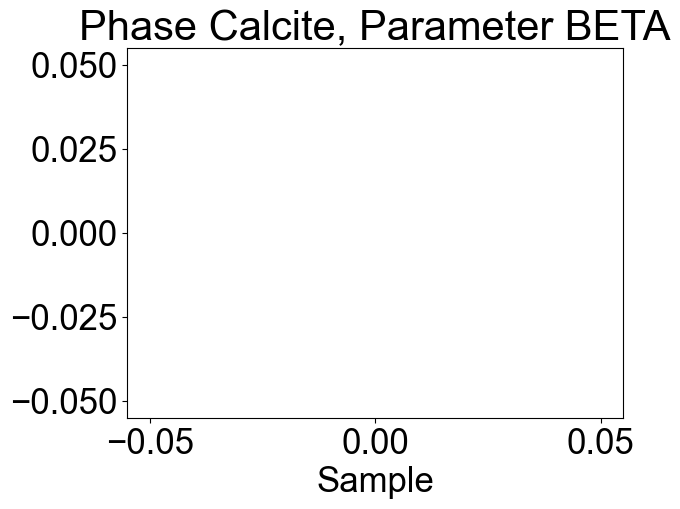

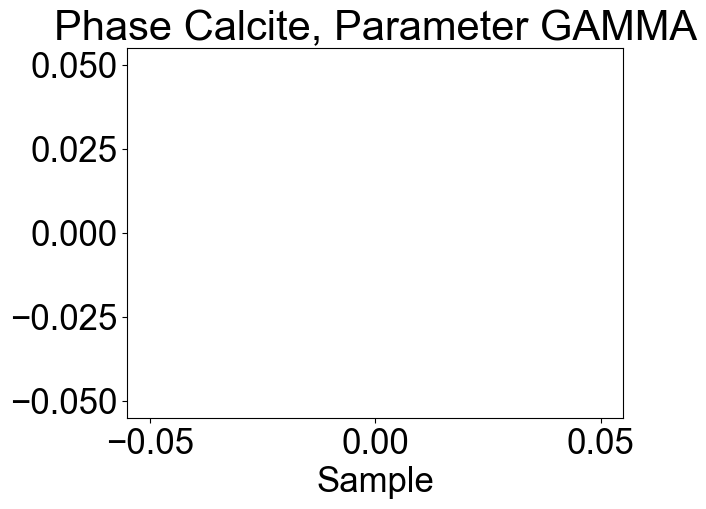

In [42]:
for i, phase in enumerate(phases):
    for j, param in enumerate(params):
        phase_param_data = df[(df['Phase'] == phase) & (df['Param'] == param)]
        plt.scatter(phase_param_data['Sample'], phase_param_data['SP8 Refinement Parameter'].astype(float), marker='o', label='SP8 Refinement Parameter')
        plt.scatter(phase_param_data['Sample'], phase_param_data['Lab Refinement Parameter'].astype(float), marker='x', label='Lab Refinement Parameter')
        plt.title(f'Phase {phase}, Parameter {param}')
        plt.xlabel('Sample')
        plt.show()


# 4. Error visualization

In [43]:
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt

def plot_by_rock_type_subplot(merged_data, rock_types, folder_path, ylim=None):
    n_types = len(rock_types)
    fig, axs = plt.subplots(n_types, 1, figsize=(10, 6 * n_types))
    fig.suptitle('Combined SP-8 and Laboratory Instrument Measurements by Rock Type', fontsize=16)
    
    for i, rock_type in enumerate(rock_types):
        data = merged_data[merged_data['Rock_Type_sp8_x'] == rock_type]
        x_labels = data['SP-8'].tolist()
        
        axs[i].plot(x_labels, data['Rwp_sp8'], marker='o', linestyle='-', color='b', label=r'$R_{\text{wp}}$ (SR-PXRD)')
        axs[i].plot(x_labels, data['Rwp_lab'], marker='o', linestyle='--', color='b', label=r'$R_{\text{wp}}$ (LAB-PXRD)')
        
        axs[i].plot(x_labels, data['Rexp_sp8'], marker='o', linestyle='-', color='r', label=r'$R_{\text{exp}}$ (SR-PXRD)')
        axs[i].plot(x_labels, data['Rexp_lab'], marker='o', linestyle='--', color='r', label=r'$R_{\text{exp}}$ (LAB-PXRD)')
        
        axs[i].plot(x_labels, data['GOF_sp8'], marker='o', linestyle='-', color='m', label='GOF (SR-PXRD)')
        axs[i].plot(x_labels, data['GOF_lab'], marker='o', linestyle='--', color='m', label='GOF (LAB-PXRD)')
        
        axs[i].set_ylabel('Value', fontsize=25)
        axs[i].grid(True)
        axs[i].tick_params(axis='x', rotation=90, labelsize=15)
        axs[i].tick_params(axis='y', labelsize=15)
        axs[i].set_title(f'{rock_type}', fontsize=20, pad=10)
        if ylim:
            axs[i].set_ylim(ylim)

    handles, labels = axs[-1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), frameon=False, fontsize=12)
    
    axs[-1].set_xlabel('Sample', fontsize=25, labelpad=10)
    plt.tight_layout(rect=[0, 0.03, 0.85, 0.95])
    plt.savefig(folder_path, bbox_inches='tight')
    plt.show()


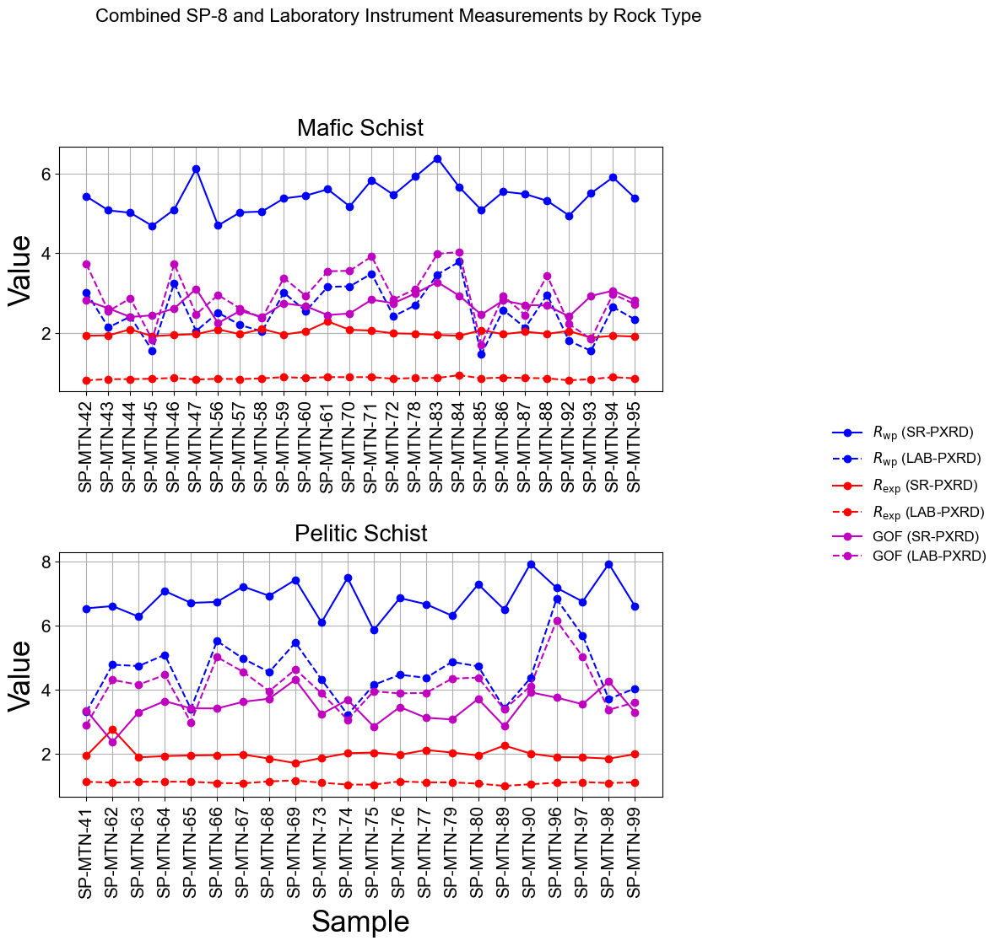

In [44]:
error_data_df = pd.read_excel(folder_path + "error_data_df.xlsx", index_col=0, header=0)
col_error = ['SP-8', 'Rock_Type_sp8_x','Rwp_sp8', 'Rexp_sp8', 'Chi2_sp8','GOF_sp8', 'Rwp_lab', 'Rexp_lab', 'Chi2_lab', 'GOF_lab']
error_data_df=error_data_df[col_error]

# Get unique Rock Types
rock_types = error_data_df['Rock_Type_sp8_x'].unique()

#ylim = [0, 20]
figure_path = folder_figure_path+f'Rietveld_Error/ALL.pdf'


# Plot combined data for SP-8 and Laboratory
plot_by_rock_type_subplot(error_data_df, rock_types, figure_path)


# 5. Error Evaluation based on XRF

In [45]:
def calculate_error_df(data_use, ref_col, target_col):
    data_ref = data_use[ref_col]
    data_target = data_use[target_col]
    
    data_use["Relative Error"] = (data_target - data_ref)/data_ref
    data_use["Relative Error100"] = data_use["Relative Error"]*100
    data_use["abs(Relative Error)"] = np.abs(data_target - data_ref)/data_ref
    data_use["Absolute Error"] = np.abs(data_target - data_ref)
    data_use["Squared Error"] = (data_target - data_ref)**2


    compile_metrix = pd.DataFrame(columns=data_use.oxides.unique())
    for ox in data_use.oxides.unique():
        filtered_data = data_use[data_use["oxides"] == ox]
        n=filtered_data.shape[0]
    
        mse = filtered_data["Squared Error"].sum() / n
        mae = filtered_data["Absolute Error"].sum() / n
        rmse = np.sqrt(mse)
    
        metrics = {
            "MSE": mse,
            "MAE": mae,
            "RMSE": rmse,
        }
        compile_metrix[ox] = metrics
        
    compile_metrix = compile_metrix.melt(ignore_index=False).reset_index()
    
    return data_use, compile_metrix

############################################################################ Data
list_oxides = ["SiO2", "TiO2", "Al2O3", "Fe2O3", "MnO", "MgO", "CaO", "Na2O", "K2O", 'P2O5']
latex_oxides = [to_latex(label) for label in list_oxides]

data_XRD_list = [df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile[df_volume_XRF_melt_compile["INDEX"].isin(Pelitic_INDEX)].copy()]
data_EPMA_list = [df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Mafic_INDEX)].copy(),\
             df_volume_XRF_melt_compile_EPMA[df_volume_XRF_melt_compile_EPMA["INDEX"].isin(Pelitic_INDEX)].copy()]
############################################################################ Data


############################################################################ Compile Mafic
# SP8
data_use = data_XRD_list[0].copy()
ref_col = "XRF"
target_col = "XRD_SP8"
data_SP_error, SP_M_metrix = calculate_error_df(data_use, ref_col, target_col)
data_SP_error["Instrument"] = "SR-PXRD"
SP_M_metrix["Instrument"] = "SR-PXRD"

# LAB
data_use = data_XRD_list[0].copy()
ref_col = "XRF"
target_col = "XRD_LAB"
data_LAB_error, LAB_M_metrix = calculate_error_df(data_use, ref_col, target_col)
data_LAB_error["Instrument"] = "LAB-PXRD"
LAB_M_metrix["Instrument"] = "LAB-PXRD"

# EPMA
data_use = data_EPMA_list[0].copy()
ref_col = "XRF"
target_col = "EPMA"
data_EPMA_error, EPMA_M_metrix = calculate_error_df(data_use, ref_col, target_col)
data_EPMA_error["Instrument"] = "EPMA"
EPMA_M_metrix["Instrument"] = "EPMA"

Mafic_compiled_data_error = pd.concat([data_SP_error, data_LAB_error, data_EPMA_error])
Mafic_compiled_data_metrix = pd.concat([SP_M_metrix, LAB_M_metrix, EPMA_M_metrix])

Mafic_compiled_data_error["Rock type"] = "Mafic"
Mafic_compiled_data_error["Rock type"] = "Mafic"

############################################################################ Compile Mafic

############################################################################ Compile Pelitic
# SP8
data_use = data_XRD_list[1].copy()
ref_col = "XRF"
target_col = "XRD_SP8"
data_SP_error, SP_P_metrix = calculate_error_df(data_use, ref_col, target_col)
data_SP_error["Instrument"] = "SR-PXRD"
SP_P_metrix["Instrument"] = "SR-PXRD"

# LAB
data_use = data_XRD_list[1].copy()
ref_col = "XRF"
target_col = "XRD_LAB"
data_LAB_error, LAB_P_metrix = calculate_error_df(data_use, ref_col, target_col)
data_LAB_error["Instrument"] = "LAB-PXRD"
LAB_P_metrix["Instrument"] = "LAB-PXRD"

# EPMA
data_use = data_EPMA_list[1].copy()
ref_col = "XRF"
target_col = "EPMA"
data_EPMA_error, EPMA_P_metrix = calculate_error_df(data_use, ref_col, target_col)
data_EPMA_error["Instrument"] = "EPMA"
EPMA_P_metrix["Instrument"] = "EPMA"

Pelitic_compiled_data_error = pd.concat([data_SP_error, data_LAB_error, data_EPMA_error])
Pelitic_compiled_data_metrix = pd.concat([SP_P_metrix, LAB_P_metrix, EPMA_P_metrix])

Pelitic_compiled_data_error["Rock type"] = "Pelitic"
Pelitic_compiled_data_metrix["Rock type"] = "Pelitic"
############################################################################ Compile Pelitic
compiled_data_error = pd.concat([Pelitic_compiled_data_error, Mafic_compiled_data_error])
compiled_data_metrix = pd.concat([Pelitic_compiled_data_metrix, Mafic_compiled_data_metrix])


data_error_list = [Mafic_compiled_data_error, Pelitic_compiled_data_error, compiled_data_error]
data_matrix_list = [Mafic_compiled_data_metrix, Pelitic_compiled_data_metrix, compiled_data_metrix]
data_name_list = ["mafic", "pelitic", "All"]
Instrument_list = ["SR-PXRD", "LAB-PXRD", "EPMA"]
Instrument_c_list = ['#FF7F50', '#FFC107', '#9d5b8b']

rocktype_list = ["Mafic", "Pelitic"]
rocktype_symbol_list = ["o", "^"]


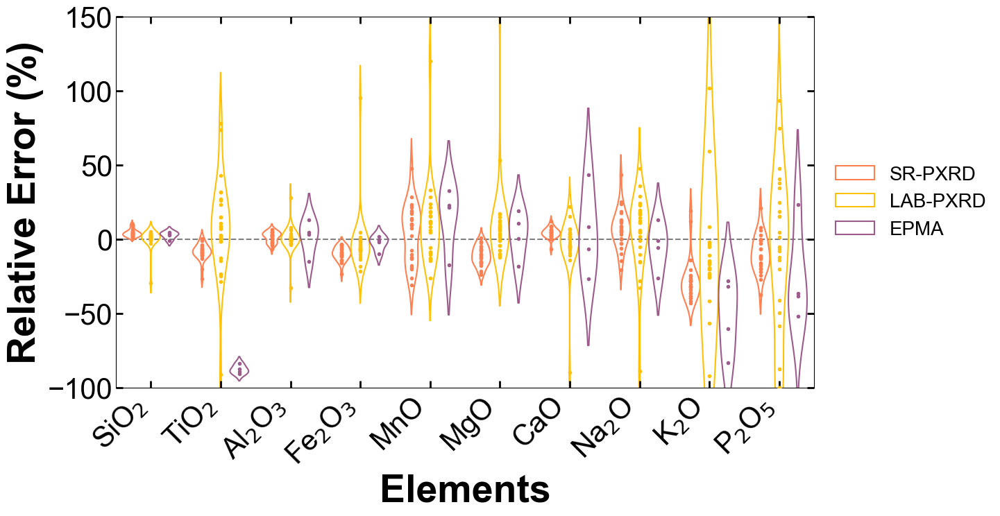

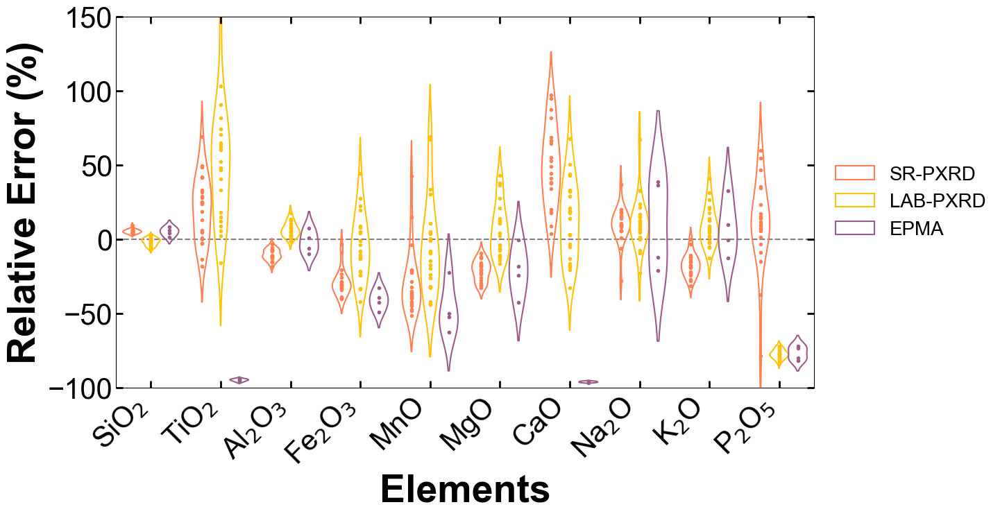

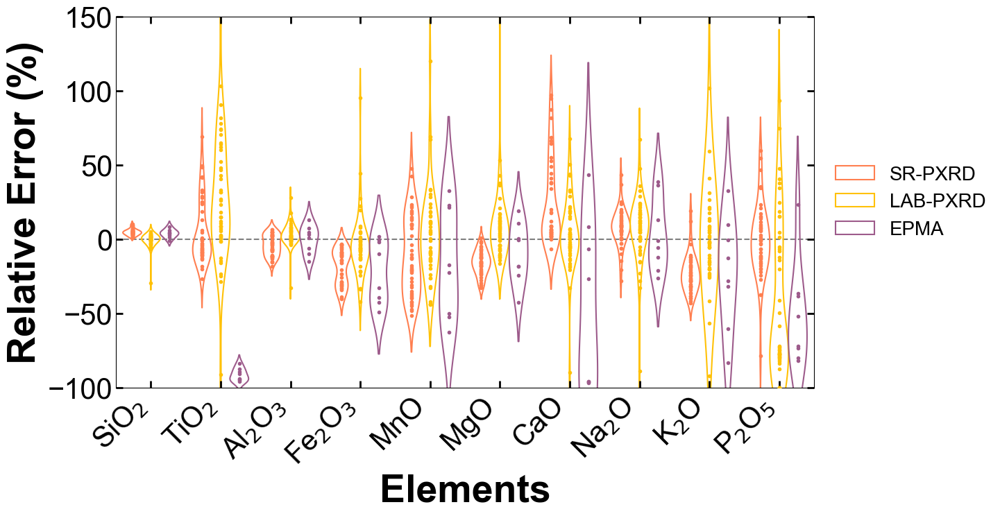

In [46]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
    sns.violinplot(data=data_error_list[num], x="oxides", y="Relative Error100", hue="Instrument", density_norm='width', fill=False, inner="point",\
                   order=list_oxides, palette=Instrument_c_list)
    
    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) # 可視化のために色を赤に、点線にする。
    plt.ylim(-100, 150)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    tick_positions = plt.gca().get_xticks()
    plt.xticks(ticks=tick_positions, labels=latex_oxides)
    plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("Elements", fontsize=40, weight="bold")
    plt.ylabel("Relative Error (%)", fontsize=40, weight="bold")
    plt.legend(bbox_to_anchor=(1.02, 0.5), loc='center left', borderaxespad=0, fontsize=20, frameon=False)
    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_violin.pdf', )
    plt.show()


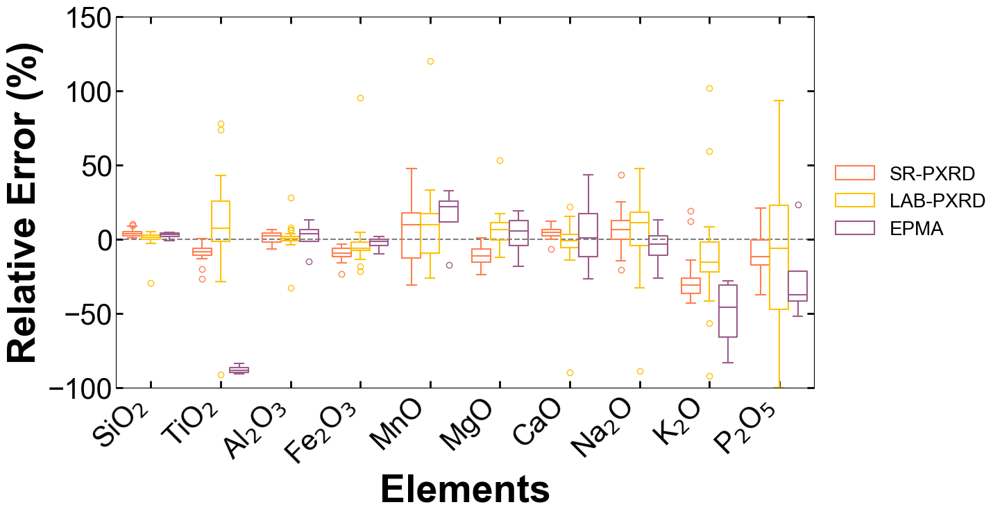

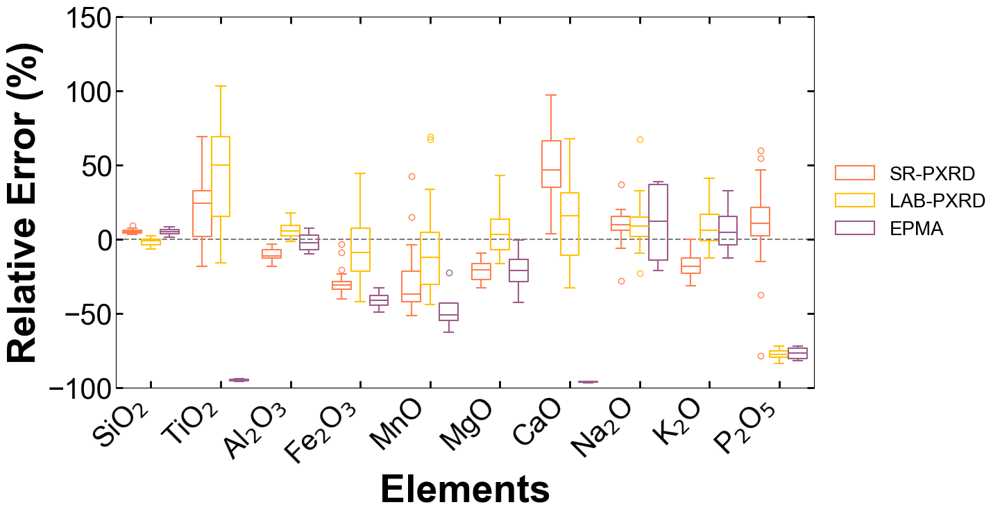

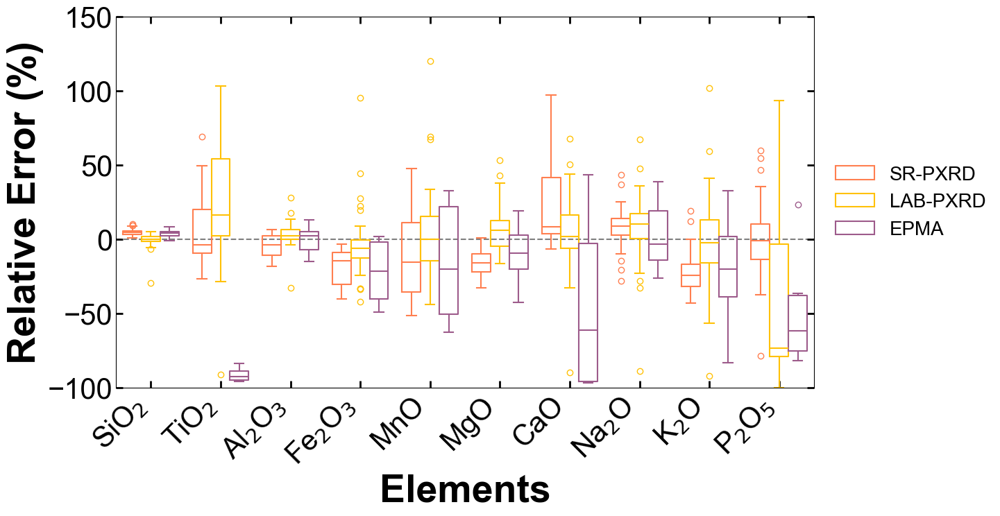

In [47]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
    sns.boxplot(data=data_error_list[num], x="oxides", y="Relative Error100", hue="Instrument", fill=False, order=list_oxides, palette=Instrument_c_list)
    
    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) # 可視化のために色を赤に、点線にする。
    plt.ylim(-100, 150)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    tick_positions = plt.gca().get_xticks()
    plt.xticks(ticks=tick_positions, labels=latex_oxides)
    plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("Elements", fontsize=40, weight="bold")
    plt.ylabel("Relative Error (%)", fontsize=40, weight="bold")
    plt.legend(bbox_to_anchor=(1.02, 0.5), loc='center left', borderaxespad=0, fontsize=20, frameon=False)
    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_box.pdf', )
    plt.show()


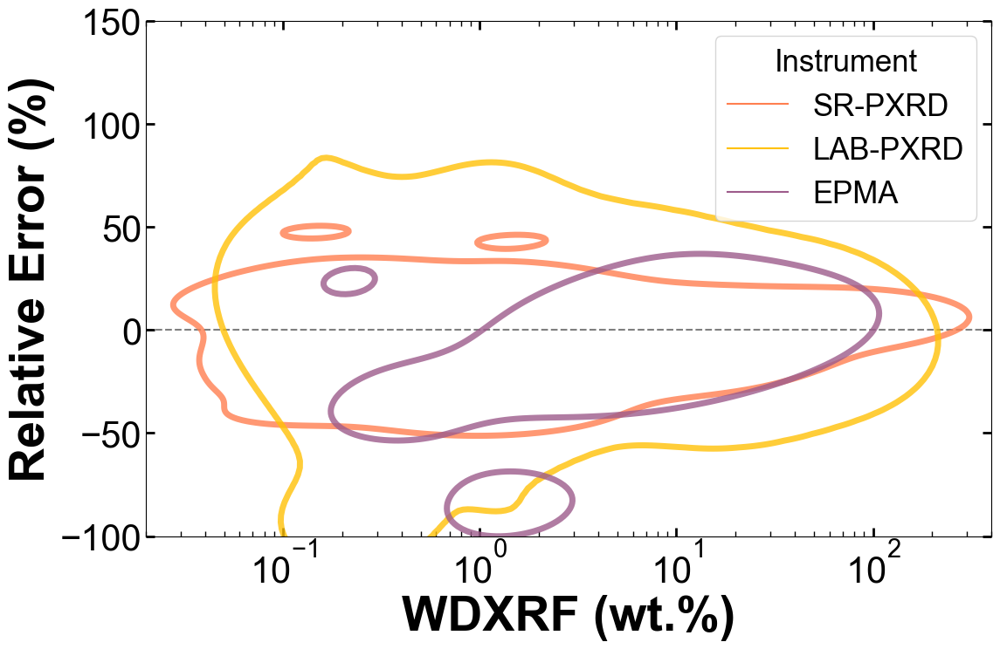

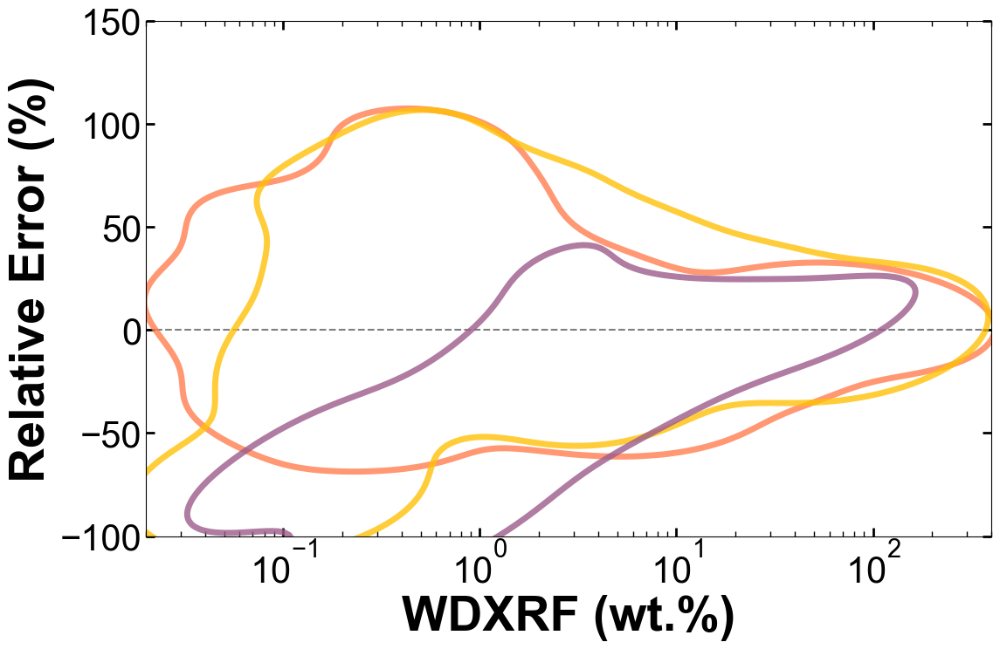

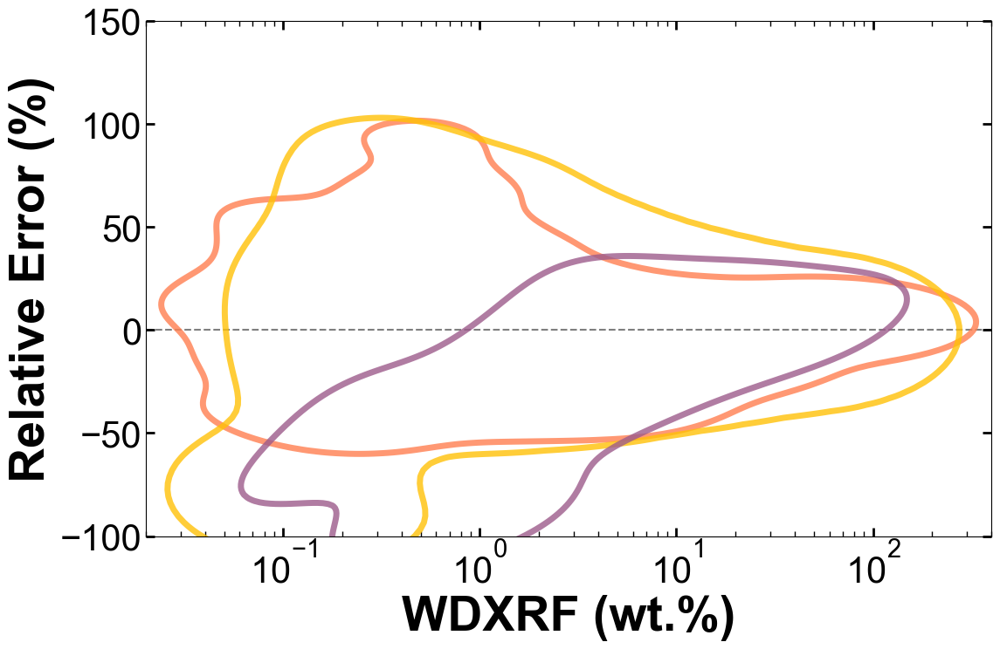

In [48]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(12, 8)) #必要に応じてfigsizeを変更してください
    if num==0:
        legend_flag=True
    else:
        legend_flag=False
    sns.kdeplot(
                data=data_error_list[num], x="XRF", y="Relative Error100", hue="Instrument", hue_order=Instrument_list, 
                levels = 2, linestyles='-', linewidths=5, alpha=0.8,\
                log_scale=[True, False],  fill=False, legend=legend_flag, palette=Instrument_c_list
               )

    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) 
    plt.xlim(0.02, 400)
    plt.ylim(-100, 150)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    #tick_positions = plt.gca().get_xticks()
    #plt.xticks(ticks=tick_positions, labels=latex_oxides)
    #plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("WDXRF (wt.%)", fontsize=40, weight="bold")
    plt.ylabel("Relative Error (%)", fontsize=40, weight="bold")

    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_kde.pdf', )
    plt.show()


/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/1774173235.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\


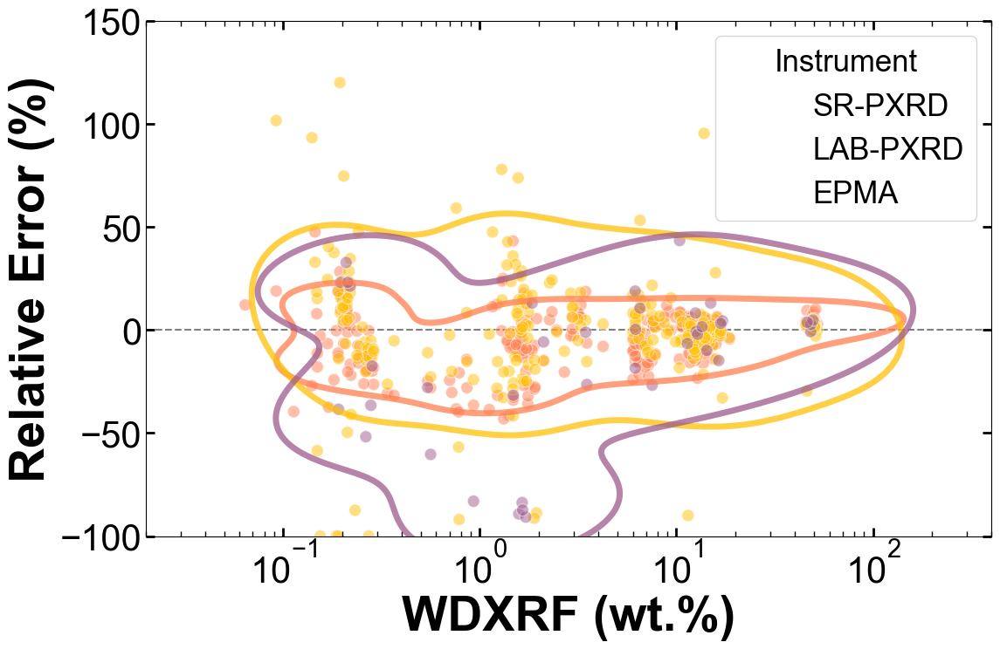

/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/1774173235.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\


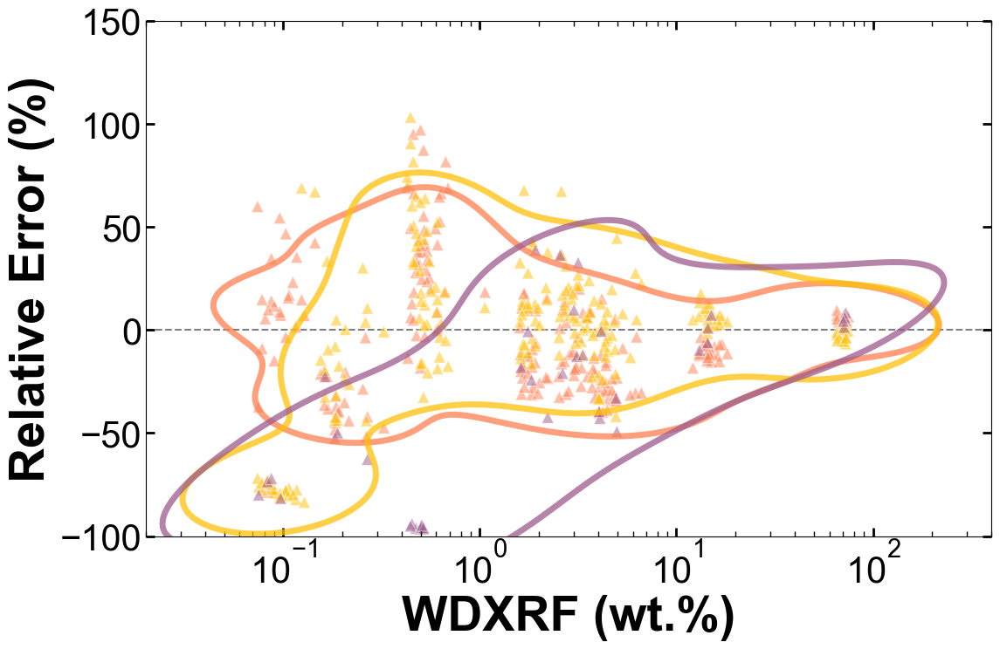

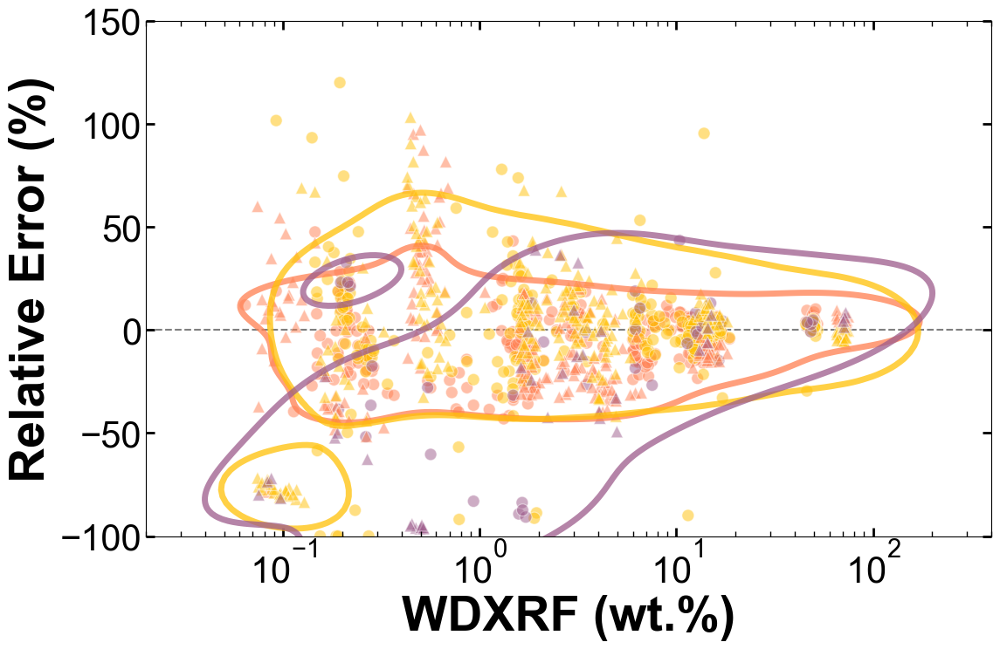

In [49]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(12, 8)) #必要に応じてfigsizeを変更してください
    if num==0:
        legend_flag=True
    else:
        legend_flag=False
    # kdeplot
    sns.kdeplot(
                data=data_error_list[num], x="XRF", y="Relative Error100", hue="Instrument", hue_order=Instrument_list, 
                levels = 1, cut=3, thresh=0.17, linestyles='-', linewidths=5, alpha=0.75,\
                log_scale=[True, False], common_grid=True, common_norm=False, fill=False, legend=legend_flag, palette=Instrument_c_list, zorder=4
               ) 
    # scatterplot
    for rocktype, marker in zip(rocktype_list, rocktype_symbol_list): 
            subset_data = data_error_list[num][data_error_list[num]["Rock type"]==rocktype]
            sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\
                            s=100, alpha=0.5, legend=legend_flag, zorder=1, #marker=marker, # マーカーの順番を明示的に指定
                            marker=marker, hue_order=Instrument_list, palette=Instrument_c_list,\
                            facecolors="none"
                           )
    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) 
    plt.xlim(0.02, 400)
    plt.ylim(-100, 150)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    #tick_positions = plt.gca().get_xticks()
    #plt.xticks(ticks=tick_positions, labels=latex_oxides)
    #plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("WDXRF (wt.%)", fontsize=40, weight="bold")
    plt.ylabel("Relative Error (%)", fontsize=40, weight="bold")

    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_kde_scatter.pdf', )
    plt.show()


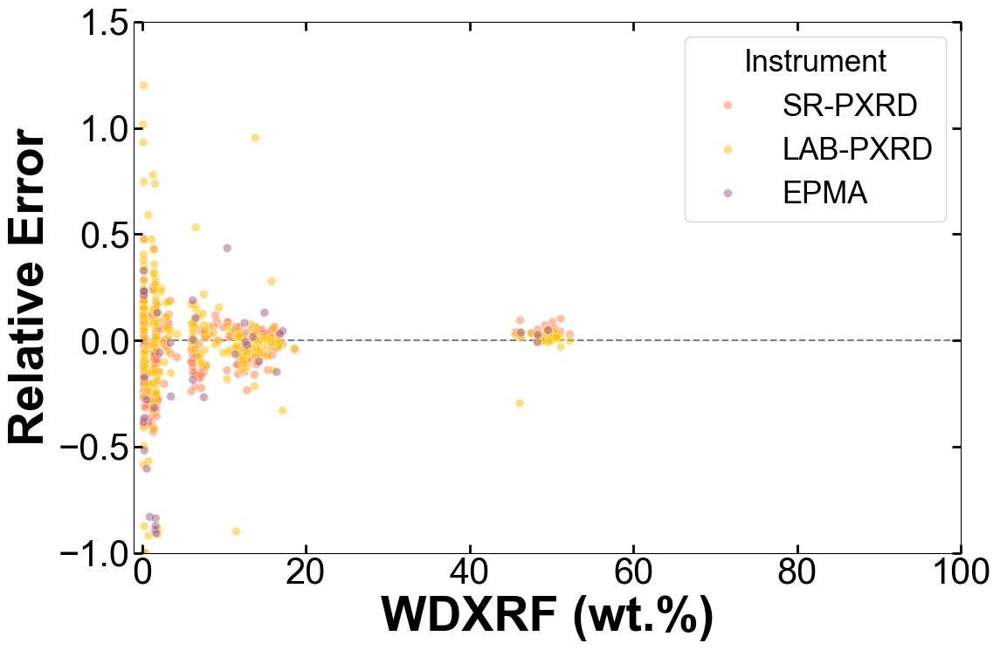

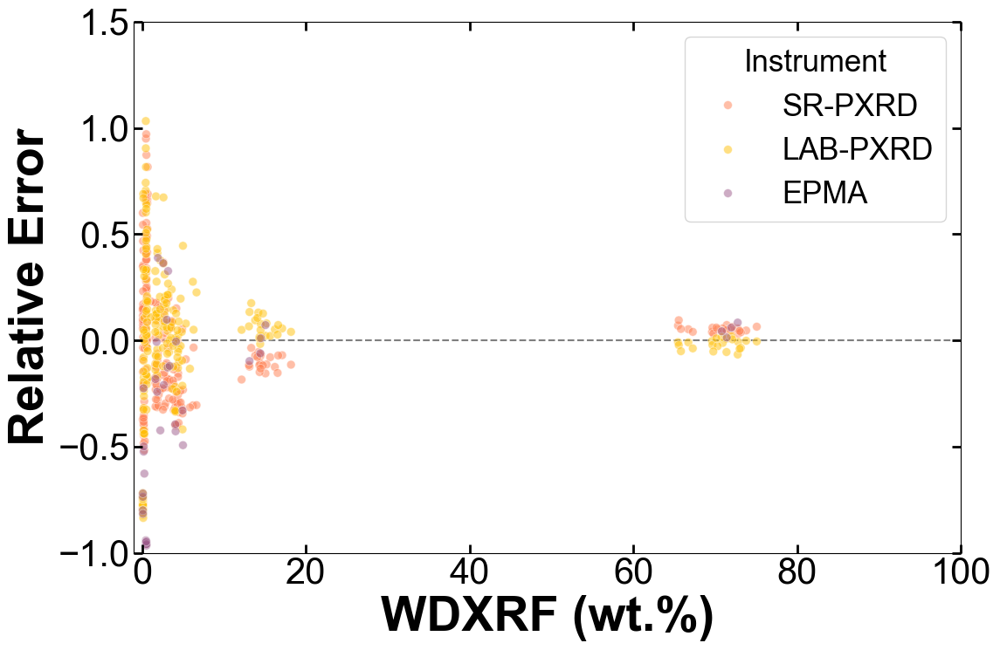

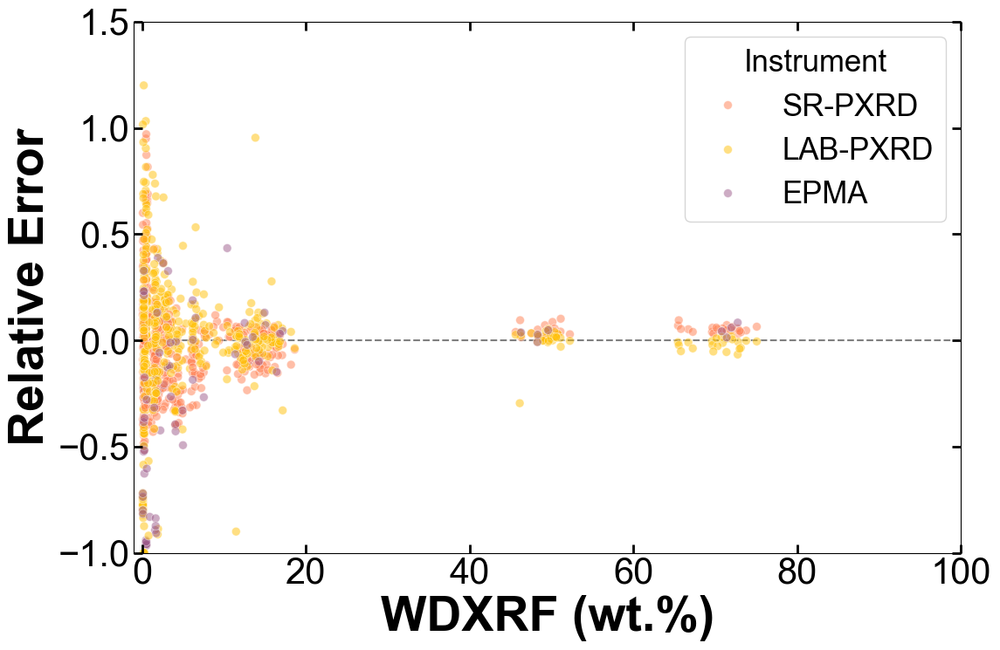

In [50]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(12, 8)) #必要に応じてfigsizeを変更してください
    if num==0:
        legend_flag=True
    else:
        legend_flag=False

    sns.scatterplot(data=data_error_list[num], x="XRF", y="Relative Error", hue="Instrument",\
                    hue_order=Instrument_list, palette=Instrument_c_list, s=50, alpha=0.5, )

    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) 
    plt.xlim(-1, 100)
    plt.ylim(-1, 1.5)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    #tick_positions = plt.gca().get_xticks()
    #plt.xticks(ticks=tick_positions, labels=latex_oxides)
    #plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("WDXRF (wt.%)", fontsize=40, weight="bold")
    plt.ylabel("Relative Error", fontsize=40, weight="bold")

    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_kde_scatter.pdf', )
    plt.show()


/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2585025482.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\


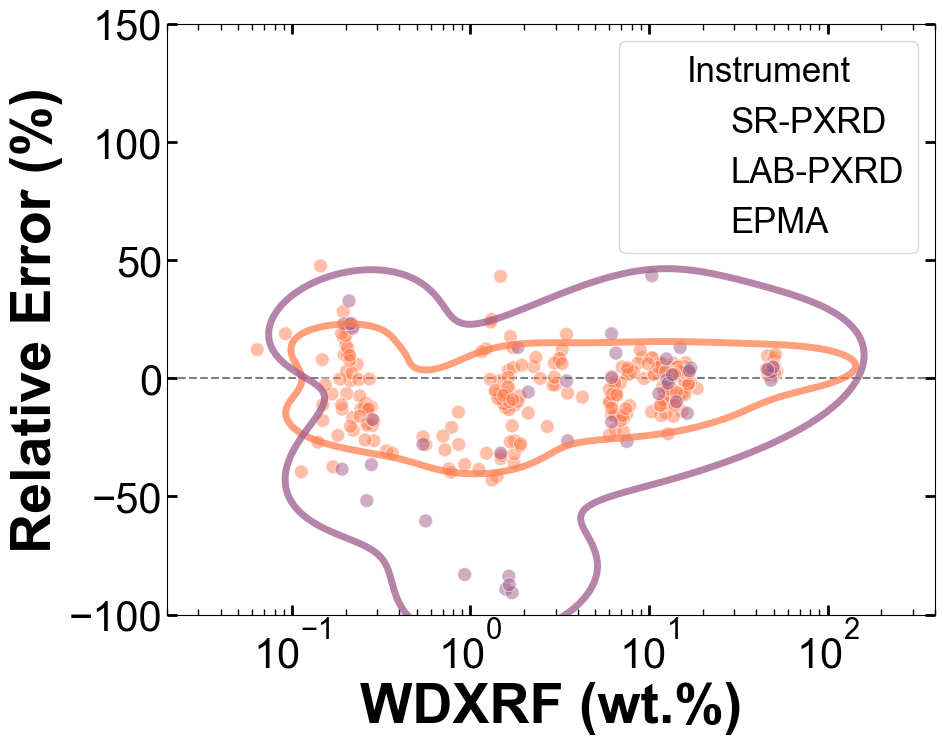

/var/folders/h8/5bzln_s513n0w_fc4k78vt9h0000gn/T/ipykernel_53371/2585025482.py:17: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\


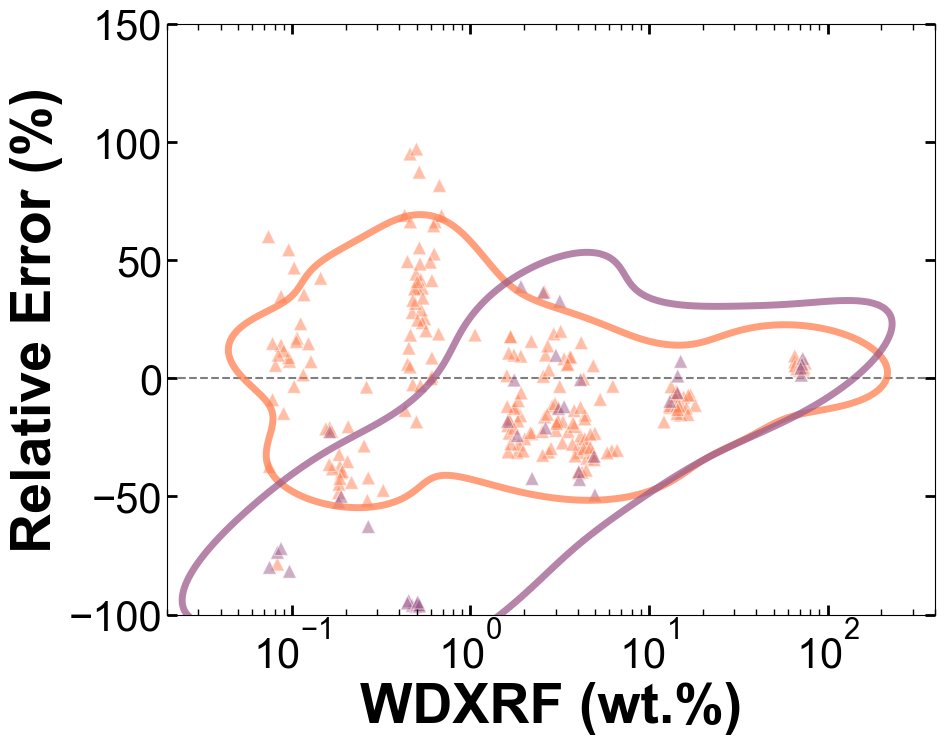

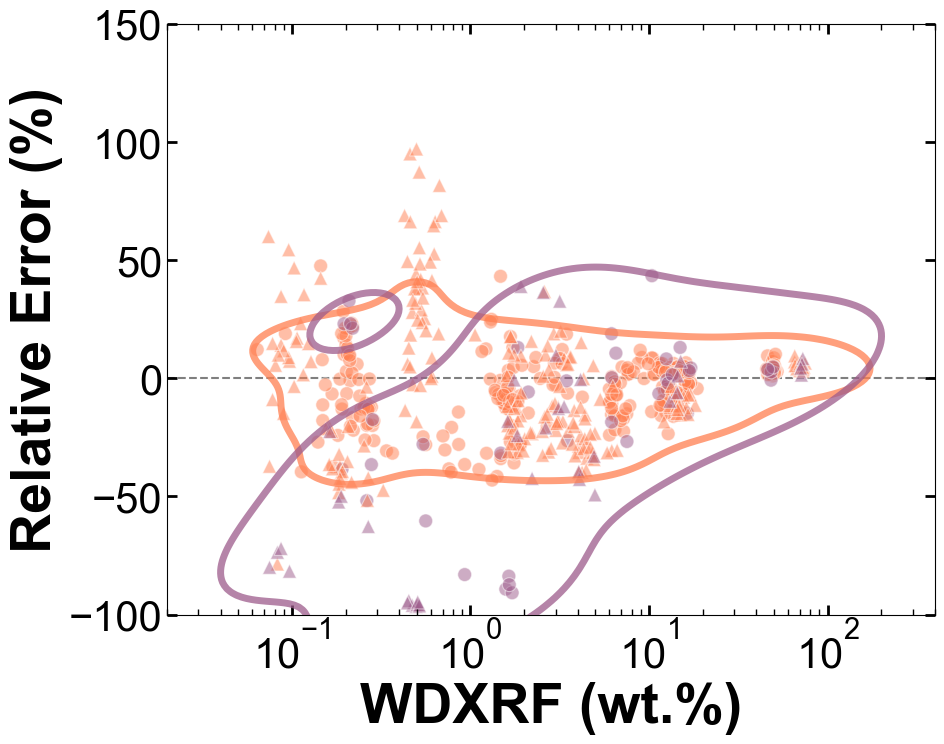

In [51]:
for num, (name, color) in enumerate(zip(data_name_list, Instrument_c_list)):
    # バイオリンプロット
    plt.figure(figsize=(10, 8)) #必要に応じてfigsizeを変更してください
    if num==0:
        legend_flag=True
    else:
        legend_flag=False
    # kdeplot
    sns.kdeplot(
                data=data_error_list[num][data_error_list[num]["Instrument"]!="LAB-PXRD"], x="XRF", y="Relative Error100", hue="Instrument", hue_order=Instrument_list, 
                levels = 1, cut=3, thresh=0.17, linestyles='-', linewidths=5, alpha=0.75,\
                log_scale=[True, False], common_grid=True, common_norm=False, fill=False, legend=legend_flag, palette=Instrument_c_list, zorder=4
               ) 
    # scatterplot
    for rocktype, marker in zip(rocktype_list, rocktype_symbol_list): 
            subset_data = data_error_list[num][(data_error_list[num]["Rock type"]==rocktype)&(data_error_list[num]["Instrument"]!="LAB-PXRD")]
            sns.scatterplot(data=subset_data, x="XRF", y="Relative Error100", hue="Instrument",\
                            s=100, alpha=0.5, legend=legend_flag, zorder=1, #marker=marker, # マーカーの順番を明示的に指定
                            marker=marker, hue_order=Instrument_list, palette=Instrument_c_list,\
                            facecolors="none"
                           )
    # 水平線を追加
    plt.axhline(y=0, color='black', linestyle='--', zorder=0, alpha=0.5) 
    plt.xlim(0.02, 400)
    plt.ylim(-100, 150)
    
    ################ 調整
    plt.tick_params(which='both', direction='in', bottom=True, left=True, top=True, right=True, labelsize=30)
    plt.tick_params(which='major', length=7.5, width=2)
    plt.tick_params(which='minor', length=4, width=1)
    # 目盛りの位置を取得
    #tick_positions = plt.gca().get_xticks()
    #plt.xticks(ticks=tick_positions, labels=latex_oxides)
    #plt.xticks(rotation=45, ha="right")
    
    # label
    plt.xlabel("WDXRF (wt.%)", fontsize=40, weight="bold")
    plt.ylabel("Relative Error (%)", fontsize=40, weight="bold")

    ################ 調整
    
    plt.tight_layout() # レイアウト調整
    # ファイル保存
    plt.savefig(folder_figure_path + 'Mineral_Mode_Relative_Error/'+name+'_Relative_Error_kde_scatter_without_LAB.pdf', )
    plt.show()


In [52]:
# STOP
STOP


NameError: name 'STOP' is not defined

In [ ]:
# boxplot
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
sns.boxplot(data=compiled_data_error, x="oxides", y="Relative Error", hue="Instrument", fill=False)

# 水平線を追加
plt.axhline(y=0, color='r', linestyle='--') # 可視化のために色を赤に、点線にする。
plt.ylim(-1, 2)

plt.title("Absolute Error Comparison by Element and Instrument")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
# Bar plot using Seaborn
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed
data_plot = Mafic_compiled_data_metrix[Mafic_compiled_data_metrix["index"]=="RMSE"]
sns.barplot(data=data_plot, x="variable", y="value", hue="Instrument")


In [ ]:
# 'oxides' と 'Instrument' でグループ化し、'Relative Error' の標準偏差を計算
std_values = data_error_list[1].groupby(by=["oxides", "Instrument"])["Relative Error"].std().reset_index()
std_values = std_values.rename(columns={"Relative Error": "std"})

# グラフ描画
plt.figure(figsize=(14, 8))  # 少し大きめの図を設定
sns.barplot(x='oxides', y='std', hue='Instrument', data=std_values, palette='viridis', edgecolor='black')

# ラベルとタイトルを設定
plt.title('Standard Deviation of Relative Error by Oxides and Instrument', fontsize=16)
plt.xlabel('Oxides', fontsize=14)
plt.ylabel('Standard Deviation', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.legend(title='Instrument', fontsize=12)  # 凡例のタイトルを設定
plt.tight_layout()  # レイアウトを調整

plt.show()


In [ ]:
# バイオリンプロット
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
sns.violinplot(data=Mafic_compiled_data_error, x="oxides", y="Relative Error", hue="Instrument", density_norm='width', fill=False)

# 水平線を追加
plt.axhline(y=0, color='r', linestyle='--') # 可視化のために色を赤に、点線にする。

plt.title("Absolute Error Comparison by Element and Instrument")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
# バイオリンプロット
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
sns.violinplot(data=Pelitic_compiled_data_error, x="oxides", y="Relative Error", hue="Instrument", density_norm='width', fill=False)

# 水平線を追加
plt.axhline(y=0, color='r', linestyle='--') # 可視化のために色を赤に、点線にする。

plt.title("Absolute Error Comparison by Element and Instrument")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
# バイオリンプロット
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
sns.violinplot(data=compiled_data_error, x="oxides", y="Relative Error", hue="Instrument", density_norm='width', fill=False, inner="point")

# 水平線を追加
plt.axhline(y=0, color='r', linestyle='--') # 可視化のために色を赤に、点線にする。

plt.ylim(-1, 2)

plt.title("Absolute Error Comparison by Element and Instrument")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
# バイオリンプロット
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください
sns.boxplot(data=compiled_data_error, x="oxides", y="Relative Error", hue="Instrument", fill=False)

# 水平線を追加
plt.axhline(y=0, color='r', linestyle='--') # 可視化のために色を赤に、点線にする。
plt.ylim(-1, 2)

plt.title("Absolute Error Comparison by Element and Instrument")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(15, 8)) #必要に応じてfigsizeを変更してください

sns.scatterplot(data=compiled_data_error, x="XRF", y="abs(Relative Error)", hue="Instrument", )
plt.ylim(0,2)
plt.xlim(0,20)


In [ ]:
# oxides の値をユニークなリストとして取得
unique_oxides = compiled_data_error['oxides'].unique()

# 各 oxides に対応するマーカーを定義
markers = {oxide: marker for oxide, marker in zip(unique_oxides, ['o', 's', '^', 'v', '<', '>', '1', '2', '3', '4', 'p', 'P', '*','h','H','+','x', 'D','d'])} # 必要に応じて追加


# 散布図のプロット
plt.figure(figsize=(15, 8))
for oxide in unique_oxides:
    subset = compiled_data_error[compiled_data_error['oxides'] == oxide]
    sns.scatterplot(data=subset, x="XRF", y="abs(Relative Error)", hue="Instrument", marker=markers[oxide])

plt.ylim(0, 2)
plt.xlim(0, 20)

plt.title("Relative Error vs. XRF Value by Element and Instrument")
plt.legend(title='Oxides')
plt.show()


In [ ]:
plt.figure(figsize=(12, 8))
for oxide in unique_oxides:
    subset = compiled_data_error[compiled_data_error['oxides'] == oxide]
    sns.scatterplot(data=subset, x="XRF", y="Relative Error", hue="Instrument", marker=markers[oxide])

sns.kdeplot(data=compiled_data_error, x="XRF", y="Relative Error", hue="Instrument", levels = 5, cmap= "viridis", log_scale=x)
plt.xlabel("XRF (wt.%)")
plt.ylabel("Absolute Relative Error")
plt.title("Density of Absolute Relative Error by XRF and Instrument")

plt.ylim(-2, 2)

plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12, 8))

sns.kdeplot(data=compiled_data_error, x="XRF", y="Relative Error", hue="Instrument", levels = 5, cmap= "viridis", log_scale=[True, False])
plt.xlabel("XRF (wt.%)")
plt.ylabel("Relative Error")
plt.title("Density of Relative Error by XRF and Instrument")

plt.ylim(-2, 2)
#plt.xscale('log')  # x軸を対数スケールに設定

plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12, 8))
for oxide in unique_oxides:
    subset = compiled_data_error[compiled_data_error['oxides'] == oxide]
    sns.scatterplot(data=subset, x="XRF", y="Relative Error", hue="Instrument", marker=markers[oxide])

sns.kdeplot(data=compiled_data_error, x="XRF", y="Relative Error", hue="Instrument", levels = 5, cmap= "viridis", log_scale=[True, False])
plt.xlabel("XRF (wt.%)")
plt.ylabel("Relative Error")
plt.title("Density of Relative Error by XRF and Instrument")

plt.ylim(-2, 2)
#plt.xscale('log')  # x軸を対数スケールに設定

plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12, 8))
#for oxide in unique_oxides:
#    subset = compiled_data_error[compiled_data_error['oxides'] == oxide]
#    sns.scatterplot(data=subset, x="XRF", y="abs(Relative Error)", hue="Instrument", marker=markers[oxide])

sns.kdeplot(data=compiled_data_error, x="XRF", y="abs(Relative Error)", hue="Instrument", levels = 20, cmap= "viridis", log_scale=x)
plt.xlabel("XRF (wt.%)")
plt.ylabel("Absolute Relative Error")
plt.title("Density of Absolute Relative Error by XRF and Instrument")

plt.ylim(0, 2)

plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12, 8))
for oxide in unique_oxides:
    subset = compiled_data_error[compiled_data_error['oxides'] == oxide]
    sns.scatterplot(data=subset, x="XRF", y="Relative Error", hue="Instrument", marker=markers[oxide])

plt.xlabel("XRF (wt.%)")
plt.ylabel("Absolute Relative Error")
plt.title("Density of Absolute Relative Error by XRF and Instrument")

plt.ylim(0, 2)

plt.tight_layout()
plt.show()


In [ ]:
#InstrumentがSR-PXRDとLAB-PXRDで別々のグラフを作る
instruments = compiled_data_error['Instrument'].unique()
for instrument in instruments:
  subset = compiled_data_error[compiled_data_error['Instrument'] == instrument]
  # データを2次元ヒストグラムに変換
  hist, xedges, yedges = np.histogram2d(subset['XRF'], subset['abs(Relative Error)'], bins=50)
  xcenters = (xedges[:-1] + xedges[1:]) / 2
  ycenters = (yedges[:-1] + yedges[1:]) / 2

  plt.figure(figsize=(12, 8))
  contour = plt.contourf(xcenters, ycenters, hist.T, levels=10, cmap = "viridis")
  plt.colorbar(contour)
  plt.xlabel("XRF (wt%)")
  plt.ylabel("Absolute Relative Error")
  plt.title(f"Contour Plot of Absolute Relative Error by XRF ({instrument})")
  plt.tight_layout()
  plt.show()


In [ ]:
# カラーマップの準備
cmap = plt.cm.get_cmap('viridis', len(instruments))

# Instrumentごとにループしてプロット
for i, instrument in enumerate(instruments):
    subset = compiled_data_error[compiled_data_error['Instrument'] == instrument]
    # データを2次元ヒストグラムに変換
    hist, xedges, yedges = np.histogram2d(subset['XRF'], abs(subset['Relative Error']), bins=50)
    xcenters = (xedges[:-1] + xedges[1:]) / 2
    ycenters = (yedges[:-1] + yedges[1:]) / 2

    contour = plt.contourf(xcenters, ycenters, hist.T, levels=10, cmap = cmap , alpha=0.7, label = instrument)

plt.colorbar(contour)
plt.xlabel("XRF (wt.%)")
plt.ylabel("Absolute Relative Error")
plt.title("Contour Plot of Absolute Relative Error by XRF")
plt.legend(instruments)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# ダミーデータの作成（実際のデータに置き換えてください）
data = {
    'Instrument': ['SP-8', 'SP-8', 'LAB', 'LAB', 'EPMA', 'EPMA', 'SP-8', 'LAB', 'EPMA'],
    'XRF': [10, 20, 15, 25, 12, 22, 1, 5, 30],
    'Relative Error': [0.05, -0.03, 0.02, -0.04, 0.01, 0.03, 0.1, 0.5, 0.1]
}
compiled_data_error = pd.DataFrame(data)

# NaNの削除
compiled_data_error = compiled_data_error.dropna()

# カラーパレット
colors = {"SP-8": "C0", "LAB": "C1", "EPMA": "C2"}

# プロット
plt.figure(figsize=(12, 8))

# Instrumentごとにプロット
instruments = compiled_data_error['Instrument'].unique()
for instrument in instruments:
    subset = compiled_data_error[compiled_data_error['Instrument'] == instrument]

    # KDEプロット
    sns.kdeplot(x=subset['XRF'], y=abs(subset['Relative Error']),
                color = colors[instrument],
                levels = 5,
                fill = False,
                linewidths = 2,
                label = instrument,
               )
    # 散布図のプロット
    plt.scatter(subset['XRF'], abs(subset['Relative Error']),
               color = colors[instrument],
               marker = "o",
               s = 20,
               zorder=0,
               alpha=0.5
               )
#軸の範囲を設定
plt.xlim(0)  # x軸の範囲を0以上に設定
plt.ylim(0) #y軸の範囲を0以上に設定
plt.xlabel("XRF (wt.%)")
plt.ylabel("Absolute Relative Error")
plt.title("Density of Absolute Relative Error by XRF and Instrument")
plt.legend(title="Instrument")
plt.tight_layout()
plt.show()
